# Análisis

Este documento explora correlaciones entre los componentes de pilares de iEcosystems, tales como 

* I-Funding
* E-Funding
* Comparative Advantage
* Impact

Así como sus relaciones con métricas globales de los ecosistemas, como aquellas métricas que describen la 

* estabilidad
* robustez
* propensión al colapso



In [1]:
#Paquetes que utilizaremos

import numpy as np 
import pandas as pd 
import matplotlib as plt

import scipy.stats as stats

In [2]:
def significant_corr(df1,df2,a,b):
    '''
    This function computed the pearson correlation between two data sets a, b, 
    and determines whether this correlation is significant or not. 
    
    Inputs:
    - df1  : a DataFrame
    - df2  : a DataFrame
    - a    : a data vector
    - b    : a data vector
    
    Output : a tuple (B,N) where B is a boolean that answers the question:
    ~do a and b present significant correlation? i.e. p-value<0.1,
    and N=0 is B=False, or N=p-val(a,b) if B=True
    '''
    if df2.empty:
        df2=df1
    r = stats.pearsonr(df1[a], df2[b])
    if r[1] < 0.1:
        return (True,r[0])
    else:
        return (False,0)
    
    
    

def print_significant_corr(df1,df2,a,b):
    '''
    This function computes the Pearson correlation between two data sets a, b, 
    and prints whether this correlation is significant or not, and the 
    corresponding Pearson correlation and p-value. 
    
    Inputs:
    - df1  : a DataFrame
    - df2  : a DataFrame
    - a    : a data vector
    - b    : a data vector
    
    Output : None, but executes print statements showing the findings about aand b.
    '''
    if df2.empty:
        df2=df1
    r = stats.pearsonr(df1[a], df2[b])
    if r[1] < 0.1:
        print(f'Correlation between:  ' + a + '   and   ' + b)
        print('**********************************************')
        print(f'Pearson Correlation: {r[0]}, p-value: {r[1]}')
        print('*Statistically significant*')
        print('***********************************************')

## Carga de Datos

En la siguiente viñeta conseguimos los siguientes DataFrames, con base en los cuales vamos a realizar nustro análisis.

In [3]:
#Medidas de iEcosystems, con promedios por pilar
df_means = pd.read_csv('PromediosPilares.csv')


#Todos los valores de métricas y de colaboratividad
grf_df = pd.read_csv('Tidy_DataFrame.csv')
ranking_df = pd.read_csv('Ranking_cities.csv')



#reúne métricas de grafo y de iEcosystems
# actualizamos esto pues tanto ieco metrics como metricos de grafo cambiaron
#ieco_grf_df = pd.read_csv('iEco_with_Graph_metrics.csv')

#Todos los pilares de iEco desglosados
full_ieco_df = pd.read_csv('Kevin/full_iEco.csv')

In [4]:
'''DataFrame: por ciudad, valor de métricas de grafo globales'''

#solo dejamos las capitales
capitalnames = ['CDMX', 'CABA', 'Santiago', 'Sao Paulo', 'Madrid', 'Montevideo']
grf_df = grf_df.loc[grf_df['Ciudad'].isin(capitalnames)]

#index: País
grf_df = grf_df.drop('Ciudad',axis=1)
grf_df.set_index('País', inplace=True)

grf_df

,avg strength,weight,Degree,Weighted Degree,Excentricidad,Clustering,Diámetro,Radio,Camino más corto promedio,Transitividad,...,Spectral radius,Modularidad,Average collabs,Colab 0,Colab 1,Colab 2,Colab 3,Colab 4,Colab 5,Colab 6
País,,,,,,,,,,,,,,,,,,,,,
Argentina,3.244633,1.481579,4.385965,14.017544,4.798246,0.300215,6,3,3.355669,0.107392,...,1.868,0.527,13.48,10.658128,0.921857,0.114574,0.355051,0.252040,0.937550,0.277219
México,3.477388,1.388629,3.658863,12.963211,5.622074,0.178788,7,4,3.820318,0.050000,...,1.910,0.623,12.33,6.936892,0.817118,-0.105809,0.252593,0.165183,0.917916,0.197206
Chile,3.417211,1.462564,3.948718,13.764103,5.041026,0.311157,6,3,3.227544,0.100744,...,1.890,0.535,13.04,10.185112,0.956748,0.103005,0.360724,0.247697,1.008863,0.271107
Uruguay,3.227742,2.749495,7.747475,25.939394,4.479798,0.367266,6,3,3.081116,0.224523,...,1.778,0.356,13.40,16.300534,1.124532,0.452584,0.456651,0.387565,1.019704,0.373899
España,3.518387,1.362343,3.790795,12.861925,6.079498,0.266684,8,5,3.783517,0.081917,...,1.920,0.606,12.13,7.693053,0.853905,-0.064943,0.297935,0.201023,0.937239,0.228465
Brasil,3.430669,1.253704,3.370370,11.694444,6.726852,0.295414,8,4,4.324031,0.078571,...,1.983,0.682,10.38,5.505892,0.793642,-0.188052,0.262453,0.168783,0.923994,0.211309


In [5]:
'''DataFrame: por capital, valor de cada pilar de iEcosystems.'''

df_means = df_means.rename(columns={'Unnamed: 0': 'País'})
df_means.set_index('País', inplace=True)
df_means

,1 Foundational Institutions,2.01 I-Human Capital,2.02 I-Funding,2.03 I-Infrastructure,2.04 I-Demand,2.05 I-Culture & Incentives,3.01 E-Human Capital,3.02 E-Funding,3.03 E-Infrastructure,3.04 E-Demand,3.05 E-Culture & Incentives,4 Comparative Advantage,5 Impact
País,,,,,,,,,,,,,
México,3.522,2.278000,1.5600,3.3175,3.110000,2.515,3.115,2.300000,3.6275,3.430,2.970000,2.93,3.725455
Argentina,3.169,2.034667,1.7400,3.3100,2.716667,1.795,3.075,1.723333,3.7125,3.175,2.965000,2.58,3.781818
Chile,3.913,2.580667,1.2025,3.6925,2.960000,1.955,4.155,2.206667,3.9975,3.205,3.455000,3.11,4.091818
Brasil,3.177,1.828000,1.8400,3.2650,2.876667,2.755,2.975,1.991667,3.6775,3.460,3.438333,2.74,3.671818
España,3.929,2.992000,1.9500,3.9525,3.076667,3.830,3.190,2.423333,4.2925,3.365,2.626667,2.84,3.864545
Uruguay,3.780,2.171333,1.5025,3.6150,2.570000,1.245,3.045,2.005000,3.9050,2.740,3.143333,2.48,4.147576


In [6]:
'''DataFrame: por país, concatenación de ieco y métricas de grafo'''

ieco_grf_df = pd.concat([df_means, grf_df], axis=1)
ieco_grf_df

,1 Foundational Institutions,2.01 I-Human Capital,2.02 I-Funding,2.03 I-Infrastructure,2.04 I-Demand,2.05 I-Culture & Incentives,3.01 E-Human Capital,3.02 E-Funding,3.03 E-Infrastructure,3.04 E-Demand,...,Spectral radius,Modularidad,Average collabs,Colab 0,Colab 1,Colab 2,Colab 3,Colab 4,Colab 5,Colab 6
México,3.522,2.278000,1.5600,3.3175,3.110000,2.515,3.115,2.300000,3.6275,3.430,...,1.910,0.623,12.33,6.936892,0.817118,-0.105809,0.252593,0.165183,0.917916,0.197206
Argentina,3.169,2.034667,1.7400,3.3100,2.716667,1.795,3.075,1.723333,3.7125,3.175,...,1.868,0.527,13.48,10.658128,0.921857,0.114574,0.355051,0.252040,0.937550,0.277219
Chile,3.913,2.580667,1.2025,3.6925,2.960000,1.955,4.155,2.206667,3.9975,3.205,...,1.890,0.535,13.04,10.185112,0.956748,0.103005,0.360724,0.247697,1.008863,0.271107
Brasil,3.177,1.828000,1.8400,3.2650,2.876667,2.755,2.975,1.991667,3.6775,3.460,...,1.983,0.682,10.38,5.505892,0.793642,-0.188052,0.262453,0.168783,0.923994,0.211309
España,3.929,2.992000,1.9500,3.9525,3.076667,3.830,3.190,2.423333,4.2925,3.365,...,1.920,0.606,12.13,7.693053,0.853905,-0.064943,0.297935,0.201023,0.937239,0.228465
Uruguay,3.780,2.171333,1.5025,3.6150,2.570000,1.245,3.045,2.005000,3.9050,2.740,...,1.778,0.356,13.40,16.300534,1.124532,0.452584,0.456651,0.387565,1.019704,0.373899


In [7]:
'''DataFrame: por capital, desglose de cada pilar de iEcosystems.'''

full_ieco_df = full_ieco_df.rename(columns={'Unnamed: 0': 'País'})
full_ieco_df.set_index('País', inplace=True)
full_ieco_df

,1.01 Ease of doing business (WB),1.02 Starting a business (WB),1.03 Paying taxes (WB),1.04 Resolving Insolvency (WB),1.05 Enforcing contracts (WB),1.06 Property Rights (IEF),1.07 Government Integrity (IEF),1.08 Labor Freedom (IEF),1.09 Trade freedom (IEF),1.10 Corruption Perceptions Index (TI),...,5.02 Social Progress Index,5.03 Inclusive Development Index,5.04 Population below international poverty line (SDG 1 - No poverty),5.05 Prevalence of undernourishment (SDG 2 - Zero Hunger),5.06 Annual growth rate of real GDP per capita (SDG 8 - Decent Jobs and Economic Growth),5.07 Unemployment rate of population 15 years of age and older (SDG 8 - Decent Jobs and Economic Growth),"5.08 Carbon dioxide emissions per unit of GDP (SDG 9 - Industry, Innovation and Infrastructure)",5.09 Proportion of urban population living in slums (SDG 11 - Sustainable Cities and Communities),5.10 Annual population-weighted average mean concentration of fine suspended particles of less than 2.5 microns in diameter (SDG 11 - Sustainable Cities and Communities),5.11 Domestic material consumption per capita (SDG 12 - Responsible Consumption and Production)
País,,,,,,,,,,,,,,,,,,,,,
México,3.90,4.44,3.63,3.81,3.68,3.33,2.47,3.34,4.50,2.12,...,3.82,3.08,4.80,4.88,3.34,4.72,4.33,4.520000,4.32,1.71
Argentina,3.36,4.22,2.97,2.60,3.30,3.02,2.99,2.86,3.77,2.60,...,4.07,3.09,4.97,4.88,3.58,3.94,4.20,4.580000,4.71,2.03
Chile,3.90,4.66,4.01,3.40,3.59,3.80,3.94,3.59,4.56,3.68,...,4.20,3.29,4.94,4.93,3.32,4.16,4.29,4.840000,4.28,5.00
Brasil,3.36,4.25,2.38,3.02,3.56,3.29,2.82,2.98,3.71,2.40,...,3.91,2.95,4.61,5.00,3.22,3.26,4.60,4.510000,4.73,2.18
España,4.12,4.48,4.39,4.17,3.84,4.00,3.20,3.31,4.46,3.32,...,4.50,3.27,4.92,5.00,3.82,2.57,4.56,4.900000,4.82,1.68
Uruguay,3.46,4.58,3.81,3.14,3.25,3.88,3.94,3.84,4.10,3.80,...,4.11,3.31,4.99,5.00,3.67,4.02,4.87,4.643333,4.87,4.32


In [8]:
'''DataFrame: por país, concatenación del desglose de ieco y de métricas de grafo'''

full_ieco_grf_df = pd.concat([full_ieco_df, grf_df], axis=1)
full_ieco_grf_df

,1.01 Ease of doing business (WB),1.02 Starting a business (WB),1.03 Paying taxes (WB),1.04 Resolving Insolvency (WB),1.05 Enforcing contracts (WB),1.06 Property Rights (IEF),1.07 Government Integrity (IEF),1.08 Labor Freedom (IEF),1.09 Trade freedom (IEF),1.10 Corruption Perceptions Index (TI),...,Spectral radius,Modularidad,Average collabs,Colab 0,Colab 1,Colab 2,Colab 3,Colab 4,Colab 5,Colab 6
México,3.90,4.44,3.63,3.81,3.68,3.33,2.47,3.34,4.50,2.12,...,1.910,0.623,12.33,6.936892,0.817118,-0.105809,0.252593,0.165183,0.917916,0.197206
Argentina,3.36,4.22,2.97,2.60,3.30,3.02,2.99,2.86,3.77,2.60,...,1.868,0.527,13.48,10.658128,0.921857,0.114574,0.355051,0.252040,0.937550,0.277219
Chile,3.90,4.66,4.01,3.40,3.59,3.80,3.94,3.59,4.56,3.68,...,1.890,0.535,13.04,10.185112,0.956748,0.103005,0.360724,0.247697,1.008863,0.271107
Brasil,3.36,4.25,2.38,3.02,3.56,3.29,2.82,2.98,3.71,2.40,...,1.983,0.682,10.38,5.505892,0.793642,-0.188052,0.262453,0.168783,0.923994,0.211309
España,4.12,4.48,4.39,4.17,3.84,4.00,3.20,3.31,4.46,3.32,...,1.920,0.606,12.13,7.693053,0.853905,-0.064943,0.297935,0.201023,0.937239,0.228465
Uruguay,3.46,4.58,3.81,3.14,3.25,3.88,3.94,3.84,4.10,3.80,...,1.778,0.356,13.40,16.300534,1.124532,0.452584,0.456651,0.387565,1.019704,0.373899


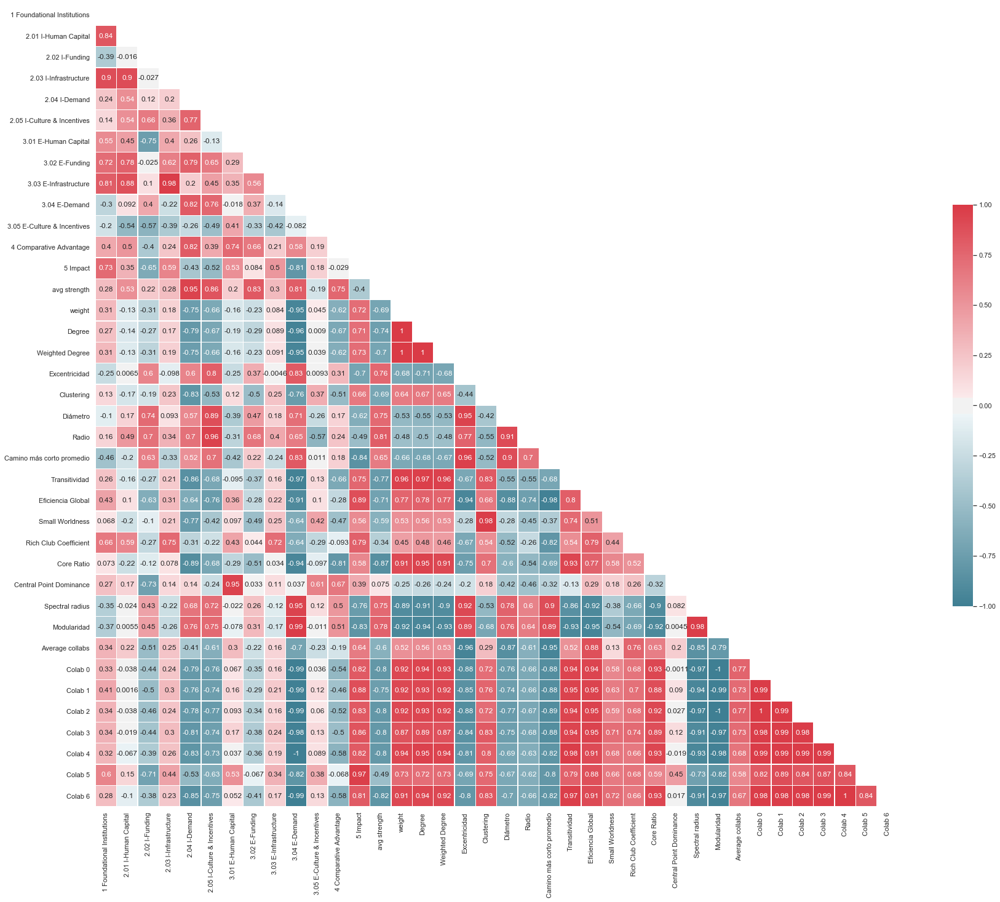

In [9]:
ieco_global_corr_df = ieco_grf_df.corr()
pd.set_option("display.max_rows", None, "display.max_columns", None)
#ieco_global_corr_df


import seaborn as sns
import matplotlib.pyplot as plt
sns.set(style="white")

# Generate a mask for the upper triangle
mask = np.triu(np.ones_like(ieco_global_corr_df, dtype=np.bool))

# Set up the matplotlib figure
f, ax = plt.subplots(figsize=(32, 24))

# Generate a custom diverging colormap
cmap = sns.diverging_palette(220, 10, as_cmap=True)

# Draw the heatmap with the mask and correct aspect ratio
sns.heatmap(ieco_global_corr_df, mask=mask, cmap=cmap, annot=True, vmin=-1, vmax=1, center=0,
            square=True, linewidths=.5, cbar_kws={"shrink": .5})

## Correlacion con métricas de colaboracion

In [10]:
import scipy.stats as stats
import math

In [11]:
ieco_grf_df

,1 Foundational Institutions,2.01 I-Human Capital,2.02 I-Funding,2.03 I-Infrastructure,2.04 I-Demand,2.05 I-Culture & Incentives,3.01 E-Human Capital,3.02 E-Funding,3.03 E-Infrastructure,3.04 E-Demand,3.05 E-Culture & Incentives,4 Comparative Advantage,5 Impact,avg strength,weight,Degree,Weighted Degree,Excentricidad,Clustering,Diámetro,Radio,Camino más corto promedio,Transitividad,Eficiencia Global,Small Worldness,Rich Club Coefficient,Core Ratio,Central Point Dominance,Spectral radius,Modularidad,Average collabs,Colab 0,Colab 1,Colab 2,Colab 3,Colab 4,Colab 5,Colab 6
México,3.522,2.278000,1.5600,3.3175,3.110000,2.515,3.115,2.300000,3.6275,3.430,2.970000,2.93,3.725455,3.477388,1.388629,3.658863,12.963211,5.622074,0.178788,7,4,3.820318,0.050000,0.289320,0.614973,0.361111,0.421405,0.202,1.910,0.623,12.33,6.936892,0.817118,-0.105809,0.252593,0.165183,0.917916,0.197206
Argentina,3.169,2.034667,1.7400,3.3100,2.716667,1.795,3.075,1.723333,3.7125,3.175,2.965000,2.58,3.781818,3.244633,1.481579,4.385965,14.017544,4.798246,0.300215,6,3,3.355669,0.107392,0.325773,1.006481,0.866667,0.495614,0.251,1.868,0.527,13.48,10.658128,0.921857,0.114574,0.355051,0.252040,0.937550,0.277219
Chile,3.913,2.580667,1.2025,3.6925,2.960000,1.955,4.155,2.206667,3.9975,3.205,3.455000,3.11,4.091818,3.417211,1.462564,3.948718,13.764103,5.041026,0.311157,6,3,3.227544,0.100744,0.338889,1.051860,1.000000,0.430769,0.525,1.890,0.535,13.04,10.185112,0.956748,0.103005,0.360724,0.247697,1.008863,0.271107
Brasil,3.177,1.828000,1.8400,3.2650,2.876667,2.755,2.975,1.991667,3.6775,3.460,3.438333,2.74,3.671818,3.430669,1.253704,3.370370,11.694444,6.726852,0.295414,8,4,4.324031,0.078571,0.266719,1.071208,0.222222,0.421296,0.237,1.983,0.682,10.38,5.505892,0.793642,-0.188052,0.262453,0.168783,0.923994,0.211309
España,3.929,2.992000,1.9500,3.9525,3.076667,3.830,3.190,2.423333,4.2925,3.365,2.626667,2.84,3.864545,3.518387,1.362343,3.790795,12.861925,6.079498,0.266684,8,5,3.783517,0.081917,0.294653,0.930159,1.000000,0.439331,0.184,1.920,0.606,12.13,7.693053,0.853905,-0.064943,0.297935,0.201023,0.937239,0.228465
Uruguay,3.780,2.171333,1.5025,3.6150,2.570000,1.245,3.045,2.005000,3.9050,2.740,3.143333,2.48,4.147576,3.227742,2.749495,7.747475,25.939394,4.479798,0.367266,6,3,3.081116,0.224523,0.360837,1.197588,1.000000,0.565657,0.179,1.778,0.356,13.40,16.300534,1.124532,0.452584,0.456651,0.387565,1.019704,0.373899


In [13]:
'''Colaboraciones Provenientes del Archivo Excel Original'''

colabs_excel=np.array([3.64,5.81,5.60,3.28,4.27,8.47])

r = stats.pearsonr(ieco_grf_df['5 Impact'], colabs_excel)
r

(0.8283433855298985, 0.04166997361181077)

In [14]:
def check_formula(i):
    print('Checking Formula '+str(i))
    print('---')
    print('Correlation with 5 Impact')
    print(stats.pearsonr(ieco_grf_df['5 Impact'], ieco_grf_df['Colab '+str(i)]))
    print('---')
    
check_formula(5)

Checking Formula 5
---
Correlation with 5 Impact
(0.9745574690342661, 0.0009627488130398026)
---


In [15]:
for i in range(7):
    check_formula(i)

Checking Formula 0
---
Correlation with 5 Impact
(0.8217335775778423, 0.044835819091399665)
---
Checking Formula 1
---
Correlation with 5 Impact
(0.8842692622908275, 0.019315379660523505)
---
Checking Formula 2
---
Correlation with 5 Impact
(0.8330122845320127, 0.03949912804299422)
---
Checking Formula 3
---
Correlation with 5 Impact
(0.8574888435348508, 0.02901698441749026)
---
Checking Formula 4
---
Correlation with 5 Impact
(0.8236624871226741, 0.043900777380540885)
---
Checking Formula 5
---
Correlation with 5 Impact
(0.9745574690342661, 0.0009627488130398026)
---
Checking Formula 6
---
Correlation with 5 Impact
(0.8130623004617381, 0.04915222055165892)
---


In [16]:
#------------------
# Exploración 1
#------------------

list1=list(df_means.keys())     #Pilares de iEcosystems
list2=list(grf_df.keys())      #Nombres de métricas globales

#list2.remove('Ciudad')
#list2.remove('País')

positive_pairs=[]
negative_pairs=[]

for key1 in list1:             #por cada métrica de iEco y global del grafo, revisamos si hay corr. significativa
    for key2 in list2:
        sig,corr=significant_corr(ieco_grf_df,ieco_grf_df,key1,key2)
        if sig==True:
            if corr>0:
                positive_pairs.append((key1,key2))                             #si correlación significativa y >0
            else:
                negative_pairs.append((key1,key2))                             #si correlación significativa y <=0

In [17]:
#El texto impreso es una lista de correlaciones significativas y positivas que encontramos (+)

for keys in positive_pairs:
    print('')
    print_significant_corr(ieco_grf_df,ieco_grf_df,keys[0],keys[1])
    print('')
    


Correlation between:  2.02 I-Funding   and   Diámetro
**********************************************
Pearson Correlation: 0.7385065695777545, p-value: 0.09362791589032411
*Statistically significant*
***********************************************


Correlation between:  2.03 I-Infrastructure   and   Rich Club Coefficient
**********************************************
Pearson Correlation: 0.748025442729602, p-value: 0.08723768559538712
*Statistically significant*
***********************************************


Correlation between:  2.04 I-Demand   and   avg strength
**********************************************
Pearson Correlation: 0.9521163141014181, p-value: 0.0033843760710865344
*Statistically significant*
***********************************************


Correlation between:  2.04 I-Demand   and   Modularidad
**********************************************
Pearson Correlation: 0.755879315982226, p-value: 0.08211818765090126
*Statistically significant*
****************************

In [18]:
#El texto impreso es una lista de correlaciones significativas y negativas que encontramos (-)

for keys in negative_pairs:
    print('')
    print_significant_corr(ieco_grf_df,ieco_grf_df,keys[0],keys[1])
    print('')
    


Correlation between:  2.04 I-Demand   and   weight
**********************************************
Pearson Correlation: -0.7513026741395321, p-value: 0.08508453028112797
*Statistically significant*
***********************************************


Correlation between:  2.04 I-Demand   and   Degree
**********************************************
Pearson Correlation: -0.7930354359599853, p-value: 0.059818901855709296
*Statistically significant*
***********************************************


Correlation between:  2.04 I-Demand   and   Weighted Degree
**********************************************
Pearson Correlation: -0.7540324234088823, p-value: 0.08330954791577455
*Statistically significant*
***********************************************


Correlation between:  2.04 I-Demand   and   Clustering
**********************************************
Pearson Correlation: -0.8256912250904797, p-value: 0.04292726391297861
*Statistically significant*
***********************************************

In [19]:
#------------------
# Exploración 2
#------------------

#lista: componentes de I-Demand
list1=['2.04a Government procurement of advanced technology (GCI)',
       '2.04b University-industry research collaborations (GII)',
       '2.04c Trade, Competition & Market scale (GII)',
       '3.04a Buyer sophistication (GCI 4.0)',
       '3.04b Domestic Market Scale (GII)']    

#lista: métricas globales
list2=list(grf_df.keys())

#list2.remove('Ciudad')   #removemos columnas con valores que no son numéricos
#list2.remove('País')

positive_pairs_2=[]
negative_pairs_2=[]

for key1 in list1:                     #por cada componente de IDemand, métrica global revisamos corr. significativa
    for key2 in list2:                 
        sig,corr = significant_corr(full_ieco_grf_df,full_ieco_grf_df,key1,key2)
        if sig == True:
            if corr > 0:
                positive_pairs_2.append((key1,key2))        #correlación significativa positiva
            else:
                negative_pairs_2.append((key1,key2))        #correlación significativa negativa

In [20]:
#El texto impreso es una lista de correlaciones significativas y positivas que encontramos (+)

for keys in positive_pairs_2:
    print('')
    print_significant_corr(full_ieco_grf_df,full_ieco_grf_df,keys[0],keys[1])
    print('')
    


Correlation between:  2.04b University-industry research collaborations (GII)   and   avg strength
**********************************************
Pearson Correlation: 0.9057240787070973, p-value: 0.012912964197428016
*Statistically significant*
***********************************************


Correlation between:  2.04b University-industry research collaborations (GII)   and   Spectral radius
**********************************************
Pearson Correlation: 0.7928267560324674, p-value: 0.059935113706115976
*Statistically significant*
***********************************************


Correlation between:  2.04b University-industry research collaborations (GII)   and   Modularidad
**********************************************
Pearson Correlation: 0.8099183951390236, p-value: 0.050762603958377235
*Statistically significant*
***********************************************


Correlation between:  2.04c Trade, Competition & Market scale (GII)   and   avg strength
***********************

In [21]:
#El texto impreso es una lista de correlaciones significativas y negativas que encontramos (-)

for keys in negative_pairs_2:
    print('')
    print_significant_corr(full_ieco_grf_df,full_ieco_grf_df,keys[0],keys[1])
    print('')
    


Correlation between:  2.04a Government procurement of advanced technology (GCI)   and   Small Worldness
**********************************************
Pearson Correlation: -0.7750535984064972, p-value: 0.07021008204430217
*Statistically significant*
***********************************************


Correlation between:  2.04b University-industry research collaborations (GII)   and   weight
**********************************************
Pearson Correlation: -0.8026827654539166, p-value: 0.05455995298570256
*Statistically significant*
***********************************************


Correlation between:  2.04b University-industry research collaborations (GII)   and   Degree
**********************************************
Pearson Correlation: -0.8537047923796843, p-value: 0.03053790559238056
*Statistically significant*
***********************************************


Correlation between:  2.04b University-industry research collaborations (GII)   and   Weighted Degree
*******************

In [22]:
#------------------
# Exploración 3
#------------------

list1=list(full_ieco_df.keys())[-9:]                #lista de componentes del indicador Impacto
list2=list(grf_df.keys())                           #lista de métricas globales

positive_pairs_3=[]
negative_pairs_3=[]

for key1 in list1:                                  #revisamos en cada pareja si hay corr. significativa + o -
    for key2 in list2:
        sig,corr=significant_corr(full_ieco_grf_df,full_ieco_grf_df,key1,key2)
        if sig==True:
            if corr>0:
                positive_pairs_3.append((key1,key2))
            else:
                negative_pairs_3.append((key1,key2))

In [23]:
#El texto impreso es una lista de correlaciones significativas y positivas que encontramos (+)

for keys in positive_pairs_3:
    print('')
    print_significant_corr(full_ieco_grf_df,full_ieco_grf_df,keys[0],keys[1])
    print('')
    


Correlation between:  5.03 Inclusive Development Index   and   Eficiencia Global
**********************************************
Pearson Correlation: 0.7507052737497485, p-value: 0.08547522386457787
*Statistically significant*
***********************************************


Correlation between:  5.03 Inclusive Development Index   and   Rich Club Coefficient
**********************************************
Pearson Correlation: 0.8924503353388182, p-value: 0.016728385811940756
*Statistically significant*
***********************************************


Correlation between:  5.03 Inclusive Development Index   and   Colab 5
**********************************************
Pearson Correlation: 0.7764984787264775, p-value: 0.06934711709253942
*Statistically significant*
***********************************************


Correlation between:  5.04 Population below international poverty line (SDG 1 - No poverty)   and   Eficiencia Global
**********************************************
Pearson Cor

In [24]:
#El texto impreso es una lista de correlaciones significativas y negativas que encontramos (-)

for keys in positive_pairs_3:
    print('')
    print_significant_corr(full_ieco_grf_df,full_ieco_grf_df,keys[0],keys[1])
    print('')


Correlation between:  5.03 Inclusive Development Index   and   Eficiencia Global
**********************************************
Pearson Correlation: 0.7507052737497485, p-value: 0.08547522386457787
*Statistically significant*
***********************************************


Correlation between:  5.03 Inclusive Development Index   and   Rich Club Coefficient
**********************************************
Pearson Correlation: 0.8924503353388182, p-value: 0.016728385811940756
*Statistically significant*
***********************************************


Correlation between:  5.03 Inclusive Development Index   and   Colab 5
**********************************************
Pearson Correlation: 0.7764984787264775, p-value: 0.06934711709253942
*Statistically significant*
***********************************************


Correlation between:  5.04 Population below international poverty line (SDG 1 - No poverty)   and   Eficiencia Global
**********************************************
Pearson Cor

In [25]:
from sklearn.linear_model import LinearRegression
from scipy import stats
import matplotlib.pyplot as plt
from mpl_toolkits import mplot3d



def lin_reg_p_val(reg,X,y):
    '''
    Esta función busca el p-value entre
    
    - X : np.array
    - y : vector de datos
    
    Es decir, mide la correlación entre un conjunto de puntos X 
    determinado por una pareja de variables y un cnjunto de valores y.
    
    Inputs : specified above
    Output : p-value(X,y)
    '''
    
    # predice el np.array X usando modelo lineal, y suma las distancias al cuadrado de esa predicción hacia y
    # luego divide entre  (X.shape[0] - X.shape[1])= (no.columnas, no.filas)
    sse = np.sum((reg.predict(X) - y) ** 2, axis=0) / float(X.shape[0] - X.shape[1])
    
    if isinstance(sse, float):  
        
        # si sse es un valor decimal, entonces forma se, una matriz (np.array) que al cuadrado
        # es igual a diag( sse * (X^T * X)^-1 ) 
        
        se = np.array([np.sqrt(np.diagonal(sse * np.linalg.inv(np.dot(X.T, X))))])  
        
    else: 
        # si sse no es un valor decimal sino un np.array, entonces se forma se, una lista tal que
        # por cada columna i, el valor se[i]^2 = diag( sse[i] * (X^T * X)^-1 ) 
        
        se = np.array([np.sqrt(np.diagonal(sse[i] * np.linalg.inv(np.dot(X.T, X)))) for i in range(sse.shape[0])])
    
    # con estos dos últimas líneas, obtiene el p-value entre 
    # el conjunto de valores X y el conjunto de valores y
    t = reg.coef_ / se
    p = 2 * (1 - stats.t.cdf(np.abs(t), y.shape[0] - X.shape[1]))
    return p

def plot_linear_model(reg,X,y,key1,key2,predict):
    '''
    This function plots the linear modeling of a vector of variables y in terms of 
    a set of points X, determined by 2 data vectors. 
    
    Inputs:
    - reg :     regression model 
    - X :       a set of points representing some data vectors.
    - y :       data which is to be predicted from the other data vectors
    - key1 :    sring for axis label -> predicting data
    - key2 :    sring for axis label -> predicting data
    - predict : string for axis label -> predicted data
    
    Outputs: 
    None, and a ~very nice~ 3D plot showing how good 
    data collection X might be in predicting linearly data vector y.
    '''
    
    ax = plt.axes(projection='3d')      #we are about to do a 3D projection
    plt.tight_layout()
    
    a = np.linspace(1, 5, 30)         
    b = np.linspace(1, 5, 30)
    
    A,B = np.meshgrid(a,b)              #we form a grid based on a (30 equidistant values from 1 to 5) and b (x2)
    C = A*reg.coef_[0] + B*reg.coef_[1] + reg.intercept_   # plane which depicts the linear approximation of y by X
    
    
    ax.scatter3D(X[:,0], X[:,1], y, cmap='Greens')         # we scatter X information in Green
    ax.contour3D(A, B, C, 50, cmap='binary')               # we plot the 3D contour of the linear approximation
    
    
    ax.set_title('Linear Model')                           # Title of plot
    ax.set_xlabel(key1, fontsize=9)                                    # Coordinates labeling
    ax.set_ylabel(key2, fontsize=9)
    ax.set_zlabel(predict, fontsize=9)
    plt.xlim((1,5))
    plt.ylim((1,5))
    plt.show()                                             #pull down the curtains!

In [26]:
''' 
4d linear model
Has too many responses and is likely not useful. 
Didn't try higher dimensions because it was likely to happen the same (any n+1 points are in an n-plane)
'''

ieco_key_list=list(df_means.keys())
ieco_key_list.remove('4 Comparative Advantage')
ieco_key_list.remove('5 Impact')                        #list of ieco pilars without 4: C.Advantage ,5: Impact


ieco_key_predictors=['4 Comparative Advantage','5 Impact']     #ieco data we want to use to predict


grf_key_list=list(grf_df.keys())                        #list of graph global metrics 


for key1 in ieco_key_list:     
    for key2 in ieco_key_list:
        if key1 != key2:
            for key3 in ieco_key_list:
                if key3 !=key1 and key3 !=key2:         # for every (a,b,c) different ieco metrics
                    
                    for predict in ieco_key_predictors: 
                        #X=np.concatenate([ieco_df[key1].to_numpy(),ieco_df[key2].to_numpy(),ieco_df[key3].to_numpy()],axis=0)
                        X = np.concatenate([df_means[key1].to_numpy(),df_means[key2].to_numpy(),df_means[key3].to_numpy()],axis=0)
                        X = X.reshape(6,3)
                        y = df_means[predict].to_numpy()
                        reg = LinearRegression().fit(X,y)
                        p = lin_reg_p_val(reg,X,y)
                        if p[0][0]<.05 and p[0][1]<.05 and p[0][2]<.05 and reg.score(X,y)>.9:
                            print('- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -')
                            print('Predictor metrics: '+key1+', '+key2+', '+key3)
                            print('Predicted: '+predict)
                            print('- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -')
                            print('Regression Score: ' + str(reg.score(X,y)) + ', p-value: ' + str(p) )
                            print('Regression Coefficients: ' + str(reg.coef_) )
                            print('')
                            print('')
                            print('')


 0.00016575]]
Regression Coefficients: [-0.52778975 -0.4865767   0.89001005]



- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: 3.03 E-Infrastructure, 1 Foundational Institutions, 2.03 I-Infrastructure
Predicted: 4 Comparative Advantage
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.9981170470235544, p-value: [[5.30924328e-03 6.41899550e-05 8.60771104e-05]]
Regression Coefficients: [-0.33904873 -0.41887699  1.25263435]



- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: 3.03 E-Infrastructure, 1 Foundational Institutions, 2.04 I-Demand
Predicted: 4 Comparative Advantage
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.9977103145863623, p-value: [[1.33857873e-02 6.98400087e-05 1.03383633e-04]]
Regres

- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: 1 Foundational Institutions, 2.02 I-Funding
Predicted: 4 Comparative Advantage
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8760073249285922, p-value: [[0.01343502 0.00319696]]
Regression Coefficients: [-0.36795922  0.59844681]
Intercept: 2.2490030178275653


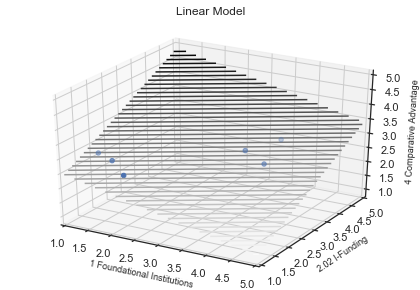




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: 1 Foundational Institutions, 2.03 I-Infrastructure
Predicted: 5 Impact
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.9139862312690793, p-value: [[0.03349723 0.01549506]]
Regression Coefficients: [0.35031177 0.48979652]
Intercept: 0.9185147438160226


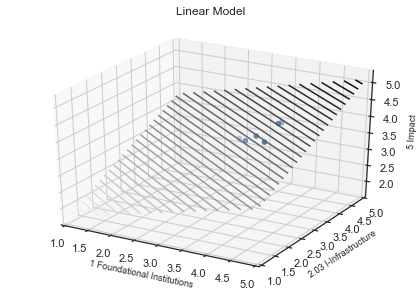




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: 1 Foundational Institutions, 2.04 I-Demand
Predicted: 4 Comparative Advantage
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.9034882009953756, p-value: [[0.014796   0.00461447]]
Regression Coefficients: [-0.57197353  0.89280334]
Intercept: 2.013796759131127


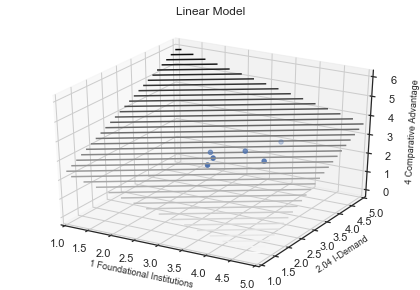




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: 2.01 I-Human Capital, 2.05 I-Culture & Incentives
Predicted: 5 Impact
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.980252677890458, p-value: [[1.55341601e-06 9.40265010e-06]]
Regression Coefficients: [0.49365104 0.42840728]
Intercept: 1.7071012024745293


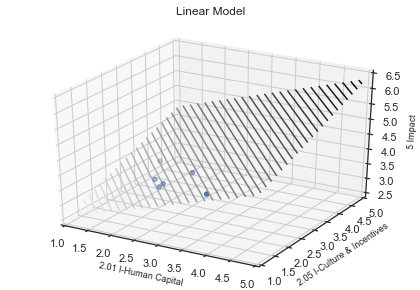




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: 2.02 I-Funding, 1 Foundational Institutions
Predicted: 4 Comparative Advantage
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.948857421438137, p-value: [[0.00217455 0.00049082]]
Regression Coefficients: [ 0.39246891 -0.6292434 ]
Intercept: 3.323386968946955


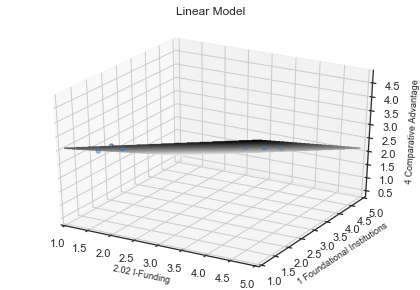




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: 2.02 I-Funding, 3.05 E-Culture & Incentives
Predicted: 4 Comparative Advantage
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.9056789557898628, p-value: [[0.00591942 0.0025001 ]]
Regression Coefficients: [ 0.48471683 -0.58255815]
Intercept: 3.08843616373164


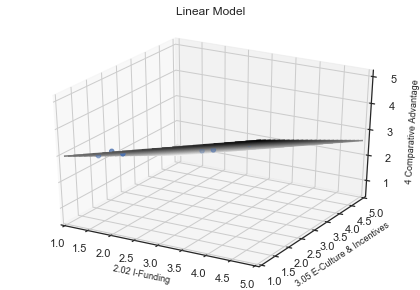




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: 2.03 I-Infrastructure, 1 Foundational Institutions
Predicted: 5 Impact
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.9850299287956432, p-value: [[0.00153017 0.00050946]]
Regression Coefficients: [0.35376756 0.51767005]
Intercept: 0.81127568705296


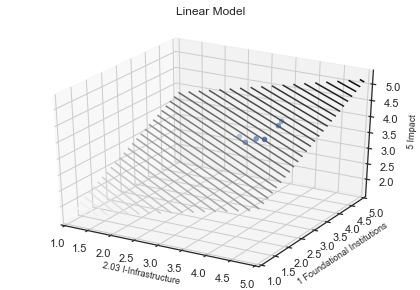




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: 2.04 I-Demand, 1 Foundational Institutions
Predicted: 4 Comparative Advantage
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8743609182517296, p-value: [[0.03125506 0.00856859]]
Regression Coefficients: [ 0.51736144 -0.85666311]
Intercept: 3.622728188256655


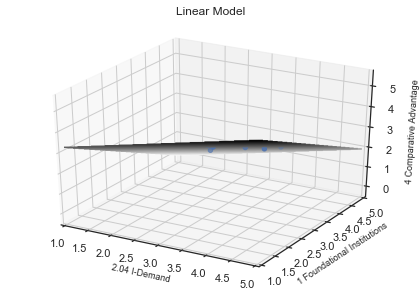




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: 2.04 I-Demand, 3.05 E-Culture & Incentives
Predicted: 4 Comparative Advantage
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.800708654499858, p-value: [[0.00938844 0.02634648]]
Regression Coefficients: [ 0.66293062 -0.49883773]
Intercept: 2.2416973198744246


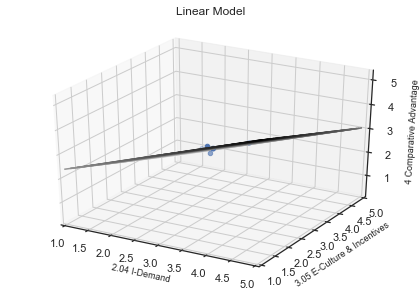




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: 2.05 I-Culture & Incentives, 1 Foundational Institutions
Predicted: 4 Comparative Advantage
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8768570972508145, p-value: [[0.03003925 0.00433588]]
Regression Coefficients: [ 0.10780147 -0.22947497]
Intercept: 3.035610495544171


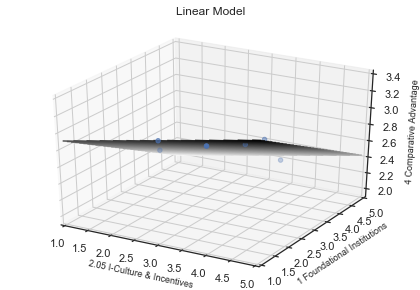




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: 2.05 I-Culture & Incentives, 2.01 I-Human Capital
Predicted: 4 Comparative Advantage
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8044104098362947, p-value: [[0.02019329 0.00055172]]
Regression Coefficients: [-0.15378054 -0.56369693]
Intercept: 4.305271534557415


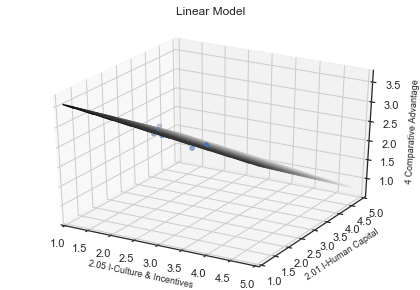




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: 2.05 I-Culture & Incentives, 2.01 I-Human Capital
Predicted: 5 Impact
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.9127130214523018, p-value: [[3.88975376e-05 3.36681854e-04]]
Regression Coefficients: [0.4623821  0.36434467]
Intercept: 1.9175696722615059


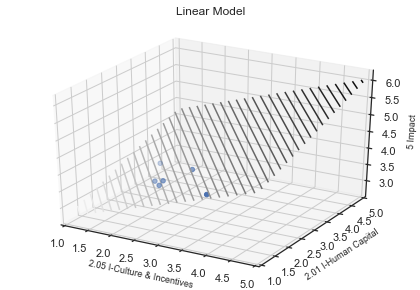




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: 2.05 I-Culture & Incentives, 3.01 E-Human Capital
Predicted: 4 Comparative Advantage
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8155081056707557, p-value: [[0.04675269 0.00810444]]
Regression Coefficients: [ 0.10982991 -0.23531627]
Intercept: 3.0205750153785753


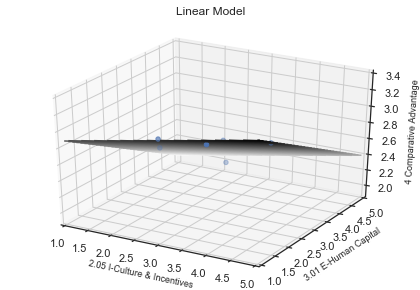




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: 2.05 I-Culture & Incentives, 3.05 E-Culture & Incentives
Predicted: 4 Comparative Advantage
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8251521409438132, p-value: [[0.00789088 0.01847637]]
Regression Coefficients: [ 0.18693825 -0.16117876]
Intercept: 2.6515101178314864


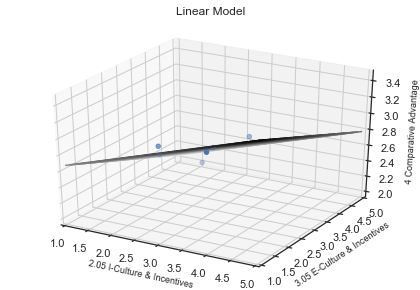




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: 3.01 E-Human Capital, 2.02 I-Funding
Predicted: 4 Comparative Advantage
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8811180405504192, p-value: [[0.00933919 0.00140927]]
Regression Coefficients: [-0.31499457  0.58705617]
Intercept: 2.189377714659


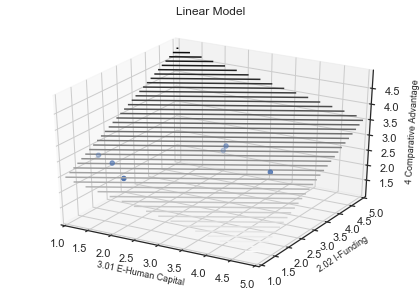




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: 3.01 E-Human Capital, 2.03 I-Infrastructure
Predicted: 4 Comparative Advantage
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8098278471485052, p-value: [[0.02516929 0.04466569]]
Regression Coefficients: [-0.3951867  -0.36480113]
Intercept: 5.363512809571261


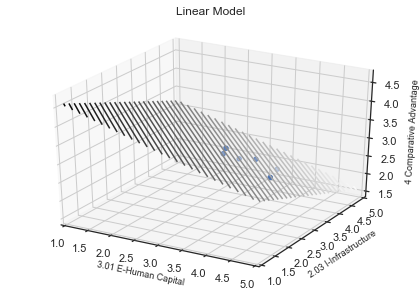




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: 3.01 E-Human Capital, 2.04 I-Demand
Predicted: 4 Comparative Advantage
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8599935971542845, p-value: [[0.03188059 0.00079607]]
Regression Coefficients: [-0.32271692  1.0419281 ]
Intercept: 0.8375767719990788


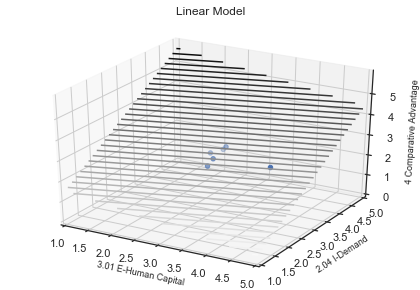




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: 3.04 E-Demand, 3.05 E-Culture & Incentives
Predicted: 4 Comparative Advantage
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.9780817243706411, p-value: [[0.0001491  0.00025507]]
Regression Coefficients: [ 0.60482598 -0.53169816]
Intercept: 2.536278713800601


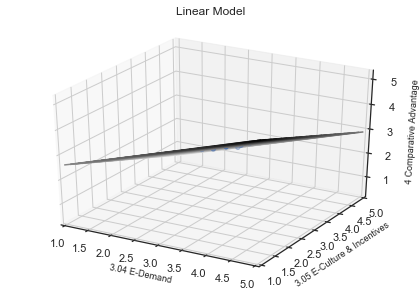

In [27]:
'''
3D linear model for predicting impact and comparative advantage from iEcosystem metrics
'''

for key1 in ieco_key_list:                         # for each pair (a,b) of distinct ieco metrics
    for key2 in ieco_key_list:
        if key1 != key2:
            for predict in ieco_key_predictors:    #or each predictor from Impact and C. Advantage
                
                #we make a numpy array from the predicted values and reshape it into 2 rows, 6 columns
                #X=np.concatenate([ieco_df[key1].to_numpy(),ieco_df[key2].to_numpy()],axis=0)
                X=np.concatenate([df_means[key1].to_numpy(),df_means[key2].to_numpy()],axis=0)
                X=X.reshape(6,2)
                
                #make a numpy array of predictor
                y=df_means[predict].to_numpy()
                
                #make a Linear regression and obtains p-value using previously defined function
                reg=LinearRegression().fit(X,y)
                p=lin_reg_p_val(reg,X,y)
                
                #if both p-values are small enough and the linear regression score is greater than 0.8
                if p[0][0]<.05 and p[0][1]<.05 and reg.score(X,y)>.8:
                    print('- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -')
                    print('Predictor metrics: '+key1+', '+key2)
                    print('Predicted: '+predict)
                    print('- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -')
                    print('Regression Score: ' + str(reg.score(X,y)) + ', p-value: ' + str(p) )
                    print('Regression Coefficients: ' + str(reg.coef_) )
                    print('Intercept: ' + str(reg.intercept_))
                    plot_linear_model(reg,X,y,key1,key2,predict)
                    print('')
                    print('')
                    print('')

- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: avg strength, Clustering
Predicted: 4 Comparative Advantage
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.827526312284531, p-value: [[0.01136943 0.01166019]]
Regression Coefficients: [ 1.59868448 -1.66482413]
Intercept: 2.8188649693195904


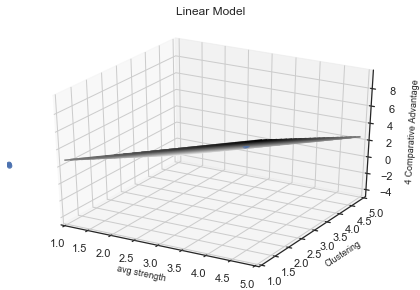




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: avg strength, Transitividad
Predicted: 4 Comparative Advantage
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.9614385297472104, p-value: [[0.00060939 0.00063759]]
Regression Coefficients: [ 1.71486568 -1.78025141]
Intercept: 2.7974706641864664


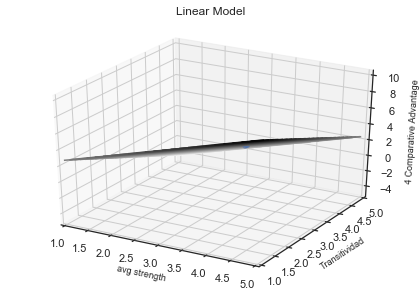




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: avg strength, Eficiencia Global
Predicted: 4 Comparative Advantage
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.9026624487127013, p-value: [[0.00509078 0.00558599]]
Regression Coefficients: [ 1.70507095 -1.74548288]
Intercept: 2.716864470593455


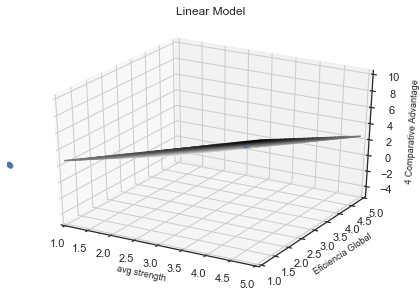




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: avg strength, Core Ratio
Predicted: 4 Comparative Advantage
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.9287059659381748, p-value: [[0.00171129 0.00172726]]
Regression Coefficients: [ 1.72520365 -1.80251961]
Intercept: 2.8350262369747496


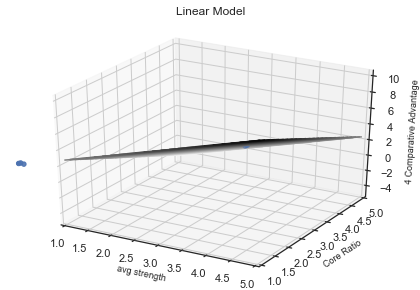




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: avg strength, Colab 1
Predicted: 4 Comparative Advantage
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8563552998033903, p-value: [[0.00835917 0.00873216]]
Regression Coefficients: [ 1.07045379 -1.10103946]
Intercept: 2.791850319863153


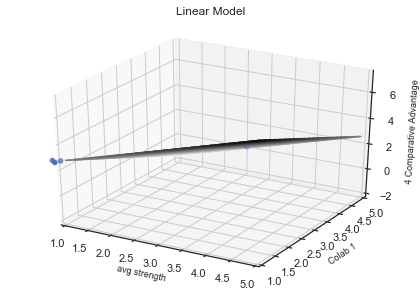




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: avg strength, Colab 3
Predicted: 4 Comparative Advantage
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8947148724331324, p-value: [[0.0048842 0.0051811]]
Regression Coefficients: [ 1.42097633 -1.4662419 ]
Intercept: 2.7806255885035553


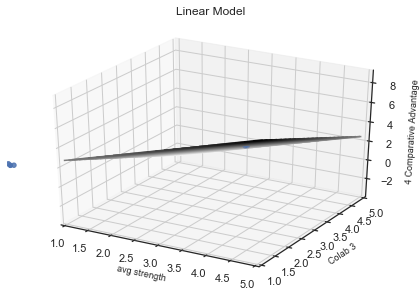




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: avg strength, Colab 4
Predicted: 4 Comparative Advantage
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.9381229329495778, p-value: [[0.00156969 0.00164984]]
Regression Coefficients: [ 1.46149827 -1.51329176]
Intercept: 2.7956236092308653


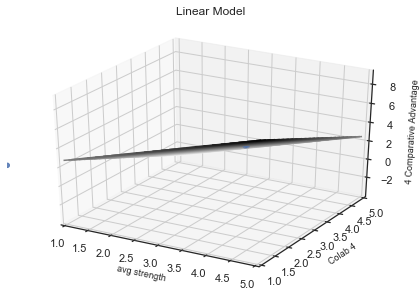




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: avg strength, Colab 5
Predicted: 4 Comparative Advantage
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.9425108906942034, p-value: [[0.00151578 0.00162162]]
Regression Coefficients: [ 1.70030272 -1.74842902]
Intercept: 2.7429168618958135


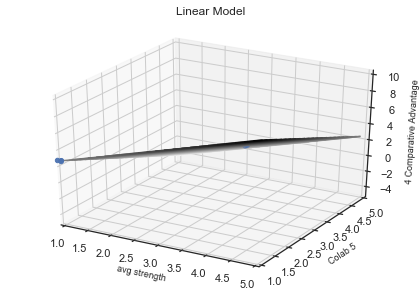




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: avg strength, Colab 6
Predicted: 4 Comparative Advantage
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.9367037877692601, p-value: [[0.0016764  0.00175973]]
Regression Coefficients: [ 1.59293354 -1.65023807]
Intercept: 2.791412355084774


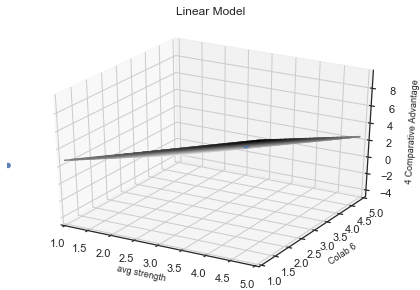




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Degree, Excentricidad
Predicted: 4 Comparative Advantage
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.841055924832187, p-value: [[0.00850402 0.01199147]]
Regression Coefficients: [-0.12098679  0.09597323]
Intercept: 2.8434489796725555


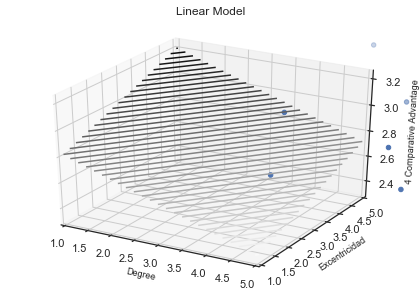




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Degree, Diámetro
Predicted: 4 Comparative Advantage
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8281082231556877, p-value: [[0.01177666 0.01327447]]
Regression Coefficients: [-0.10117666  0.08999311]
Intercept: 2.7938101652270806


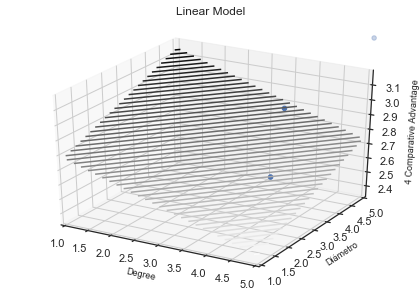




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Degree, Radio
Predicted: 4 Comparative Advantage
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8724478919668119, p-value: [[0.00286157 0.00891462]]
Regression Coefficients: [-0.14698324  0.09288313]
Intercept: 2.9583825752589235


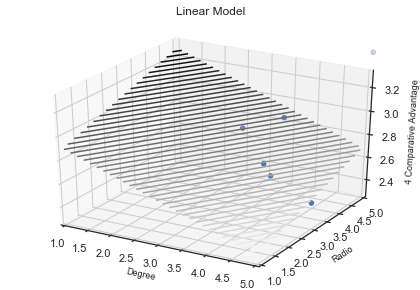




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Degree, Camino más corto promedio
Predicted: 4 Comparative Advantage
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8064469147538644, p-value: [[0.00403901 0.01648631]]
Regression Coefficients: [-0.21210741  0.11321349]
Intercept: 3.0702643031244627


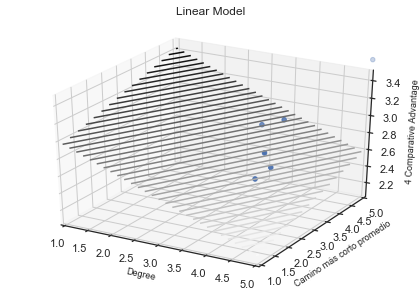




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Excentricidad, weight
Predicted: 4 Comparative Advantage
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.9726210357735132, p-value: [[0.00027898 0.00042031]]
Regression Coefficients: [ 0.18191949 -0.16396279]
Intercept: 2.731862946983533


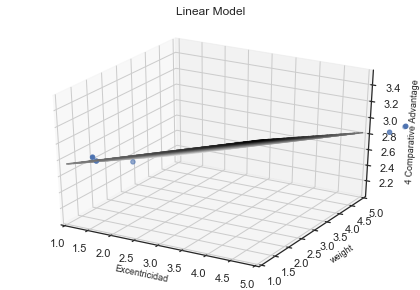




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Excentricidad, Degree
Predicted: 4 Comparative Advantage
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.9229978990570614, p-value: [[0.00166053 0.00305406]]
Regression Coefficients: [ 0.13157882 -0.09794676]
Intercept: 2.677236580092271


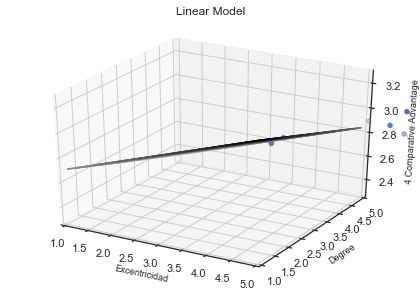




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Excentricidad, Colab 1
Predicted: 4 Comparative Advantage
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8154666286880513, p-value: [[0.01388056 0.02639989]]
Regression Coefficients: [ 0.18650564 -0.15748416]
Intercept: 2.6725157570227656


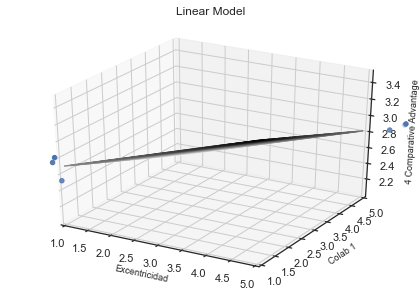




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Excentricidad, Colab 2
Predicted: 4 Comparative Advantage
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8705582998987479, p-value: [[0.00708053 0.01209089]]
Regression Coefficients: [ 0.18539432 -0.16378896]
Intercept: 2.7120160412529435


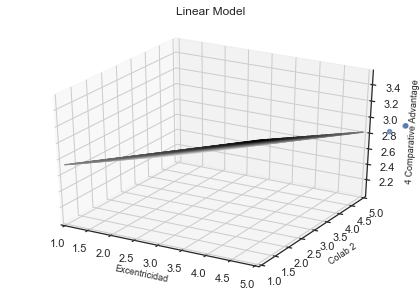




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Diámetro, weight
Predicted: 4 Comparative Advantage
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.9520524766700111, p-value: [[0.00091512 0.00146712]]
Regression Coefficients: [ 0.15048909 -0.13636365]
Intercept: 2.7268059039988097


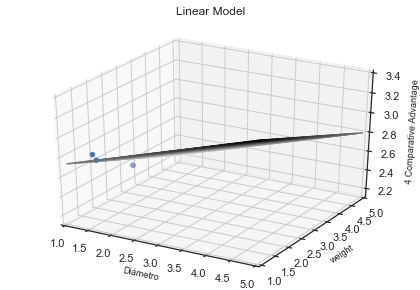




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Diámetro, Degree
Predicted: 4 Comparative Advantage
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.959550758273839, p-value: [[0.00059228 0.00076782]]
Regression Coefficients: [ 0.11027825 -0.09498991]
Intercept: 2.746611292144119


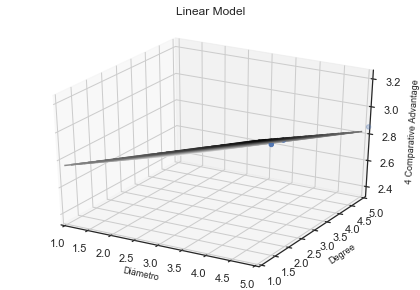




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Diámetro, Colab 1
Predicted: 4 Comparative Advantage
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8033738454466451, p-value: [[0.01757357 0.03363838]]
Regression Coefficients: [ 0.1480062  -0.12597198]
Intercept: 2.67669123211822


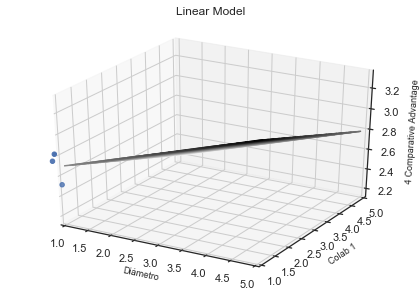




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Diámetro, Colab 2
Predicted: 4 Comparative Advantage
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8517232767825912, p-value: [[0.01006065 0.01774782]]
Regression Coefficients: [ 0.1491818  -0.13192004]
Intercept: 2.7076169224909594


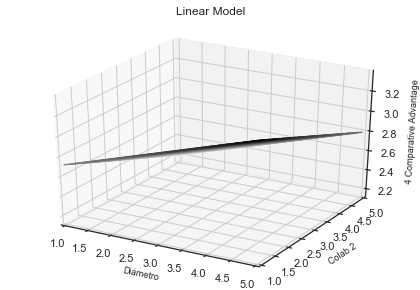




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Radio, weight
Predicted: 4 Comparative Advantage
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.9922748170629221, p-value: [[2.27146340e-05 2.66830478e-05]]
Regression Coefficients: [ 0.18198355 -0.19411145]
Intercept: 2.789195967659111


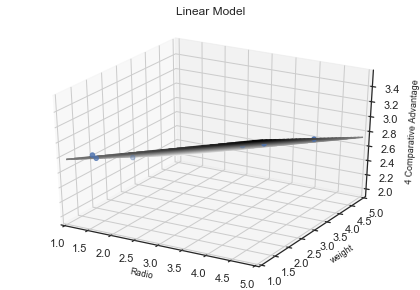




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Radio, Degree
Predicted: 4 Comparative Advantage
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.9909702156131893, p-value: [[3.17041709e-06 1.11781511e-04]]
Regression Coefficients: [ 0.22229227 -0.07847981]
Intercept: 2.2467093213400577


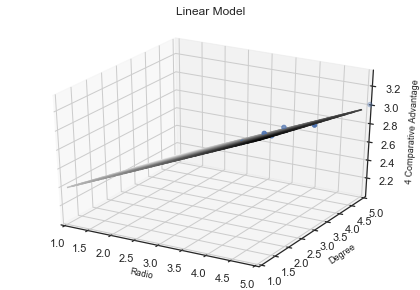




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Radio, Colab 1
Predicted: 4 Comparative Advantage
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8287454851646636, p-value: [[0.01266989 0.0290955 ]]
Regression Coefficients: [ 0.19573686 -0.18098755]
Intercept: 2.6901153422017


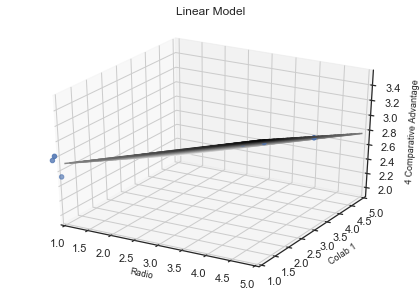




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Radio, Colab 2
Predicted: 4 Comparative Advantage
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8897091645748356, p-value: [[0.00530913 0.01150802]]
Regression Coefficients: [ 0.19667397 -0.19083365]
Intercept: 2.7189865482124005


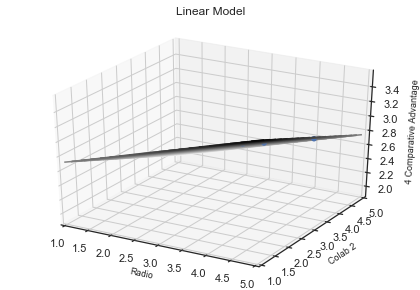




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Camino más corto promedio, weight
Predicted: 4 Comparative Advantage
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.9654120880911189, p-value: [[0.00043602 0.00060519]]
Regression Coefficients: [ 0.2759129  -0.23934217]
Intercept: 2.736194895239015


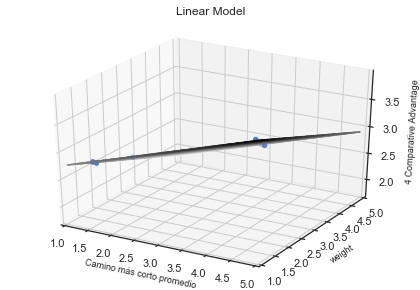




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Camino más corto promedio, Degree
Predicted: 4 Comparative Advantage
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8221355557358668, p-value: [[0.00046843 0.01828707]]
Regression Coefficients: [ 0.35903365 -0.10517442]
Intercept: 1.9101894380377995


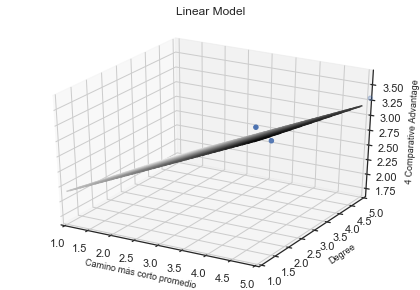




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Camino más corto promedio, Colab 1
Predicted: 4 Comparative Advantage
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8388450285030838, p-value: [[0.01067348 0.01968626]]
Regression Coefficients: [ 0.33252452 -0.27527658]
Intercept: 2.658082890160734


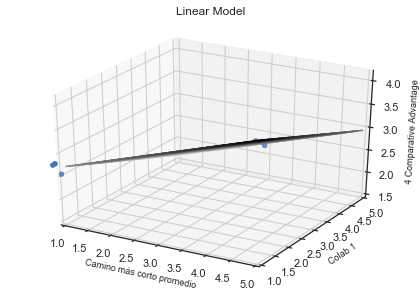




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Camino más corto promedio, Colab 2
Predicted: 4 Comparative Advantage
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.9052420433454491, p-value: [[0.00386263 0.00596447]]
Regression Coefficients: [ 0.31706556 -0.2800279 ]
Intercept: 2.731118698127771


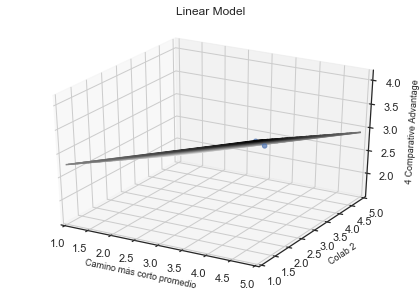




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Transitividad, Spectral radius
Predicted: 4 Comparative Advantage
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8487565760723835, p-value: [[0.00914135 0.0095915 ]]
Regression Coefficients: [-2.0495795   2.04740956]
Intercept: 2.752524684564583


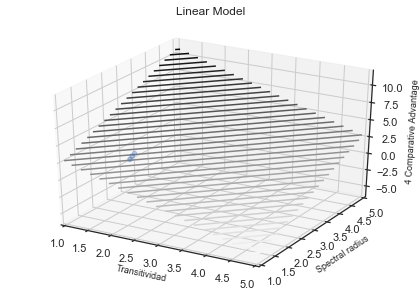




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Eficiencia Global, Spectral radius
Predicted: 4 Comparative Advantage
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8264137339316606, p-value: [[0.01646643 0.01906746]]
Regression Coefficients: [-2.13945461  2.07446111]
Intercept: 2.8728863553668056


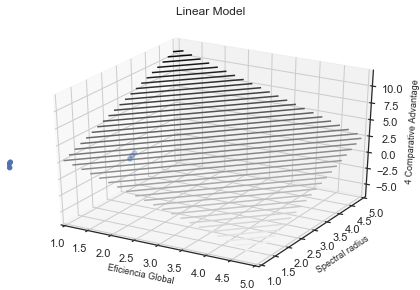




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Rich Club Coefficient, Modularidad
Predicted: 4 Comparative Advantage
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.9514345894766952, p-value: [[0.03551566 0.00028079]]
Regression Coefficients: [0.18362026 0.76659436]
Intercept: 2.1869159040280577


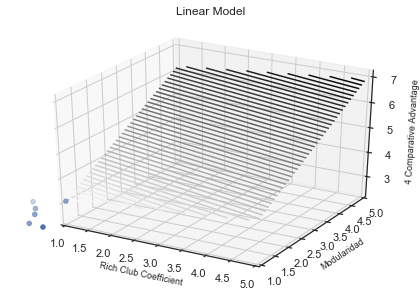




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Core Ratio, Spectral radius
Predicted: 4 Comparative Advantage
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8135379493050547, p-value: [[0.01269386 0.01277257]]
Regression Coefficients: [-2.10031001  2.10910577]
Intercept: 2.7345476986196826


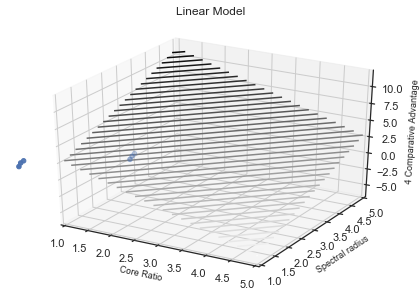




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Central Point Dominance, Clustering
Predicted: 4 Comparative Advantage
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8720450298079424, p-value: [[0.02320182 0.00084499]]
Regression Coefficients: [-0.99557023 -2.72715589]
Intercept: 3.79753680315299


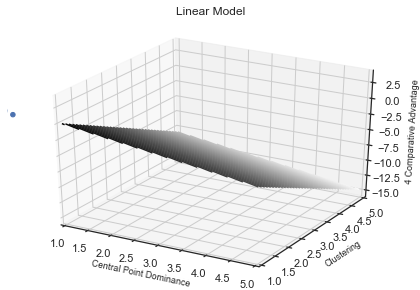




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Central Point Dominance, Eficiencia Global
Predicted: 4 Comparative Advantage
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.908472578510978, p-value: [[0.01190957 0.00125327]]
Regression Coefficients: [-1.12240246 -2.45045439]
Intercept: 3.784812226653128


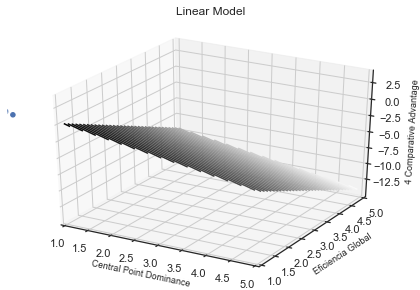




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Central Point Dominance, Spectral radius
Predicted: 4 Comparative Advantage
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8542644369416149, p-value: [[0.00887062 0.01446043]]
Regression Coefficients: [-1.40275378  1.24584577]
Intercept: 3.022969224509655


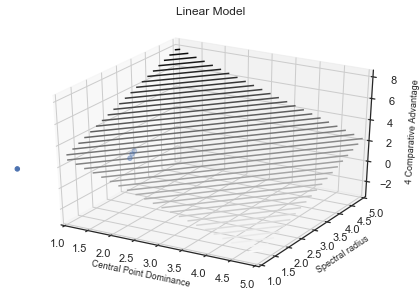




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Central Point Dominance, Colab 3
Predicted: 4 Comparative Advantage
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.9657438230298359, p-value: [[0.00094097 0.00024761]]
Regression Coefficients: [-1.1616834  -1.75084449]
Intercept: 3.6408952430149153


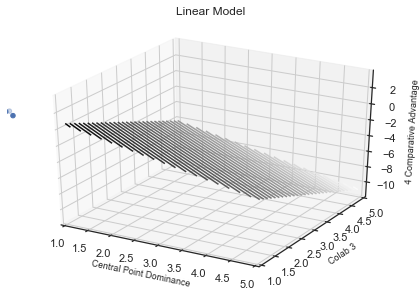




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Central Point Dominance, Colab 6
Predicted: 4 Comparative Advantage
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.9548150796463724, p-value: [[3.01486824e-03 8.57885755e-05]]
Regression Coefficients: [-1.03376282 -2.90416187]
Intercept: 3.79729408255808


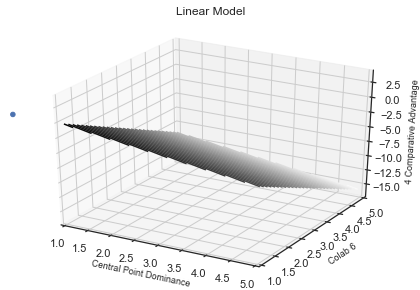




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Spectral radius, Clustering
Predicted: 4 Comparative Advantage
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8169773983430961, p-value: [[0.01156965 0.011646  ]]
Regression Coefficients: [ 2.07601814 -2.09202552]
Intercept: 2.83746937583131


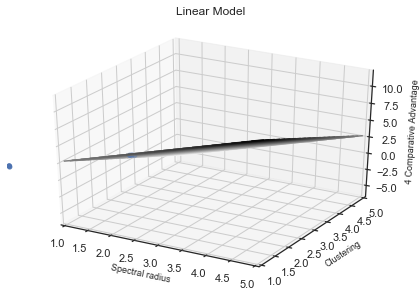




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Spectral radius, Transitividad
Predicted: 4 Comparative Advantage
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.9811364807385646, p-value: [[0.00012663 0.00013114]]
Regression Coefficients: [ 2.24307609 -2.2517247 ]
Intercept: 2.8211651634560453


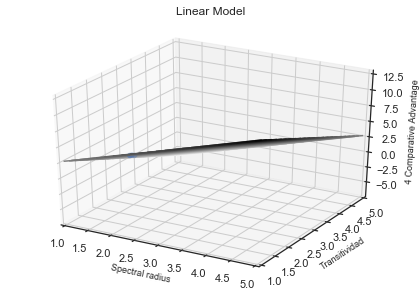




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Spectral radius, Eficiencia Global
Predicted: 4 Comparative Advantage
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.9183428260073744, p-value: [[0.00343735 0.0039832 ]]
Regression Coefficients: [ 2.28940478 -2.22959398]
Intercept: 2.691286503544358


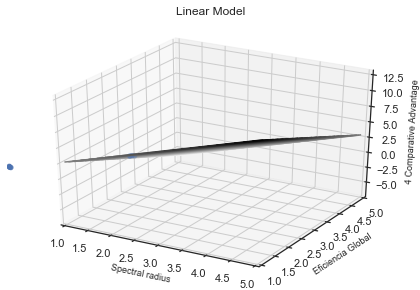




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Spectral radius, Core Ratio
Predicted: 4 Comparative Advantage
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.9571068320668321, p-value: [[0.00058973 0.00058097]]
Regression Coefficients: [ 2.31630753 -2.33927   ]
Intercept: 2.8458457436856417


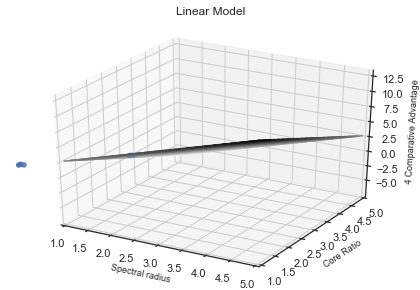




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Spectral radius, Colab 3
Predicted: 4 Comparative Advantage
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8451797458695894, p-value: [[0.01062822 0.01160011]]
Regression Coefficients: [ 1.67175803 -1.64473251]
Intercept: 2.769841051729739


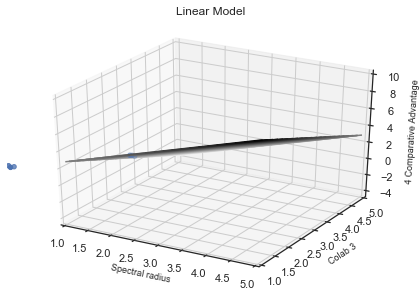




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Spectral radius, Colab 4
Predicted: 4 Comparative Advantage
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8979286533768697, p-value: [[0.0041764  0.00444101]]
Regression Coefficients: [ 1.72871289 -1.71628465]
Intercept: 2.796481515630202


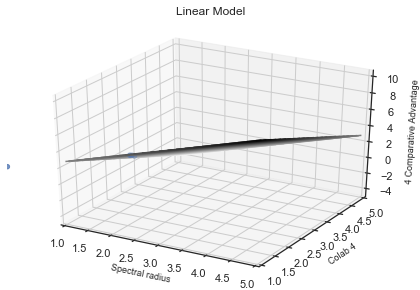




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Spectral radius, Colab 5
Predicted: 4 Comparative Advantage
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.9506731608418211, p-value: [[0.00113869 0.00143289]]
Regression Coefficients: [ 2.27906125 -2.16869813]
Intercept: 2.5954426285606265


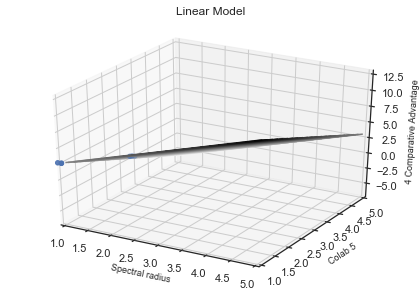




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Spectral radius, Colab 6
Predicted: 4 Comparative Advantage
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.9223679479826524, p-value: [[0.00241514 0.00255452]]
Regression Coefficients: [ 1.98533946 -1.97606258]
Intercept: 2.7946638221622795


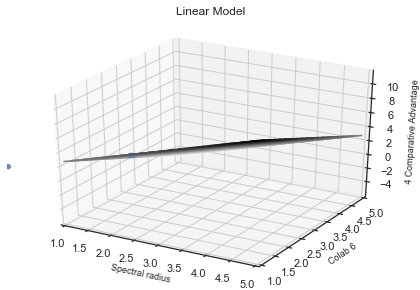




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Modularidad, Clustering
Predicted: 4 Comparative Advantage
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8363684243698838, p-value: [[0.0112693  0.01020548]]
Regression Coefficients: [ 1.35377677 -1.42797972]
Intercept: 2.812902633455614


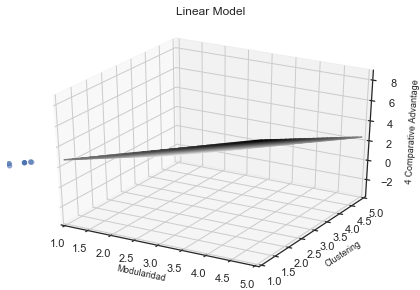




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Modularidad, Transitividad
Predicted: 4 Comparative Advantage
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.9532414982237845, p-value: [[0.00083234 0.00104692]]
Regression Coefficients: [ 1.47135536 -1.47419295]
Intercept: 2.7757419100246072


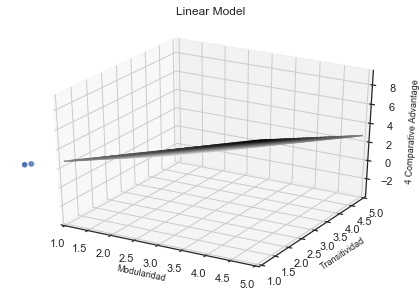




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Modularidad, Eficiencia Global
Predicted: 4 Comparative Advantage
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.9005684862137263, p-value: [[0.0027413  0.00682192]]
Regression Coefficients: [ 1.66591944 -1.3772352 ]
Intercept: 2.6120390441597894


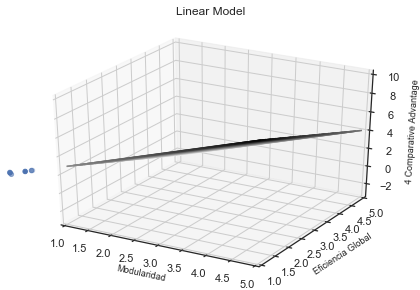




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Modularidad, Core Ratio
Predicted: 4 Comparative Advantage
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.9206218618665184, p-value: [[0.00320935 0.00215608]]
Regression Coefficients: [ 1.37165327 -1.51922393]
Intercept: 2.8531406422686896


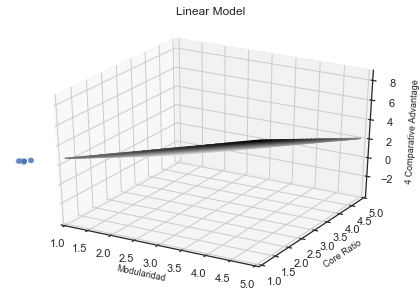




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Modularidad, Colab 1
Predicted: 4 Comparative Advantage
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.9186710575581855, p-value: [[0.00637986 0.00280223]]
Regression Coefficients: [ 0.88532044 -1.06863659]
Intercept: 2.916542293123491


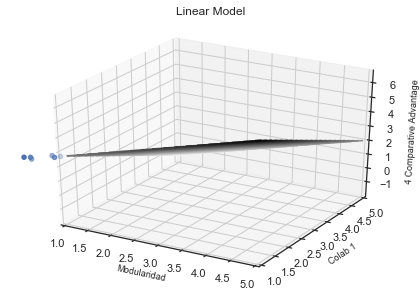




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Modularidad, Colab 3
Predicted: 4 Comparative Advantage
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.9169566633687203, p-value: [[0.00257049 0.0031332 ]]
Regression Coefficients: [ 1.3474749  -1.30296272]
Intercept: 2.7523140298069175


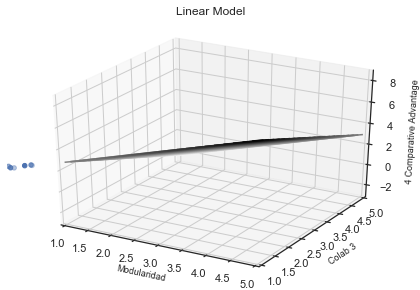




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Modularidad, Colab 4
Predicted: 4 Comparative Advantage
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.9591587417692515, p-value: [[0.00064066 0.00073436]]
Regression Coefficients: [ 1.34630553 -1.33344727]
Intercept: 2.773900456424025


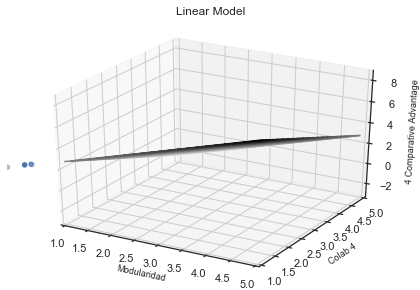




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Modularidad, Colab 5
Predicted: 4 Comparative Advantage
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.9393547352954805, p-value: [[0.00268192 0.00161303]]
Regression Coefficients: [ 1.28510667 -1.49918874]
Intercept: 2.8997113314671124


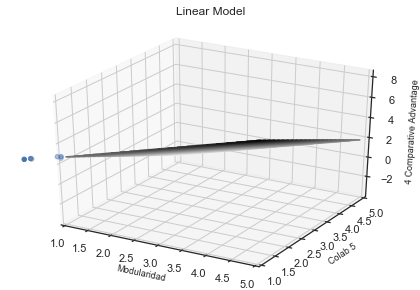




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Modularidad, Colab 6
Predicted: 4 Comparative Advantage
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.9430084662916167, p-value: [[0.00122225 0.00148523]]
Regression Coefficients: [ 1.4303354  -1.40336413]
Intercept: 2.761137631562328


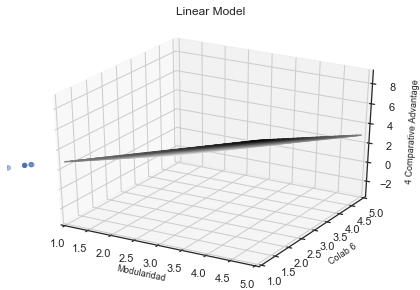




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Average collabs, Excentricidad
Predicted: 4 Comparative Advantage
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8655718782556007, p-value: [[0.02010999 0.00913731]]
Regression Coefficients: [-0.08839761  0.11224397]
Intercept: 2.582708789739271


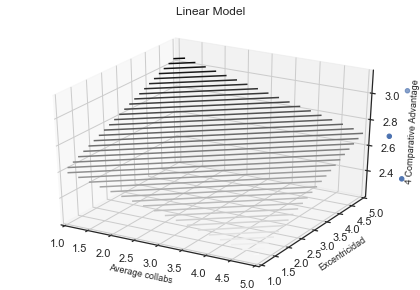




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Average collabs, Diámetro
Predicted: 4 Comparative Advantage
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8502674311144567, p-value: [[0.0269582  0.01006291]]
Regression Coefficients: [-0.07822128  0.10647758]
Intercept: 2.526506418350431


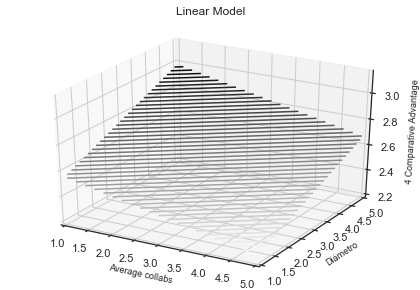




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Average collabs, Radio
Predicted: 4 Comparative Advantage
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8962518803041825, p-value: [[0.00729443 0.00501672]]
Regression Coefficients: [-0.10468968  0.11807559]
Intercept: 2.713647789911251


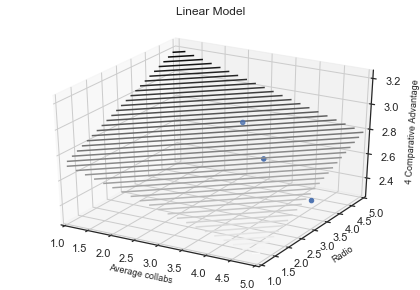




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Average collabs, Camino más corto promedio
Predicted: 4 Comparative Advantage
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8431129145483727, p-value: [[0.02500523 0.01341277]]
Regression Coefficients: [-0.10381021  0.12552537]
Intercept: 2.611576618570613


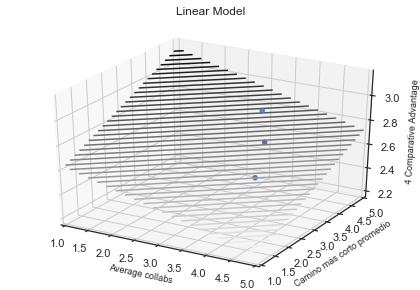




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Colab 0, Excentricidad
Predicted: 4 Comparative Advantage
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8624793891641083, p-value: [[0.04556865 0.00662041]]
Regression Coefficients: [-0.03328999  0.04703258]
Intercept: 2.630635111959794


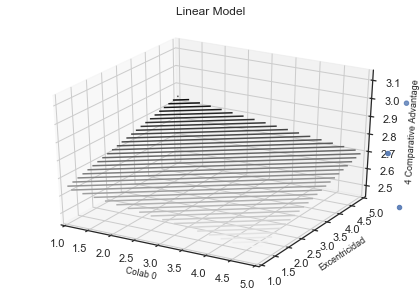




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Colab 0, Diámetro
Predicted: 4 Comparative Advantage
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8735588816537128, p-value: [[0.01411497 0.00569503]]
Regression Coefficients: [-0.04372644  0.04607233]
Intercept: 2.7110275719841064


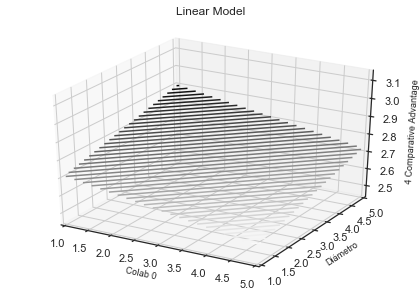




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Colab 0, Radio
Predicted: 4 Comparative Advantage
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8618503347129384, p-value: [[0.02360374 0.00739046]]
Regression Coefficients: [-0.04215124  0.04559639]
Intercept: 2.7159283113898676


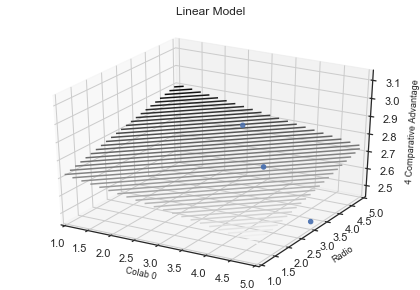




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Colab 1, avg strength
Predicted: 4 Comparative Advantage
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.906928937271446, p-value: [[0.00339629 0.0035345 ]]
Regression Coefficients: [-1.10621771  1.13967031]
Intercept: 2.7638351383530706


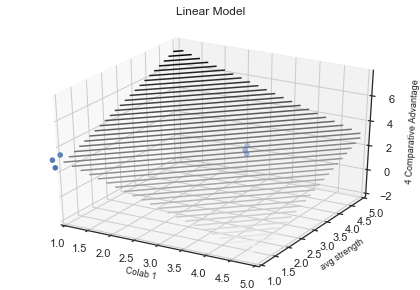




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Colab 1, Spectral radius
Predicted: 4 Comparative Advantage
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.9650996819382781, p-value: [[0.00049503 0.00057565]]
Regression Coefficients: [-1.33085365  1.27480903]
Intercept: 2.83221049280125


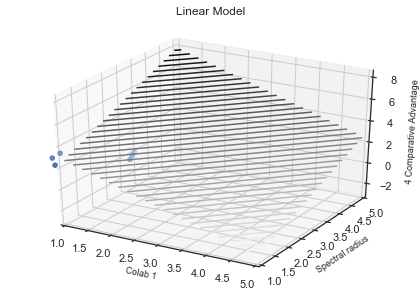




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Colab 1, Modularidad
Predicted: 4 Comparative Advantage
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.9418888781575294, p-value: [[0.00257361 0.00137346]]
Regression Coefficients: [-0.95937285  1.09196195]
Intercept: 2.6805364170504697


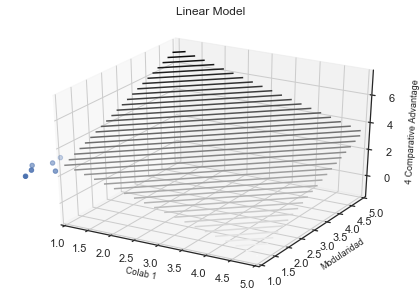




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Colab 2, avg strength
Predicted: 4 Comparative Advantage
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.9031337904636212, p-value: [[0.00392361 0.00440581]]
Regression Coefficients: [-0.68952112  0.6997134 ]
Intercept: 2.7697836312801494


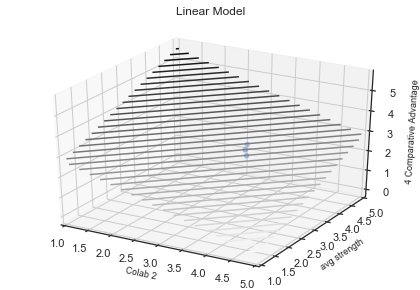




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Colab 2, Spectral radius
Predicted: 4 Comparative Advantage
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.9046982211239255, p-value: [[0.00358687 0.00423581]]
Regression Coefficients: [-0.74591965  0.71598646]
Intercept: 2.765733865290448


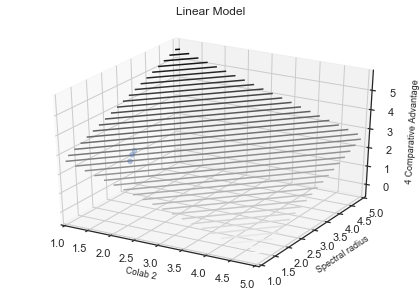




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Colab 2, Modularidad
Predicted: 4 Comparative Advantage
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.952325775440031, p-value: [[0.00098861 0.00121177]]
Regression Coefficients: [-0.74484413  0.68859794]
Intercept: 2.767455974151481


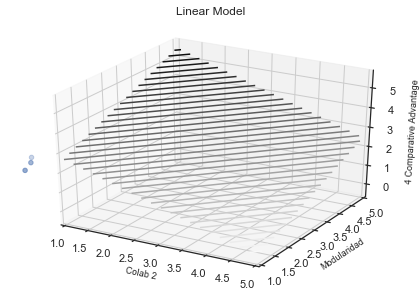




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Colab 3, avg strength
Predicted: 4 Comparative Advantage
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8247352116000606, p-value: [[0.01435839 0.01530139]]
Regression Coefficients: [-1.34773863  1.38697535]
Intercept: 2.786168330389109


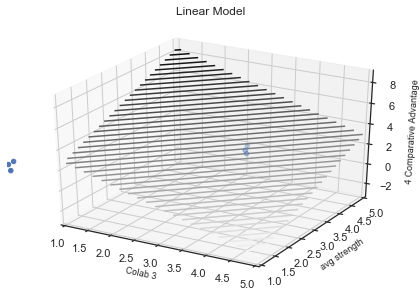




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Colab 3, Spectral radius
Predicted: 4 Comparative Advantage
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.9479811656490377, p-value: [[0.00113537 0.00123586]]
Regression Coefficients: [-1.78419611  1.76099527]
Intercept: 2.7845386332220334


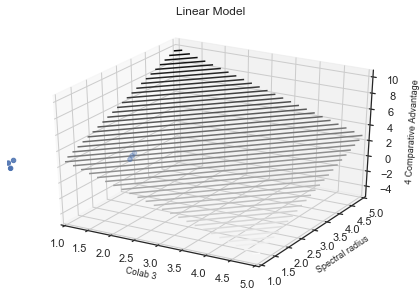




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Colab 3, Modularidad
Predicted: 4 Comparative Advantage
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8353568915487974, p-value: [[0.00958023 0.01443197]]
Regression Coefficients: [-1.31841371  1.19292405]
Intercept: 2.843129809080259


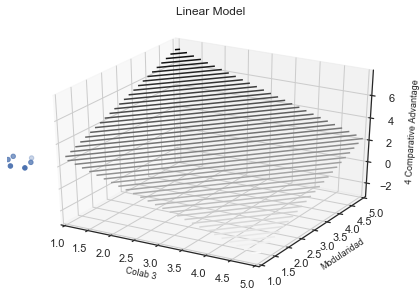




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Colab 4, avg strength
Predicted: 4 Comparative Advantage
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8286747879047542, p-value: [[0.01315091 0.01391248]]
Regression Coefficients: [-1.3514561   1.39448817]
Intercept: 2.7742320141308645


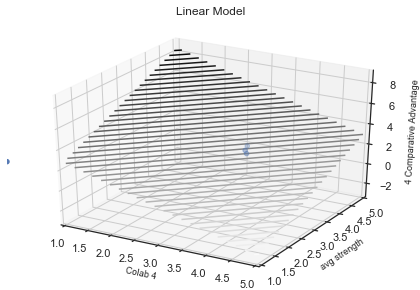




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Colab 4, Spectral radius
Predicted: 4 Comparative Advantage
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.9549057582018273, p-value: [[0.00079001 0.00083859]]
Regression Coefficients: [-1.7886548   1.77814354]
Intercept: 2.760427921437225


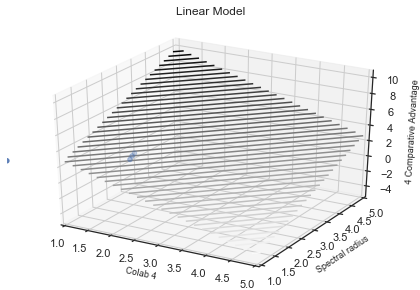




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Colab 4, Modularidad
Predicted: 4 Comparative Advantage
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8399202155968726, p-value: [[0.00991478 0.0127379 ]]
Regression Coefficients: [-1.27259144  1.21397519]
Intercept: 2.8041443100527514


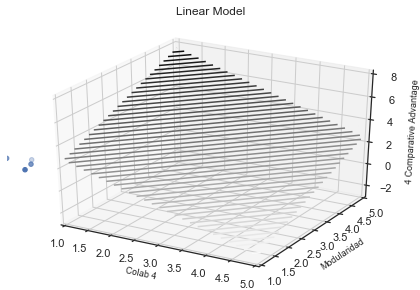




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Colab 4, Colab 6
Predicted: 5 Impact
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8494726075828041, p-value: [[0.00253267 0.00286871]]
Regression Coefficients: [2.94623704 2.17580152]
Intercept: 2.631014688519121


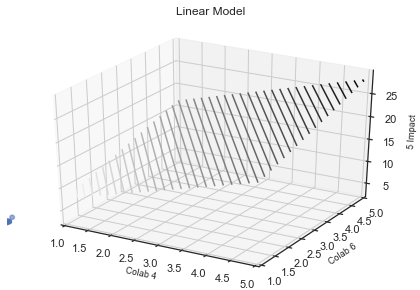




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Colab 5, Spectral radius
Predicted: 4 Comparative Advantage
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8738438518971207, p-value: [[0.00796859 0.01016833]]
Regression Coefficients: [-2.15159423  2.02822832]
Intercept: 2.98143298242702


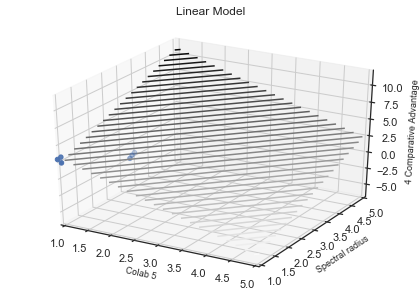




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Colab 6, Clustering
Predicted: 5 Impact
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8165354480794723, p-value: [[0.03412442 0.00495977]]
Regression Coefficients: [1.8637015  2.63603279]
Intercept: 2.6271173884667895


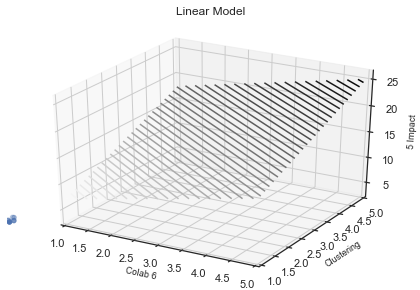




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Colab 6, Spectral radius
Predicted: 4 Comparative Advantage
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.9174856189292503, p-value: [[0.00276794 0.00293971]]
Regression Coefficients: [-1.97327257  1.96173373]
Intercept: 2.7679335220144354


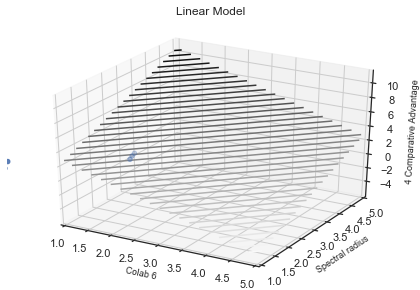

In [28]:
'''
3D linear models for predicting impact and comparative advantage using graph metrics
'''
# list of all global metrics
grf_key_list=list(grf_df.keys())

# our two predictors
ieco_key_predictors=['4 Comparative Advantage','5 Impact']    

for key1 in grf_key_list:
    for key2 in grf_key_list:                                 # for each pair (a,b) of distinct global metrics
        if key1 != key2:                                      
            for predict in ieco_key_predictors:               # and each predictor
                
                # we make a numpy array with the predicted values and reshape it into 2 rows, 6 columns
                #X = np.concatenate([ieco_grf_df[key1].to_numpy(),ieco_grf_df[key2].to_numpy()],axis=0)
                X = np.concatenate([ieco_grf_df[key1].to_numpy(),ieco_grf_df[key2].to_numpy()],axis=0)
                X = X.reshape(6,2)
                
                # make a numpy array for our predictor
                y=ieco_grf_df[predict].to_numpy()
                
                #make linear regression with X,y data and obtain p-value
                reg=LinearRegression().fit(X,y)
                p=lin_reg_p_val(reg,X,y)
                
                #if p-value is small enough and the regression score is greater than 0.8:
                if p[0][0]<.05 and p[0][1]<.05 and reg.score(X,y)>.8:
                    print('- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -')
                    print('Predictor metrics: '+key1+', '+key2)
                    print('Predicted: '+predict)
                    print('- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -')
                    print('Regression Score: ' + str(reg.score(X,y)) + ', p-value: ' + str(p) )
                    print('Regression Coefficients: ' + str(reg.coef_) )
                    print('Intercept: ' + str(reg.intercept_))
                    plot_linear_model(reg,X,y,key1,key2,predict)
                    print('')
                    print('')
                    print('')

- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: avg strength, weight
Predicted: 2.05 I-Culture & Incentives
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8952586317990942, p-value: [[0.02256249 0.00251289]]
Regression Coefficients: [ 0.82868416 -1.5143133 ]
Intercept: 4.212702586081682


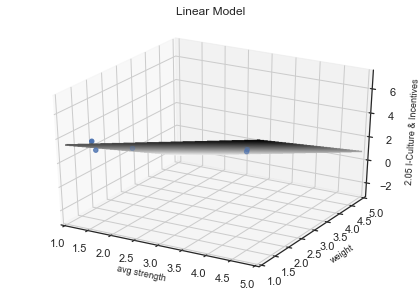




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: avg strength, weight
Predicted: 3.04 E-Demand
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8403769103357014, p-value: [[0.01318754 0.00551553]]
Regression Coefficients: [ 0.35556682 -0.44573879]
Intercept: 3.5055405160597046


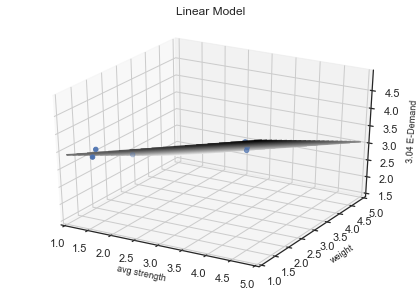




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: avg strength, Degree
Predicted: 2.05 I-Culture & Incentives
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8916870004016189, p-value: [[4.58014025e-06 6.75977261e-03]]
Regression Coefficients: [ 3.68802102 -0.4511024 ]
Intercept: -9.147444370876007


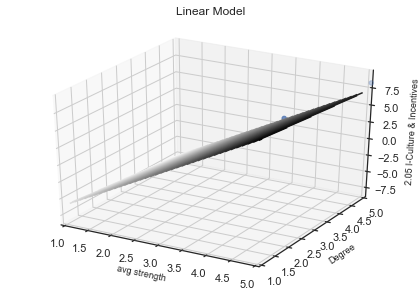




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: avg strength, Weighted Degree
Predicted: 2.05 I-Culture & Incentives
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.9026306071702491, p-value: [[0.00173048 0.00473411]]
Regression Coefficients: [ 0.27469535 -0.15362493]
Intercept: 1.6359860536108402


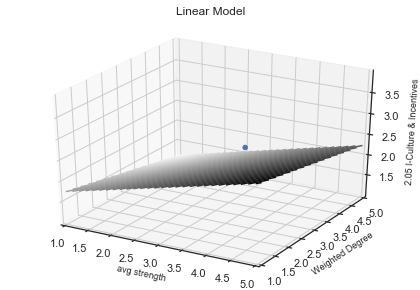




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: avg strength, Weighted Degree
Predicted: 3.04 E-Demand
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8057512091463337, p-value: [[0.02118562 0.0153164 ]]
Regression Coefficients: [ 0.05659758 -0.04582451]
Intercept: 3.2276161027268473


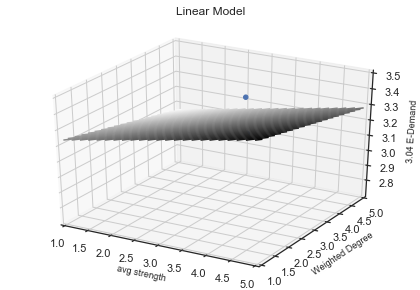




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: avg strength, Clustering
Predicted: 3.02 E-Funding
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8660109201889095, p-value: [[0.00485972 0.00421563]]
Regression Coefficients: [ 1.95767605 -2.13557225]
Intercept: 2.3314188689646445


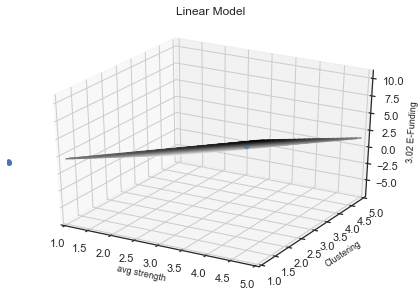




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: avg strength, Clustering
Predicted: 4 Comparative Advantage
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8275263122845318, p-value: [[0.01136943 0.01166019]]
Regression Coefficients: [ 1.59868448 -1.66482413]
Intercept: 2.8188649693195904


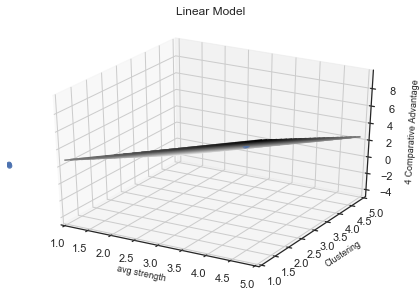




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: avg strength, Transitividad
Predicted: 3.02 E-Funding
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8067907549326078, p-value: [[0.01266171 0.01139586]]
Regression Coefficients: [ 1.84052953 -1.99372105]
Intercept: 2.269779452636494


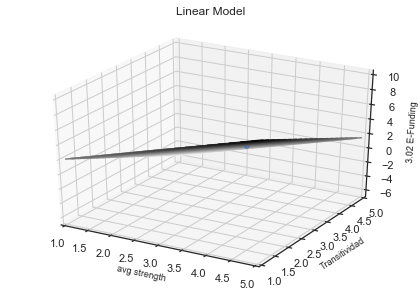




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: avg strength, Transitividad
Predicted: 4 Comparative Advantage
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.9614385297472103, p-value: [[0.00060939 0.00063759]]
Regression Coefficients: [ 1.71486568 -1.78025141]
Intercept: 2.7974706641864664


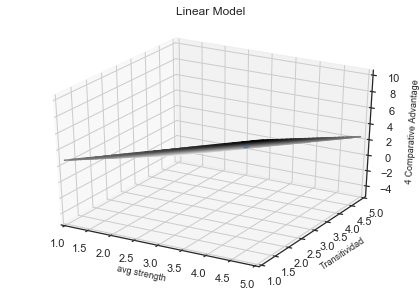




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: avg strength, Eficiencia Global
Predicted: 3.02 E-Funding
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8570821122307687, p-value: [[0.00833965 0.00778247]]
Regression Coefficients: [ 1.96528674 -2.10523997]
Intercept: 2.2045128256952418


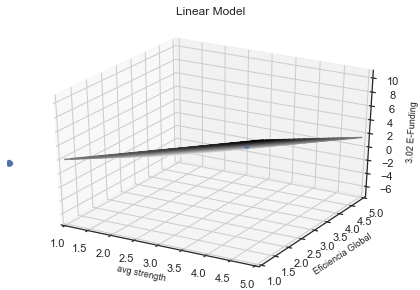




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: avg strength, Eficiencia Global
Predicted: 4 Comparative Advantage
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.9026624487127014, p-value: [[0.00509078 0.00558599]]
Regression Coefficients: [ 1.70507095 -1.74548288]
Intercept: 2.7168644705934555


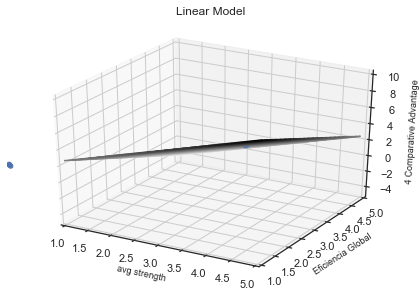




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: avg strength, Small Worldness
Predicted: 2.01 I-Human Capital
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8401585016513857, p-value: [[0.00192998 0.0011409 ]]
Regression Coefficients: [ 2.30746111 -2.72935231]
Intercept: 3.305488421302511


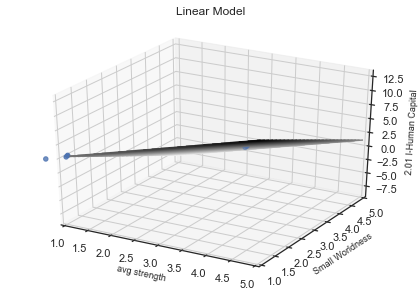




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: avg strength, Small Worldness
Predicted: 3.02 E-Funding
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.9144864744024914, p-value: [[0.00053005 0.00029114]]
Regression Coefficients: [ 1.43360313 -1.72183429]
Intercept: 2.78162342487804


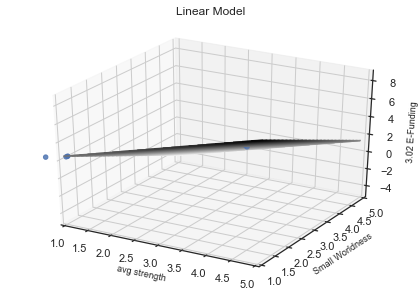




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: avg strength, Rich Club Coefficient
Predicted: 2.01 I-Human Capital
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.9429007588302405, p-value: [[0.00122973 0.00125885]]
Regression Coefficients: [ 0.93373781 -0.97730029]
Intercept: 2.2794547976765807


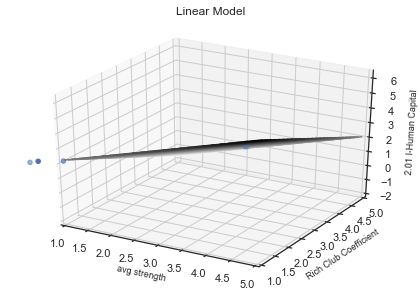




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: avg strength, Rich Club Coefficient
Predicted: 2.03 I-Infrastructure
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8171166991822248, p-value: [[0.02012954 0.01484325]]
Regression Coefficients: [ 0.50449071 -0.58260939]
Intercept: 3.6157832366151235


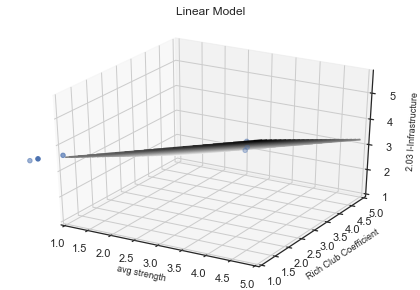




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: avg strength, Rich Club Coefficient
Predicted: 3.03 E-Infrastructure
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8105610251480072, p-value: [[0.02509536 0.01712428]]
Regression Coefficients: [ 0.44002204 -0.52143314]
Intercept: 3.974101157977455


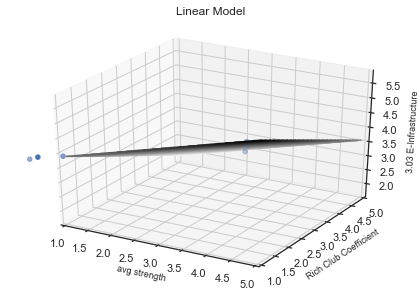




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: avg strength, Core Ratio
Predicted: 3.02 E-Funding
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8257748859511453, p-value: [[0.00842383 0.00719442]]
Regression Coefficients: [ 1.90575128 -2.08733297]
Intercept: 2.3516189036577035


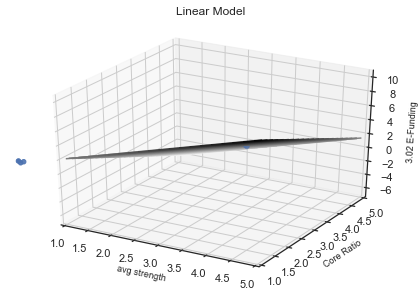




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: avg strength, Core Ratio
Predicted: 4 Comparative Advantage
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.9287059659381748, p-value: [[0.00171129 0.00172726]]
Regression Coefficients: [ 1.72520365 -1.80251961]
Intercept: 2.8350262369747496


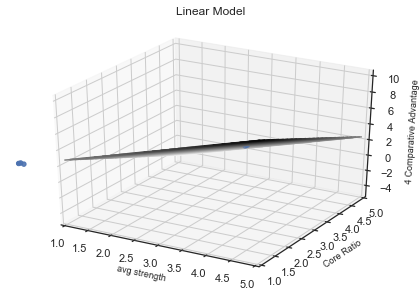




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: avg strength, Central Point Dominance
Predicted: 2.01 I-Human Capital
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8518532400990135, p-value: [[0.00697043 0.00750405]]
Regression Coefficients: [ 2.48022039 -2.55985767]
Intercept: 2.142749020623245


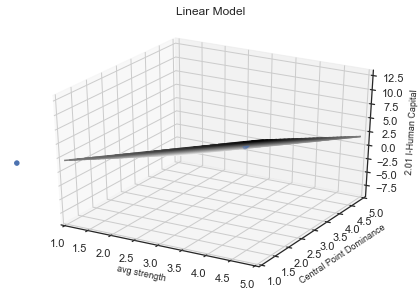




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: avg strength, Central Point Dominance
Predicted: 3.02 E-Funding
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.9145174772899954, p-value: [[0.00235546 0.00245158]]
Regression Coefficients: [ 1.53619193 -1.60161324]
Intercept: 2.0305511063439177


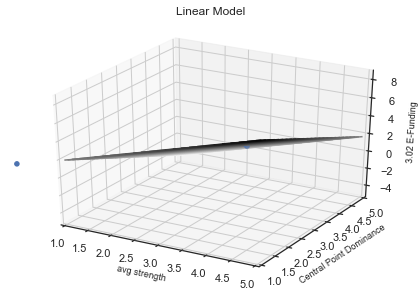




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: avg strength, Spectral radius
Predicted: 2.02 I-Funding
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8472705888056405, p-value: [[0.01341798 0.0163393 ]]
Regression Coefficients: [-1.61196241  1.58459391]
Intercept: 1.8647974080358234


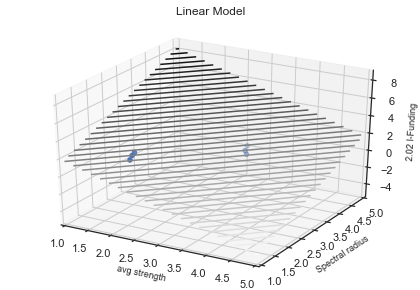




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: avg strength, Modularidad
Predicted: 2.02 I-Funding
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8316505154267717, p-value: [[0.01736627 0.02324664]]
Regression Coefficients: [-1.25821151  1.21040458]
Intercept: 1.8725417974098495


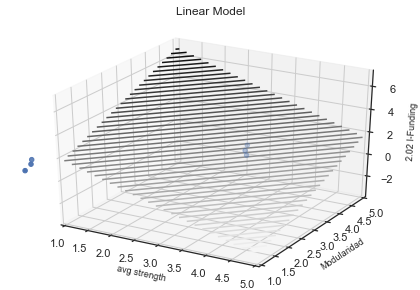




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: avg strength, Colab 0
Predicted: 2.05 I-Culture & Incentives
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8162830126626608, p-value: [[0.0052018  0.02587749]]
Regression Coefficients: [ 0.31596024 -0.14749632]
Intercept: 1.5355672619304483


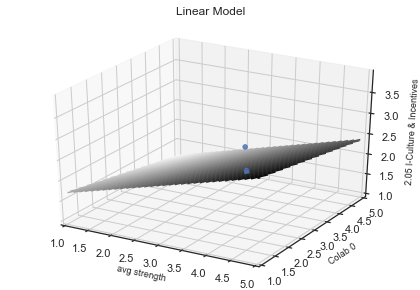




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: avg strength, Colab 1
Predicted: 2.04 I-Demand
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8628208772663669, p-value: [[0.00589808 0.00539502]]
Regression Coefficients: [ 1.04979695 -1.12075126]
Intercept: 2.9836119566425006


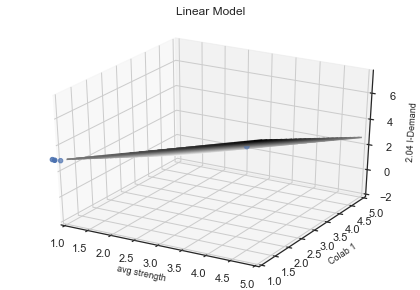




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: avg strength, Colab 1
Predicted: 3.02 E-Funding
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8015273123068766, p-value: [[0.01368111 0.0105401 ]]
Regression Coefficients: [ 1.19149884 -1.33933665]
Intercept: 2.3632036706990944


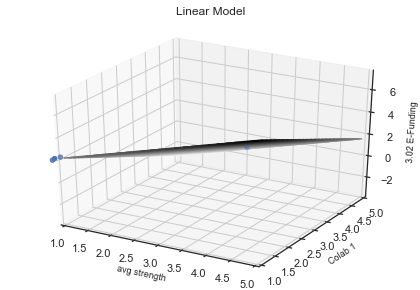




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: avg strength, Colab 1
Predicted: 4 Comparative Advantage
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8563552998033908, p-value: [[0.00835917 0.00873216]]
Regression Coefficients: [ 1.07045379 -1.10103946]
Intercept: 2.791850319863153


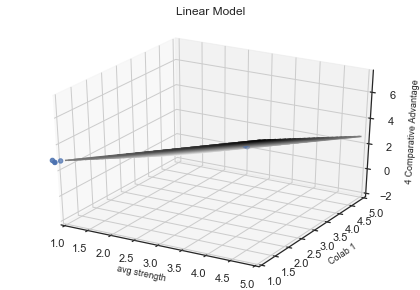




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: avg strength, Colab 2
Predicted: 2.04 I-Demand
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8180060508796276, p-value: [[0.01158753 0.01120823]]
Regression Coefficients: [ 0.63395213 -0.670531  ]
Intercept: 2.941019151795151


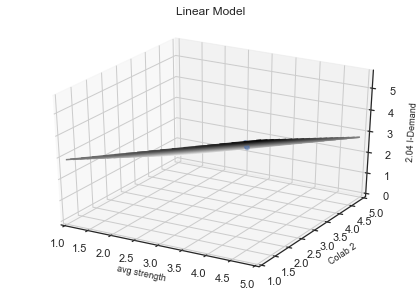




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: avg strength, Colab 2
Predicted: 2.05 I-Culture & Incentives
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8717665418666498, p-value: [[0.00823134 0.00560741]]
Regression Coefficients: [ 2.52118153 -2.94175545]
Intercept: 3.0433914702010356


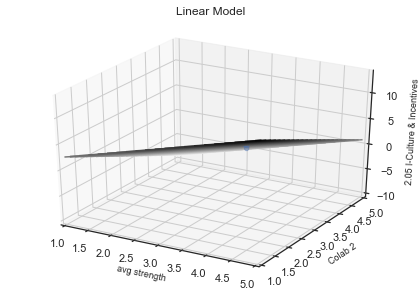




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: avg strength, Colab 3
Predicted: 3.02 E-Funding
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.9137285596817181, p-value: [[0.00248143 0.00215677]]
Regression Coefficients: [ 1.68893484 -1.83904332]
Intercept: 2.285273781237511


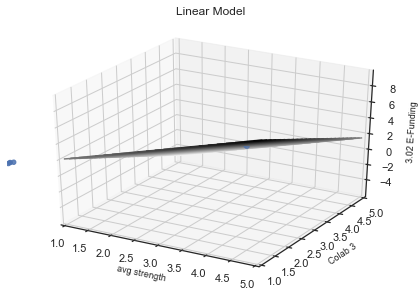




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: avg strength, Colab 3
Predicted: 4 Comparative Advantage
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8947148724331329, p-value: [[0.0048842 0.0051811]]
Regression Coefficients: [ 1.42097633 -1.4662419 ]
Intercept: 2.7806255885035562


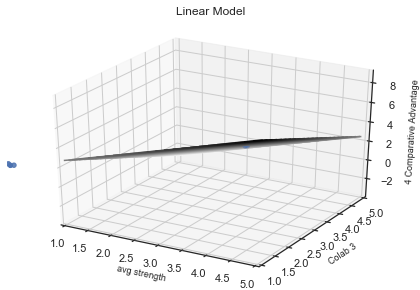




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: avg strength, Colab 4
Predicted: 2.04 I-Demand
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8001438704856347, p-value: [[0.01355062 0.01326101]]
Regression Coefficients: [ 1.31613104 -1.3896717 ]
Intercept: 2.9470903591356072


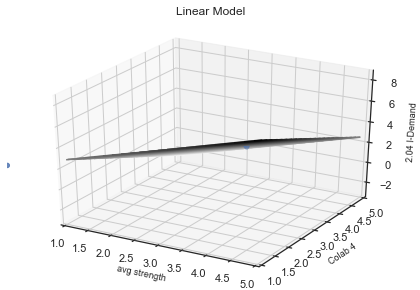




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: avg strength, Colab 4
Predicted: 3.02 E-Funding
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8716352236138692, p-value: [[0.00541122 0.00471325]]
Regression Coefficients: [ 1.64640736 -1.79453409]
Intercept: 2.286212927672999


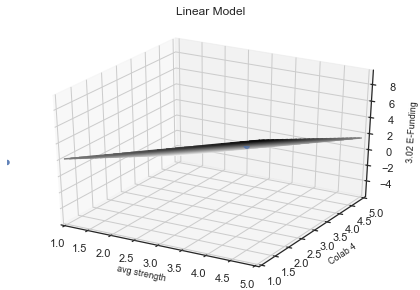




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: avg strength, Colab 4
Predicted: 4 Comparative Advantage
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.9381229329495778, p-value: [[0.00156969 0.00164984]]
Regression Coefficients: [ 1.46149827 -1.51329176]
Intercept: 2.795623609230865


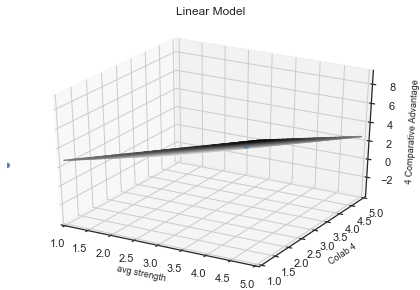




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: avg strength, Colab 5
Predicted: 3.02 E-Funding
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8461156982509921, p-value: [[0.00879176 0.00764673]]
Regression Coefficients: [ 1.88063384 -2.0483402 ]
Intercept: 2.311232676053538


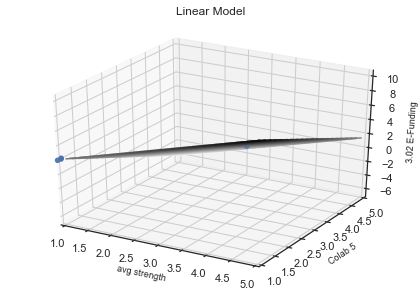




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: avg strength, Colab 5
Predicted: 4 Comparative Advantage
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.9425108906942038, p-value: [[0.00151578 0.00162162]]
Regression Coefficients: [ 1.70030272 -1.74842902]
Intercept: 2.742916861895814


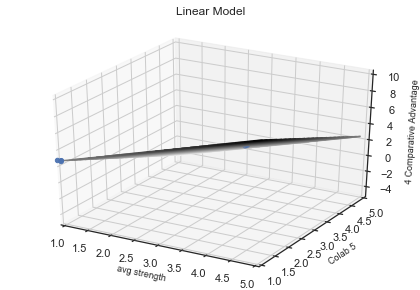




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: avg strength, Colab 6
Predicted: 3.02 E-Funding
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8839068054412279, p-value: [[0.0044154  0.00389204]]
Regression Coefficients: [ 1.81598278 -1.97258044]
Intercept: 2.2851028458664127


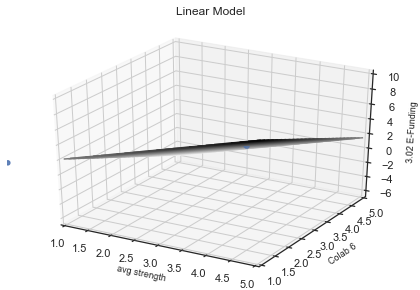




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: avg strength, Colab 6
Predicted: 4 Comparative Advantage
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.9367037877692601, p-value: [[0.0016764  0.00175973]]
Regression Coefficients: [ 1.59293354 -1.65023807]
Intercept: 2.791412355084774


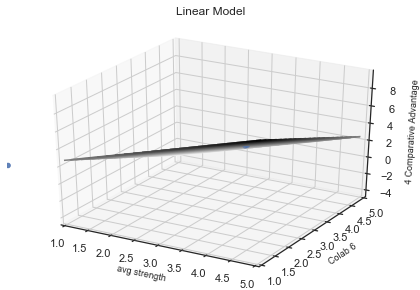




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: weight, avg strength
Predicted: 3.01 E-Human Capital
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.9778204913080029, p-value: [[0.00018754 0.00015061]]
Regression Coefficients: [-0.6900992   0.71320393]
Intercept: 3.112349361253397


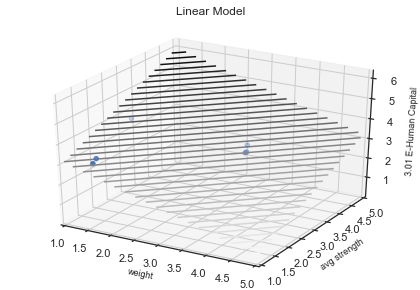




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: weight, Degree
Predicted: 2.02 I-Funding
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8254770170859531, p-value: [[0.00539603 0.02660709]]
Regression Coefficients: [ 0.27965238 -0.12156903]
Intercept: 1.330108983794044


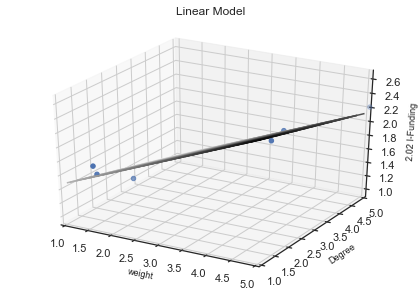




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: weight, Degree
Predicted: 2.05 I-Culture & Incentives
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.838673853604002, p-value: [[0.00561    0.01336874]]
Regression Coefficients: [ 0.89092203 -0.48323969]
Intercept: 1.7214204101890844


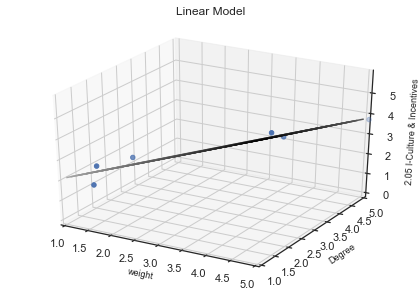




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: weight, Weighted Degree
Predicted: 2.05 I-Culture & Incentives
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8917145522769856, p-value: [[0.00357902 0.00599521]]
Regression Coefficients: [ 0.24488916 -0.1531878 ]
Intercept: 2.0201230267112367


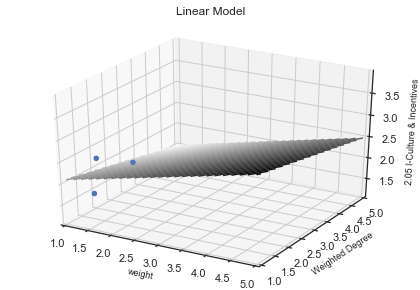




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: weight, Weighted Degree
Predicted: 3.04 E-Demand
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8083057477154643, p-value: [[0.02871027 0.01543193]]
Regression Coefficients: [ 0.05247816 -0.04585212]
Intercept: 3.282687500447778


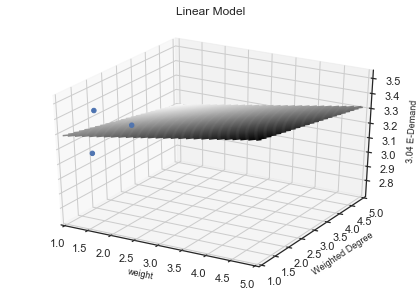




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: weight, Clustering
Predicted: 3.01 E-Human Capital
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.9367681296436273, p-value: [[0.01493079 0.00237145]]
Regression Coefficients: [-0.57657333  0.70025715]
Intercept: 2.9842724720888105


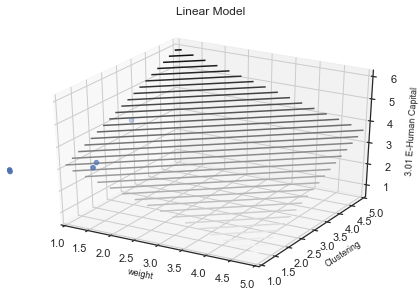




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: weight, Transitividad
Predicted: 3.01 E-Human Capital
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.9379715046529226, p-value: [[0.01231781 0.00225259]]
Regression Coefficients: [-0.60672225  0.70268063]
Intercept: 3.0183530545946655


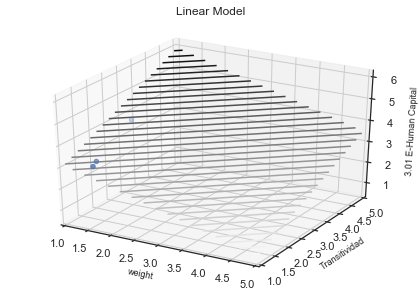




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: weight, Eficiencia Global
Predicted: 3.01 E-Human Capital
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.9366159345885171, p-value: [[0.01165236 0.0023302 ]]
Regression Coefficients: [-0.61378471  0.70111662]
Intercept: 3.0322965970153763


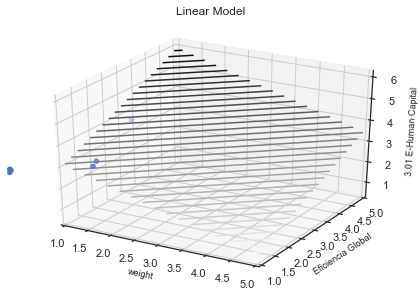




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: weight, Rich Club Coefficient
Predicted: 3.05 E-Culture & Incentives
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.9231004870269961, p-value: [[0.00111043 0.00276058]]
Regression Coefficients: [-0.64133553  0.39459219]
Intercept: 3.3043964150631995


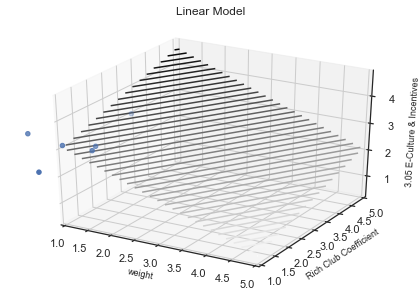




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: weight, Core Ratio
Predicted: 3.01 E-Human Capital
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.9397579199901746, p-value: [[0.01320964 0.00207892]]
Regression Coefficients: [-0.5772066   0.70730165]
Intercept: 2.9674218967693675


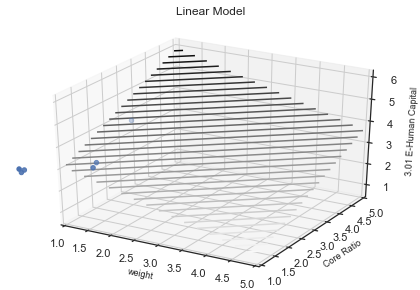




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: weight, Central Point Dominance
Predicted: 3.01 E-Human Capital
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.885239297134209, p-value: [[0.03519718 0.00788233]]
Regression Coefficients: [-0.55195405  0.6425944 ]
Intercept: 3.0717350927223133


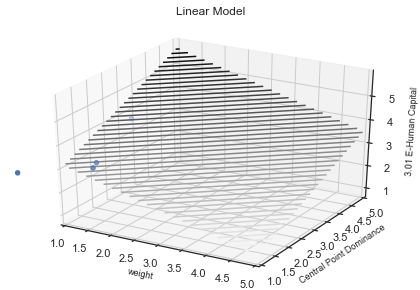




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: weight, Spectral radius
Predicted: 3.01 E-Human Capital
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.9711175259281213, p-value: [[0.00033384 0.0003244 ]]
Regression Coefficients: [-0.80672393  0.71226747]
Intercept: 3.275439808386622


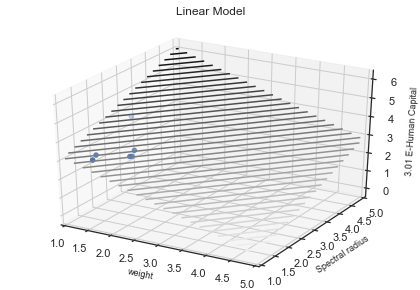




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: weight, Modularidad
Predicted: 3.01 E-Human Capital
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.966740414347034, p-value: [[0.00207691 0.00054253]]
Regression Coefficients: [-0.65135341  0.69946984]
Intercept: 3.0862302601421256


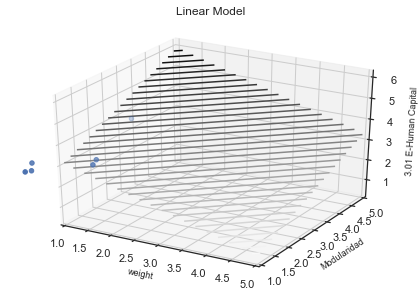




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: weight, Average collabs
Predicted: 3.05 E-Culture & Incentives
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.830424013012501, p-value: [[0.01160278 0.01067832]]
Regression Coefficients: [-0.18692334  0.19045077]
Intercept: 3.0424652052326535


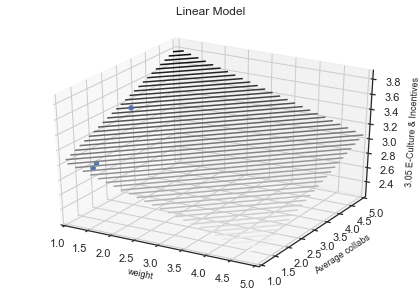




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: weight, Colab 0
Predicted: 2.05 I-Culture & Incentives
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8329251385612337, p-value: [[0.00858143 0.01757375]]
Regression Coefficients: [ 0.27341912 -0.1590491 ]
Intercept: 2.032305726494839


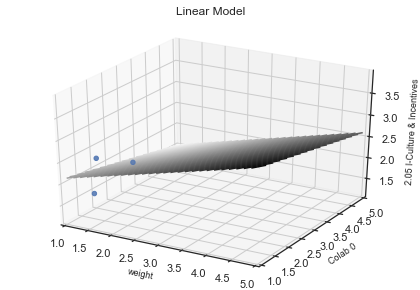




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: weight, Colab 3
Predicted: 3.01 E-Human Capital
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.911096407369317, p-value: [[0.02811734 0.00472616]]
Regression Coefficients: [-0.55517667  0.68182024]
Intercept: 2.98802506285406


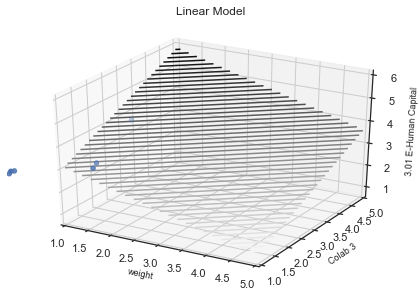




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: weight, Colab 4
Predicted: 3.01 E-Human Capital
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.9141014928287354, p-value: [[0.02554971 0.00439952]]
Regression Coefficients: [-0.56693092  0.68491205]
Intercept: 2.9969266532677348


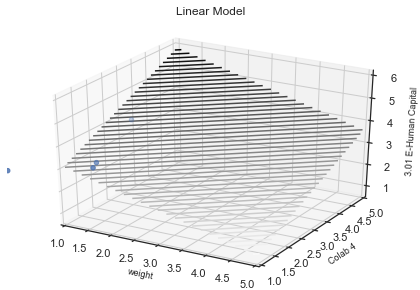




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: weight, Colab 5
Predicted: 3.01 E-Human Capital
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.9403166981774929, p-value: [[0.01977632 0.00177749]]
Regression Coefficients: [-0.45381859  0.70022112]
Intercept: 2.8181429542658996


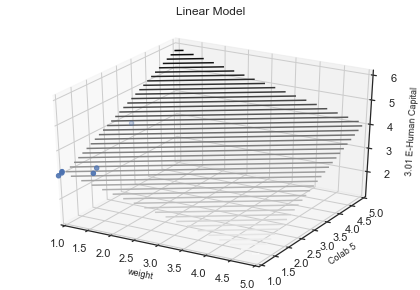




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: weight, Colab 6
Predicted: 3.01 E-Human Capital
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.925771881890049, p-value: [[0.01873324 0.00326756]]
Regression Coefficients: [-0.58196748  0.693838  ]
Intercept: 3.001451902912824


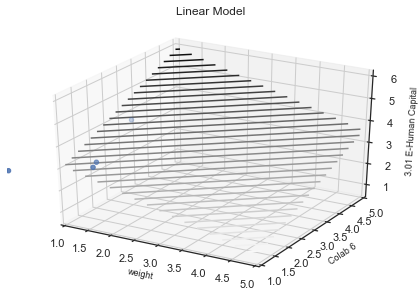




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Degree, Weighted Degree
Predicted: 2.05 I-Culture & Incentives
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8339414630481271, p-value: [[0.00759237 0.0145025 ]]
Regression Coefficients: [ 0.23847583 -0.14206038]
Intercept: 1.9126297713488252


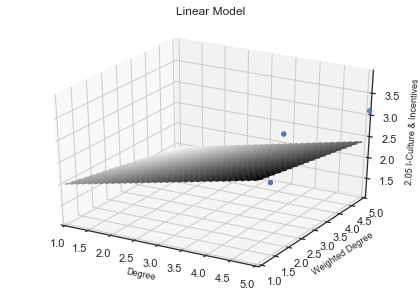




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Degree, Excentricidad
Predicted: 4 Comparative Advantage
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8410559248321874, p-value: [[0.00850402 0.01199147]]
Regression Coefficients: [-0.12098679  0.09597323]
Intercept: 2.843448979672556


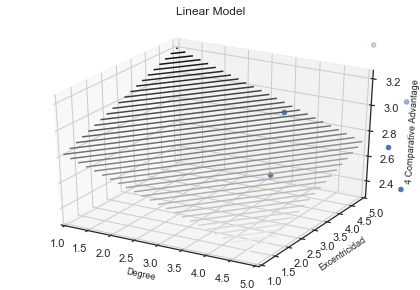




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Degree, Clustering
Predicted: 3.01 E-Human Capital
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.9219387809023323, p-value: [[0.01802577 0.00385153]]
Regression Coefficients: [-0.23317883  0.25087108]
Intercept: 3.0430448985145833


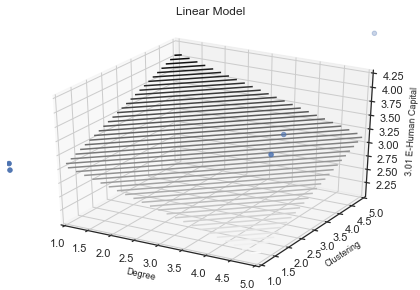




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Degree, Diámetro
Predicted: 4 Comparative Advantage
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8281082231556877, p-value: [[0.01177666 0.01327447]]
Regression Coefficients: [-0.10117666  0.08999311]
Intercept: 2.7938101652270806


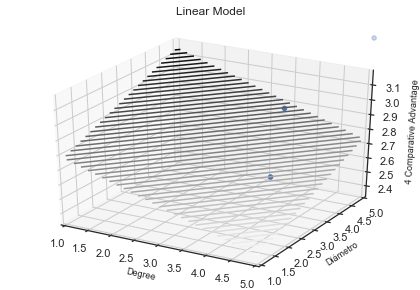




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Degree, Radio
Predicted: 2.02 I-Funding
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.9446754429962416, p-value: [[9.07212511e-05 7.40442723e-04]]
Regression Coefficients: [-0.27593194 -0.13956622]
Intercept: 3.3018048979115386


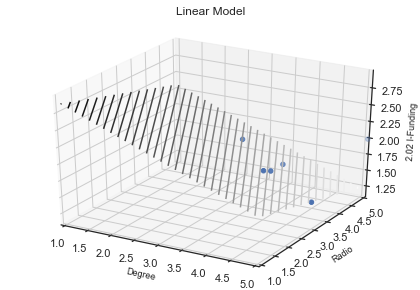




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Degree, Radio
Predicted: 3.01 E-Human Capital
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.9677188495220665, p-value: [[0.025957   0.00019031]]
Regression Coefficients: [0.0754655  0.24959871]
Intercept: 1.9039186509035704


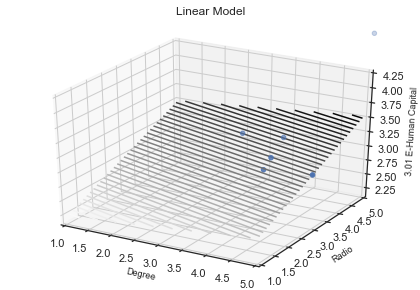




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Degree, Radio
Predicted: 4 Comparative Advantage
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8724478919668119, p-value: [[0.00286157 0.00891462]]
Regression Coefficients: [-0.14698324  0.09288313]
Intercept: 2.9583825752589235


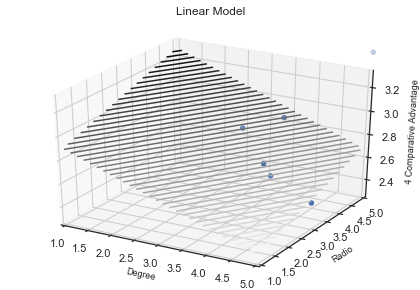




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Degree, Camino más corto promedio
Predicted: 3.01 E-Human Capital
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.9661242852511481, p-value: [[0.00273846 0.00039155]]
Regression Coefficients: [0.18985875 0.25191135]
Intercept: 1.4530215463195972


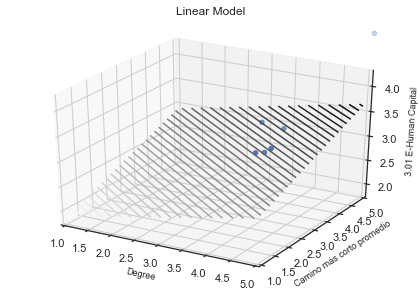




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Degree, Camino más corto promedio
Predicted: 4 Comparative Advantage
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8064469147538643, p-value: [[0.00403901 0.01648631]]
Regression Coefficients: [-0.21210741  0.11321349]
Intercept: 3.070264303124463


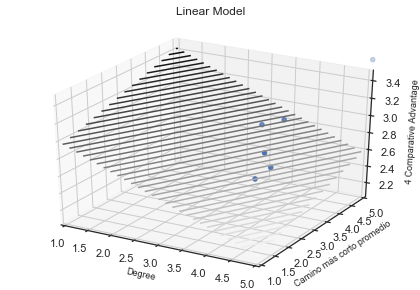




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Degree, Transitividad
Predicted: 3.01 E-Human Capital
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.923448748335753, p-value: [[0.01678537 0.00368116]]
Regression Coefficients: [-0.23614128  0.25153095]
Intercept: 3.0497716072022354


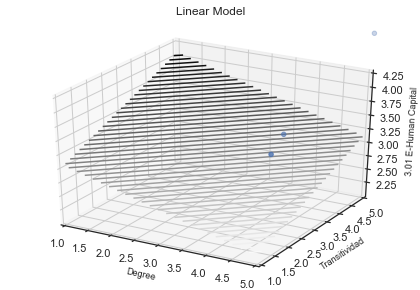




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Degree, Eficiencia Global
Predicted: 3.01 E-Human Capital
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.9223660598525802, p-value: [[0.01659462 0.0037818 ]]
Regression Coefficients: [-0.23794536  0.25116834]
Intercept: 3.058878205411345


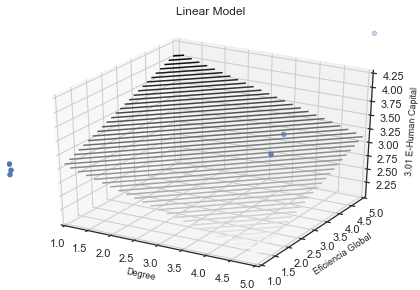




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Degree, Small Worldness
Predicted: 3.01 E-Human Capital
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.9107253305610485, p-value: [[0.03196962 0.00514311]]
Regression Coefficients: [-0.20565977  0.24628085]
Intercept: 2.968059087215023


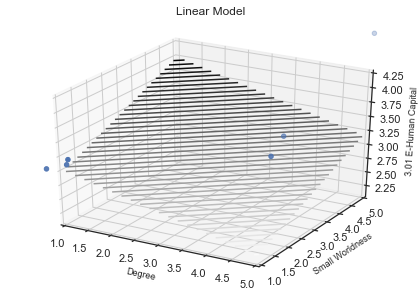




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Degree, Core Ratio
Predicted: 3.01 E-Human Capital
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.9238896458585393, p-value: [[0.01683721 0.00362317]]
Regression Coefficients: [-0.2345113   0.25172412]
Intercept: 3.0425065938688594


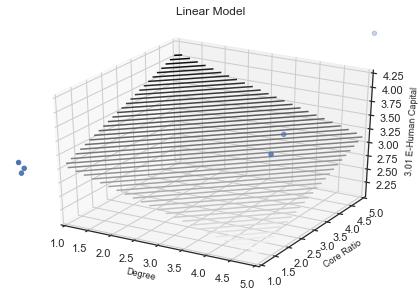




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Degree, Central Point Dominance
Predicted: 3.01 E-Human Capital
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.9064997295095755, p-value: [[0.02288975 0.00557084]]
Regression Coefficients: [-0.23427535  0.24573627]
Intercept: 3.0775048047594415


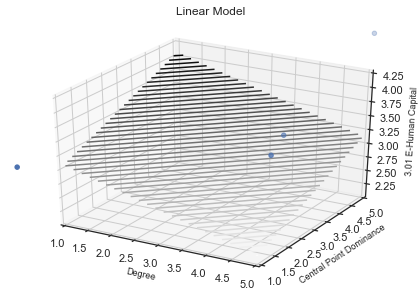




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Degree, Spectral radius
Predicted: 3.01 E-Human Capital
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.938062071766339, p-value: [[0.0084635  0.00200598]]
Regression Coefficients: [-0.23277912  0.25294509]
Intercept: 3.0323932979889348


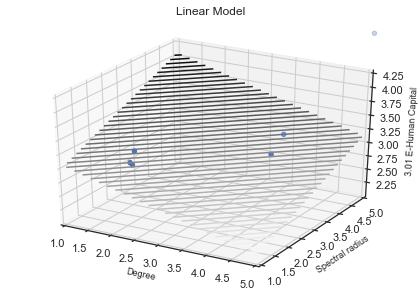




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Degree, Modularidad
Predicted: 3.01 E-Human Capital
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.9411147146107787, p-value: [[0.00854096 0.00207796]]
Regression Coefficients: [-0.24733301  0.25395159]
Intercept: 3.0793064157338828


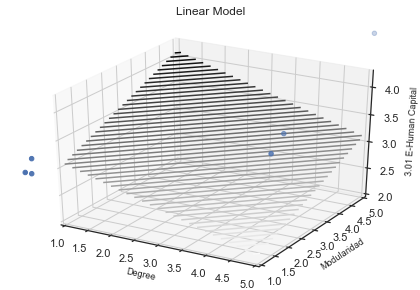




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Degree, Average collabs
Predicted: 2.02 I-Funding
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8222581670654923, p-value: [[0.01338233 0.01847114]]
Regression Coefficients: [ 0.10930381 -0.09496854]
Intercept: 1.5768538593563224


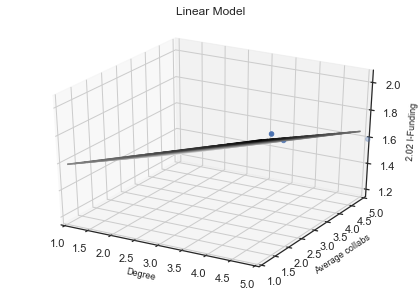




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Degree, Average collabs
Predicted: 3.05 E-Culture & Incentives
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8471747215144998, p-value: [[0.01088003 0.00600695]]
Regression Coefficients: [-0.12667022  0.14352662]
Intercept: 2.8698816701472993


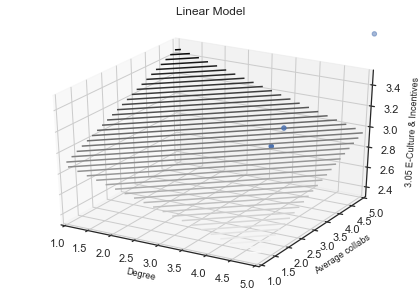




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Degree, Colab 1
Predicted: 3.01 E-Human Capital
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.9071521257177877, p-value: [[0.02600499 0.00538333]]
Regression Coefficients: [-0.22202205  0.24667507]
Intercept: 3.0240242370897854


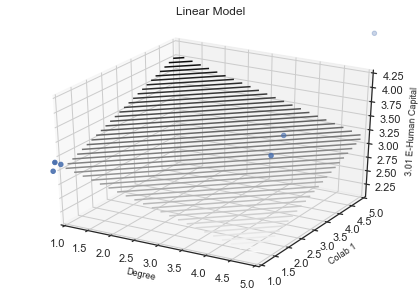




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Degree, Colab 2
Predicted: 3.01 E-Human Capital
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8778490691431939, p-value: [[0.0455135  0.00953205]]
Regression Coefficients: [-0.21248617  0.23885857]
Intercept: 3.0281385214864196


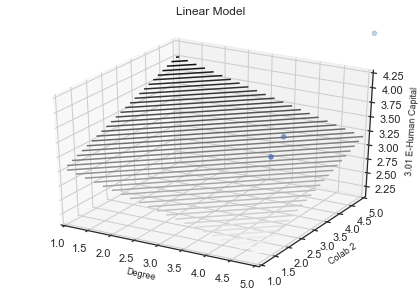




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Degree, Colab 3
Predicted: 3.01 E-Human Capital
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.9153648407636936, p-value: [[0.02078535 0.00453496]]
Regression Coefficients: [-0.23196476  0.24940603]
Intercept: 3.045959272729787


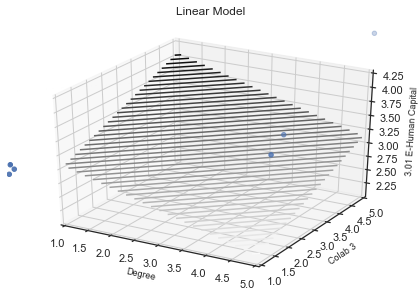




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Degree, Colab 4
Predicted: 3.01 E-Human Capital
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.9168603117541334, p-value: [[0.02009685 0.00436844]]
Regression Coefficients: [-0.23263641  0.24988196]
Intercept: 3.045561605866133


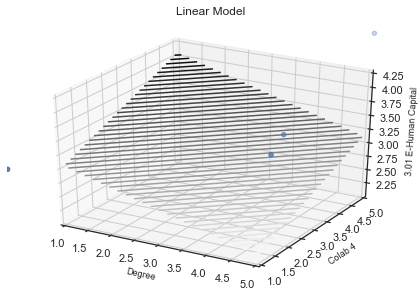




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Degree, Colab 5
Predicted: 3.01 E-Human Capital
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.9224031225086503, p-value: [[0.01620368 0.00363784]]
Regression Coefficients: [-0.23325803  0.25053393]
Intercept: 3.0459561762881933


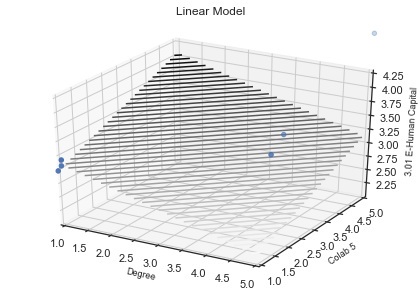




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Degree, Colab 6
Predicted: 3.01 E-Human Capital
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.9196545525496054, p-value: [[0.0186276 0.0040727]]
Regression Coefficients: [-0.23414337  0.25055904]
Intercept: 3.047715249858192


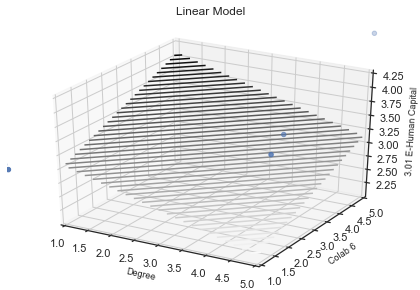




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Weighted Degree, avg strength
Predicted: 3.01 E-Human Capital
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.9607015473685515, p-value: [[0.00388977 0.00085931]]
Regression Coefficients: [-0.06922337  0.07585327]
Intercept: 3.057869581706674


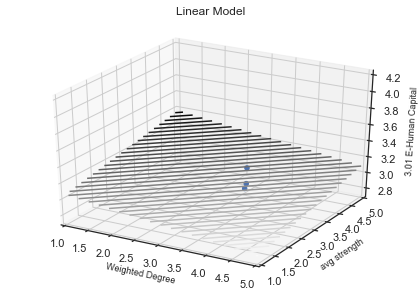




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Weighted Degree, weight
Predicted: 3.01 E-Human Capital
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.9383525239322736, p-value: [[0.01207788 0.00224858]]
Regression Coefficients: [-0.06472565  0.0744422 ]
Intercept: 3.022803594666366


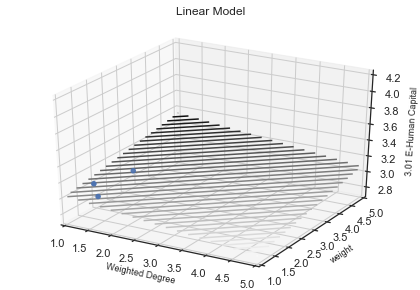




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Weighted Degree, Excentricidad
Predicted: 3.01 E-Human Capital
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.972357006809853, p-value: [[0.00193327 0.00039327]]
Regression Coefficients: [-0.06567758  0.07468518]
Intercept: 3.033636273960809


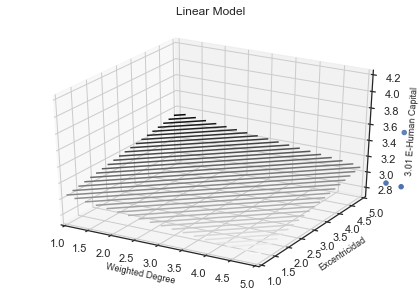




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Weighted Degree, Clustering
Predicted: 3.01 E-Human Capital
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.954000664871868, p-value: [[0.00588008 0.00125112]]
Regression Coefficients: [-0.06903145  0.07551505]
Intercept: 3.061160642833036


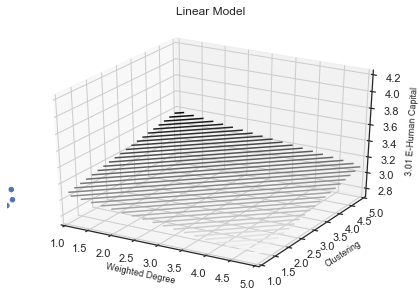




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Weighted Degree, Diámetro
Predicted: 3.01 E-Human Capital
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.9690470501829723, p-value: [[0.00260641 0.00046886]]
Regression Coefficients: [-0.06116442  0.07355722]
Intercept: 2.9984047565076004


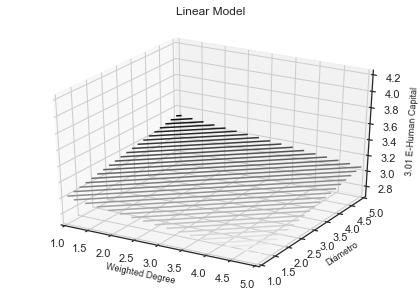




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Weighted Degree, Radio
Predicted: 3.01 E-Human Capital
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.9700864758503515, p-value: [[0.00179543 0.00046049]]
Regression Coefficients: [-0.07052813  0.07464925]
Intercept: 3.09854384574939


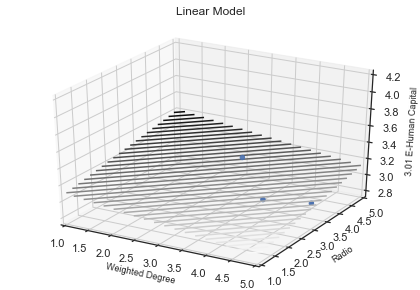




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Weighted Degree, Camino más corto promedio
Predicted: 3.01 E-Human Capital
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.9747072366053596, p-value: [[0.0017472  0.00035288]]
Regression Coefficients: [-0.06849674  0.0761532 ]
Intercept: 3.042626513475242


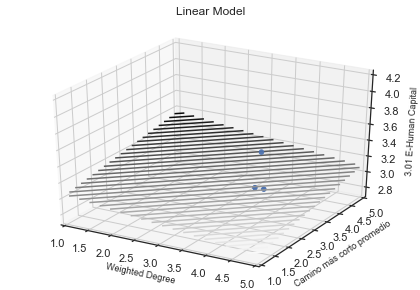




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Weighted Degree, Transitividad
Predicted: 3.01 E-Human Capital
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.9545005898841088, p-value: [[0.00569633 0.00122255]]
Regression Coefficients: [-0.06926779  0.0755599 ]
Intercept: 3.0632642546674416


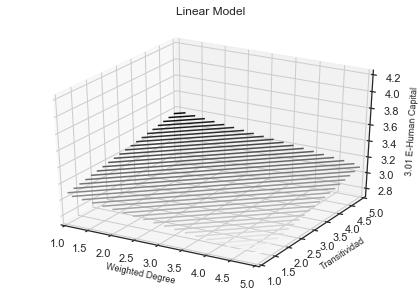




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Weighted Degree, Eficiencia Global
Predicted: 3.01 E-Human Capital
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.9541807661227469, p-value: [[0.00572554 0.00124049]]
Regression Coefficients: [-0.06939902  0.07553163]
Intercept: 3.065530120761944


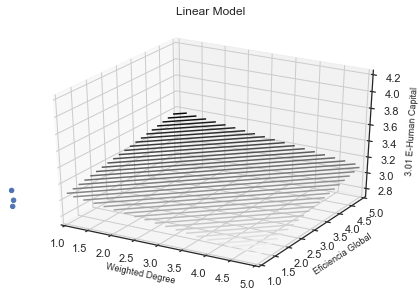




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Weighted Degree, Small Worldness
Predicted: 3.01 E-Human Capital
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.9505139438255712, p-value: [[0.00732491 0.00145297]]
Regression Coefficients: [-0.06726489  0.07527117]
Intercept: 3.0430430102186987


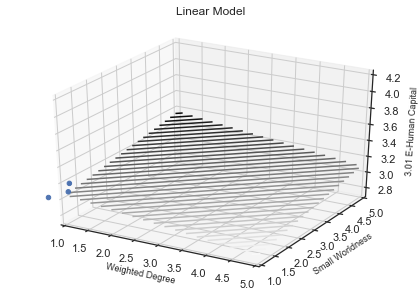




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Weighted Degree, Rich Club Coefficient
Predicted: 3.01 E-Human Capital
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.9312189926419703, p-value: [[0.01271803 0.00283723]]
Regression Coefficients: [-0.06728844  0.07390327]
Intercept: 3.0676986048618318


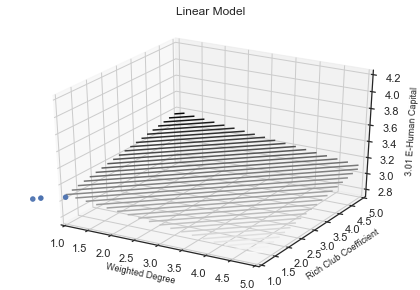




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Weighted Degree, Core Ratio
Predicted: 3.01 E-Human Capital
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.9545415343539797, p-value: [[0.00573129 0.00121916]]
Regression Coefficients: [-0.06910601  0.07558023]
Intercept: 3.0607048417796188


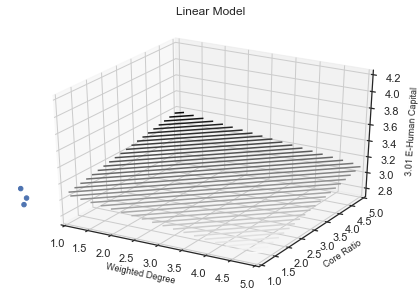




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Weighted Degree, Central Point Dominance
Predicted: 3.01 E-Human Capital
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.95037096155766, p-value: [[0.00660304 0.00146485]]
Regression Coefficients: [-0.06935271  0.07519798]
Intercept: 3.071594115554616


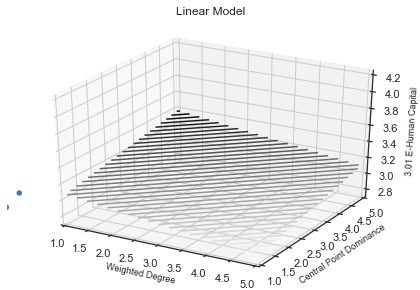




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Weighted Degree, Spectral radius
Predicted: 3.01 E-Human Capital
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.9590225828685598, p-value: [[0.00459145 0.00097456]]
Regression Coefficients: [-0.06914802  0.07579257]
Intercept: 3.0577694308285657


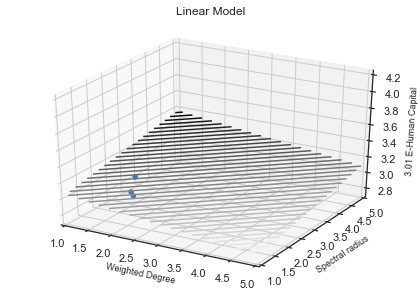




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Weighted Degree, Modularidad
Predicted: 3.01 E-Human Capital
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.9607212504542944, p-value: [[0.00413368 0.00090584]]
Regression Coefficients: [-0.07020439  0.0758607 ]
Intercept: 3.0701911645443984


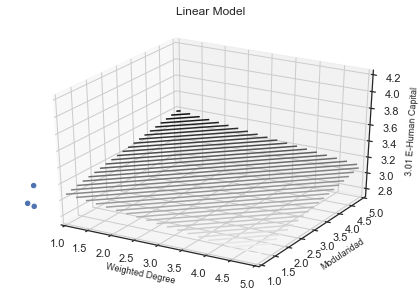




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Weighted Degree, Average collabs
Predicted: 3.01 E-Human Capital
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.9112502357652306, p-value: [[0.0003737  0.00279076]]
Regression Coefficients: [0.15651446 0.07582223]
Intercept: 0.12466004617881987


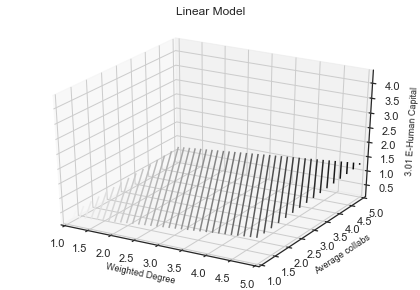




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Weighted Degree, Colab 1
Predicted: 3.01 E-Human Capital
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.9505090915882237, p-value: [[0.00688709 0.00144843]]
Regression Coefficients: [-0.06839752  0.07531207]
Intercept: 3.056446207474632


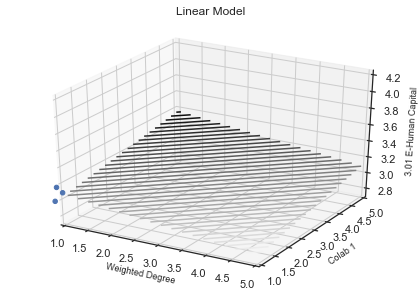




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Weighted Degree, Colab 2
Predicted: 3.01 E-Human Capital
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.9443699028828767, p-value: [[0.00868681 0.00183646]]
Regression Coefficients: [-0.06790222  0.07492123]
Intercept: 3.0567347748234814


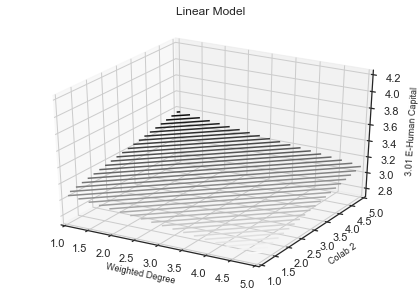




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Weighted Degree, Colab 3
Predicted: 3.01 E-Human Capital
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.9523647148334468, p-value: [[0.00627252 0.00134248]]
Regression Coefficients: [-0.06898236  0.07542722]
Intercept: 3.0619798061999295


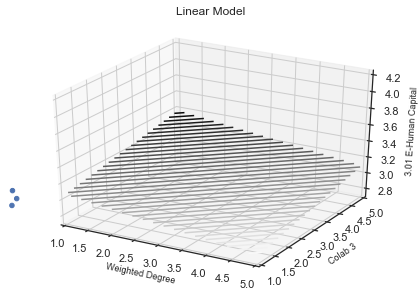




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Weighted Degree, Colab 4
Predicted: 3.01 E-Human Capital
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.9528031480810657, p-value: [[0.00615737 0.00131704]]
Regression Coefficients: [-0.06902707  0.07545997]
Intercept: 3.0619154656638856


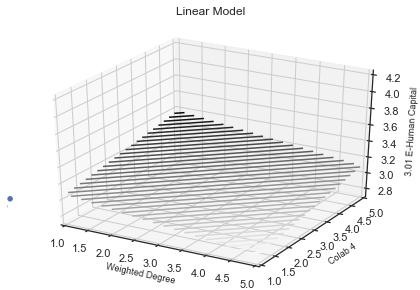




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Weighted Degree, Colab 5
Predicted: 3.01 E-Human Capital
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.9542138909016352, p-value: [[0.00578201 0.00123566]]
Regression Coefficients: [-0.06905218  0.07552124]
Intercept: 3.0613529819569125


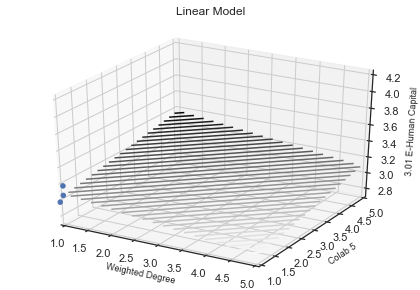




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Weighted Degree, Colab 6
Predicted: 3.01 E-Human Capital
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.9534703129637306, p-value: [[0.00597375 0.00127967]]
Regression Coefficients: [-0.06912122  0.07549774]
Intercept: 3.0624907798699414


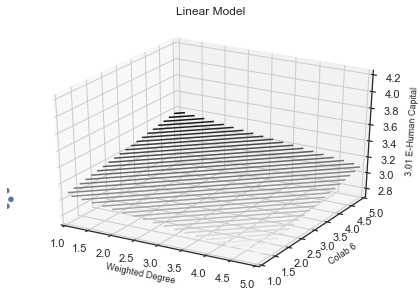




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Excentricidad, weight
Predicted: 4 Comparative Advantage
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.9726210357735132, p-value: [[0.00027898 0.00042031]]
Regression Coefficients: [ 0.18191949 -0.16396279]
Intercept: 2.731862946983533


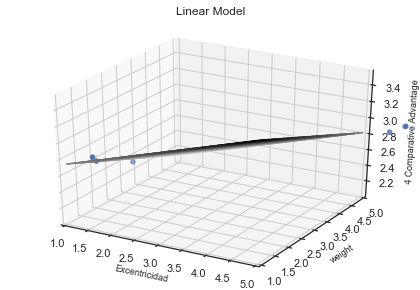




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Excentricidad, Degree
Predicted: 2.04 I-Demand
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8805941026331736, p-value: [[0.04646008 0.00307083]]
Regression Coefficients: [ 0.05634178 -0.11078945]
Intercept: 3.2025533119043543


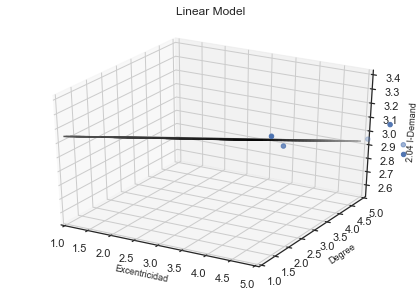




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Excentricidad, Degree
Predicted: 2.05 I-Culture & Incentives
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8787573825841564, p-value: [[0.02599202 0.00261068]]
Regression Coefficients: [-0.29543499 -0.50072789]
Intercept: 6.364352598125707


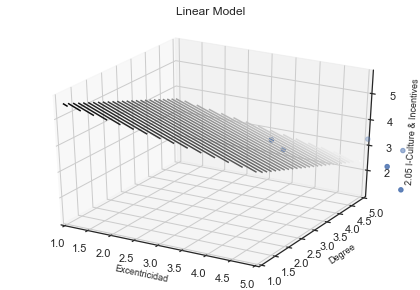




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Excentricidad, Degree
Predicted: 4 Comparative Advantage
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.9229978990570613, p-value: [[0.00166053 0.00305406]]
Regression Coefficients: [ 0.13157882 -0.09794676]
Intercept: 2.677236580092271


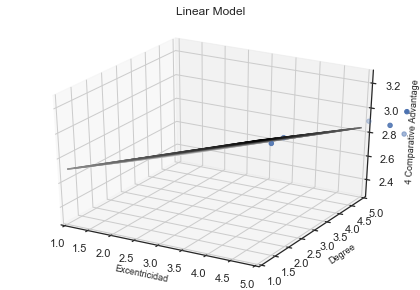




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Excentricidad, Weighted Degree
Predicted: 2.05 I-Culture & Incentives
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8999811165611383, p-value: [[0.0010482  0.00498823]]
Regression Coefficients: [ 0.29772697 -0.14720956]
Intercept: 1.2138574508588587


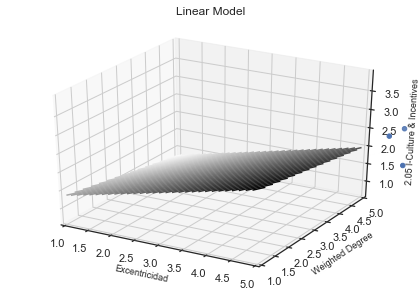




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Excentricidad, Weighted Degree
Predicted: 3.04 E-Demand
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.809088537412606, p-value: [[0.01609423 0.01424444]]
Regression Coefficients: [ 0.05718482 -0.04452803]
Intercept: 3.194379214524713


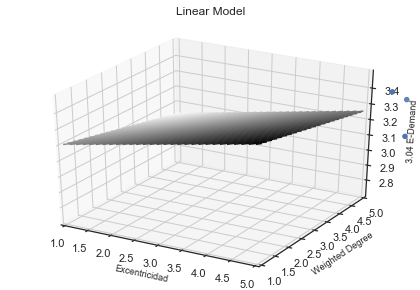




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Excentricidad, Average collabs
Predicted: 2.01 I-Human Capital
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8499231940963551, p-value: [[0.00785208 0.00927807]]
Regression Coefficients: [ 0.22211381 -0.21289604]
Intercept: 2.1960870371101584


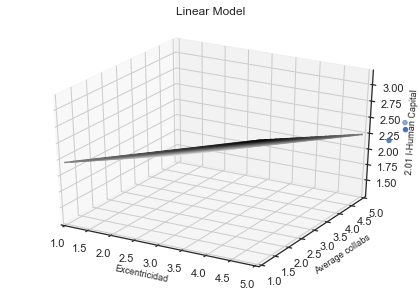




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Excentricidad, Average collabs
Predicted: 3.02 E-Funding
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.876570485128531, p-value: [[0.00477511 0.00672334]]
Regression Coefficients: [ 0.14023445 -0.12817144]
Intercept: 1.978392874018624


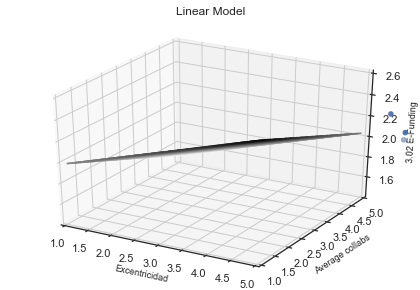




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Excentricidad, Colab 1
Predicted: 4 Comparative Advantage
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8154666286880514, p-value: [[0.01388056 0.02639989]]
Regression Coefficients: [ 0.18650564 -0.15748416]
Intercept: 2.6725157570227656


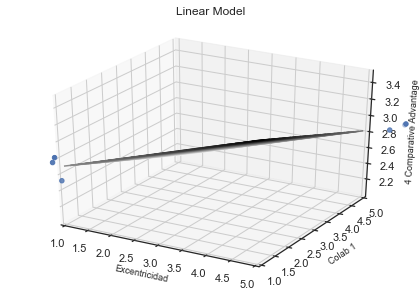




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Excentricidad, Colab 2
Predicted: 4 Comparative Advantage
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.870558299898748, p-value: [[0.00708053 0.01209089]]
Regression Coefficients: [ 0.18539432 -0.16378896]
Intercept: 2.7120160412529435


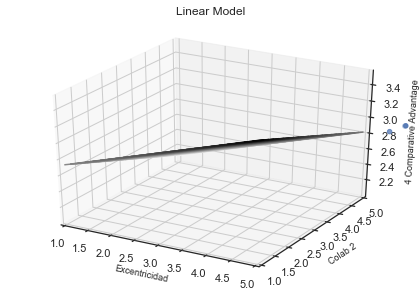




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Clustering, weight
Predicted: 2.05 I-Culture & Incentives
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8238314423972147, p-value: [[0.00930144 0.01602612]]
Regression Coefficients: [ 2.24151487 -1.38608804]
Intercept: 1.9818909663703503


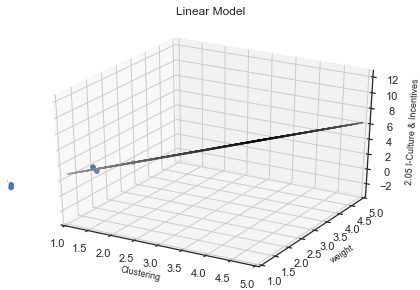




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Clustering, Degree
Predicted: 2.05 I-Culture & Incentives
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8984686796425173, p-value: [[0.00320584 0.00506919]]
Regression Coefficients: [ 0.88136156 -0.53813295]
Intercept: 2.0405539158487556


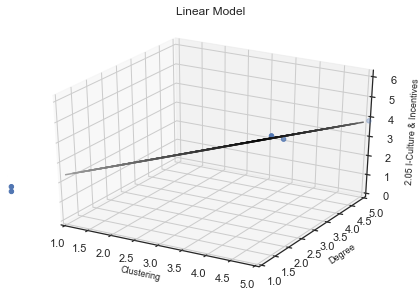




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Clustering, Weighted Degree
Predicted: 2.05 I-Culture & Incentives
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8891201173326617, p-value: [[0.00399021 0.00625143]]
Regression Coefficients: [ 0.24190477 -0.15406204]
Intercept: 2.073500924973903


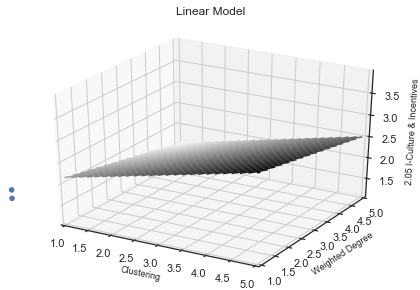




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Clustering, Excentricidad
Predicted: 2.05 I-Culture & Incentives
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.811305871213283, p-value: [[0.0268455  0.01520431]]
Regression Coefficients: [-0.60583811  0.74395971]
Intercept: 2.012224104433783


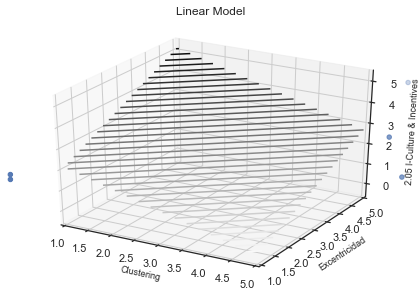




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Clustering, Diámetro
Predicted: 2.05 I-Culture & Incentives
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8113797484248978, p-value: [[0.02319155 0.01434044]]
Regression Coefficients: [-0.52247152  0.63279202]
Intercept: 2.0328442514825698


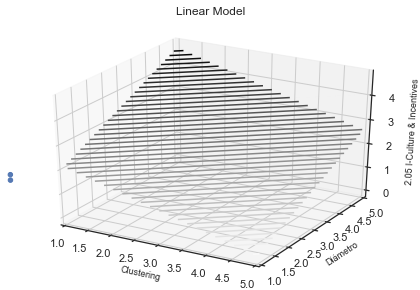




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Clustering, Radio
Predicted: 2.05 I-Culture & Incentives
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8500516609773049, p-value: [[0.01474439 0.00743343]]
Regression Coefficients: [-0.69580628  1.02633307]
Intercept: 1.9532599350417656


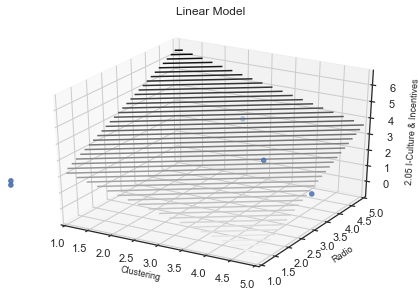




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Clustering, Spectral radius
Predicted: 2.04 I-Demand
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.9410116546749928, p-value: [[0.0008398  0.00075724]]
Regression Coefficients: [-2.18905803  2.27043078]
Intercept: 2.753545373096409


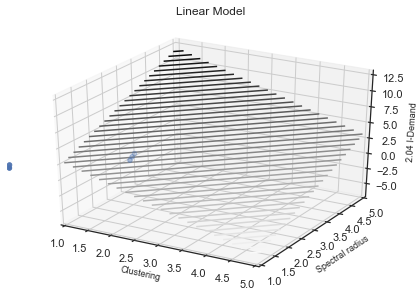




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Clustering, Spectral radius
Predicted: 2.05 I-Culture & Incentives
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8588523605923377, p-value: [[0.00675632 0.00489318]]
Regression Coefficients: [-8.30468693  9.17250653]
Intercept: 1.2361939460355873


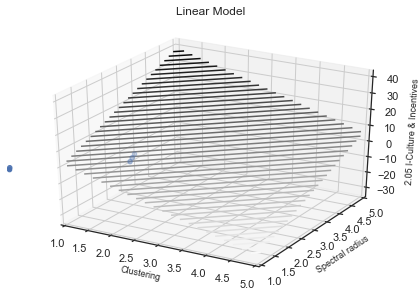




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Clustering, Modularidad
Predicted: 2.04 I-Demand
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.83770919366901, p-value: [[0.01316558 0.0074139 ]]
Regression Coefficients: [-1.17181478  1.41729596]
Intercept: 2.7801555105624707


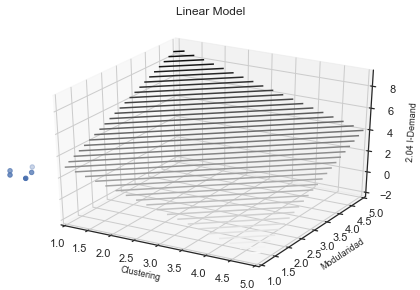




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Clustering, Modularidad
Predicted: 2.05 I-Culture & Incentives
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.905616479293486, p-value: [[0.03617334 0.00158089]]
Regression Coefficients: [-2.80026791  7.06511895]
Intercept: 0.5489250783611657


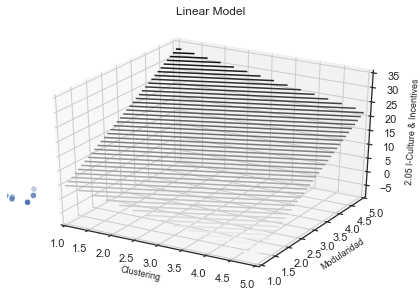




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Clustering, Colab 0
Predicted: 2.05 I-Culture & Incentives
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8343550218668043, p-value: [[0.00924208 0.01680626]]
Regression Coefficients: [ 0.26854489 -0.16171489]
Intercept: 2.1055950720374823


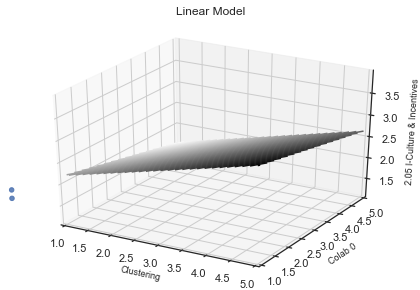




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Diámetro, weight
Predicted: 4 Comparative Advantage
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.9520524766700114, p-value: [[0.00091512 0.00146712]]
Regression Coefficients: [ 0.15048909 -0.13636365]
Intercept: 2.7268059039988097


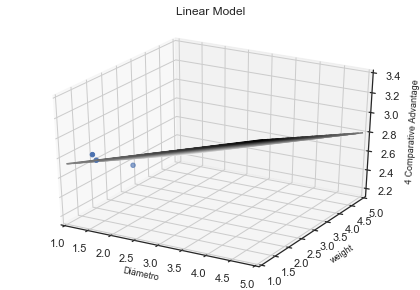




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Diámetro, Degree
Predicted: 2.04 I-Demand
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8751596140973867, p-value: [[0.01711542 0.00313892]]
Regression Coefficients: [ 0.07019207 -0.10462028]
Intercept: 3.12505155960744


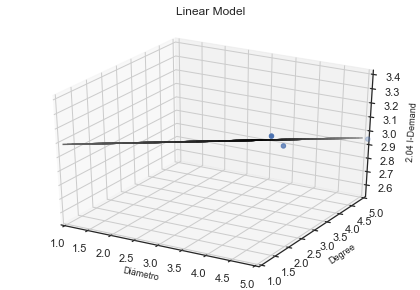




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Diámetro, Degree
Predicted: 4 Comparative Advantage
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.9595507582738387, p-value: [[0.00059228 0.00076782]]
Regression Coefficients: [ 0.11027825 -0.09498991]
Intercept: 2.746611292144119


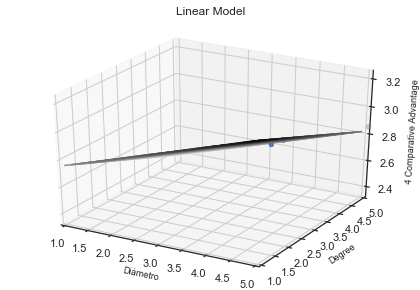




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Diámetro, Weighted Degree
Predicted: 2.05 I-Culture & Incentives
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8581901969194264, p-value: [[0.00143522 0.01045432]]
Regression Coefficients: [ 0.31116545 -0.13851816]
Intercept: 0.8611233619586669


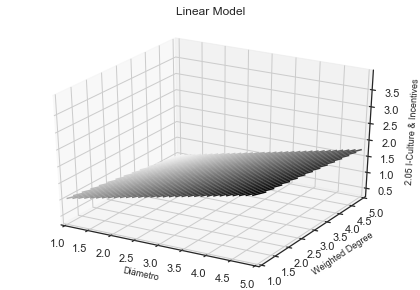




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Diámetro, Average collabs
Predicted: 2.01 I-Human Capital
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8044347179250917, p-value: [[0.01307898 0.01656725]]
Regression Coefficients: [ 0.20107617 -0.18942984]
Intercept: 2.161410535580581


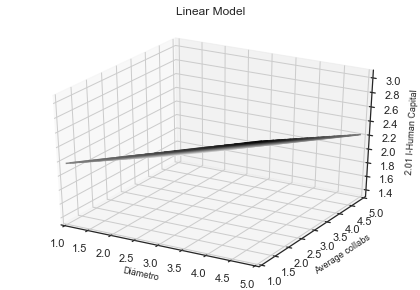




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Diámetro, Average collabs
Predicted: 3.02 E-Funding
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8949140955761555, p-value: [[0.00315544 0.00523716]]
Regression Coefficients: [ 0.13314452 -0.11717371]
Intercept: 1.9284019643760495


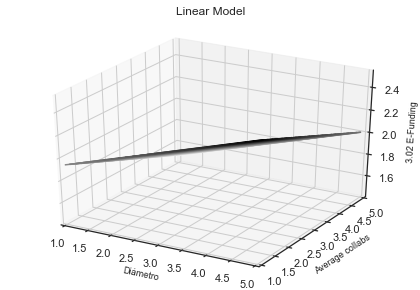




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Diámetro, Colab 1
Predicted: 4 Comparative Advantage
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8033738454466451, p-value: [[0.01757357 0.03363838]]
Regression Coefficients: [ 0.1480062  -0.12597198]
Intercept: 2.67669123211822


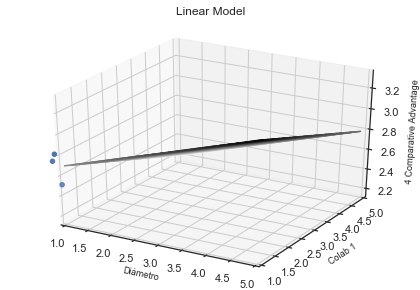




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Diámetro, Colab 2
Predicted: 4 Comparative Advantage
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8517232767825911, p-value: [[0.01006065 0.01774782]]
Regression Coefficients: [ 0.1491818  -0.13192004]
Intercept: 2.7076169224909594


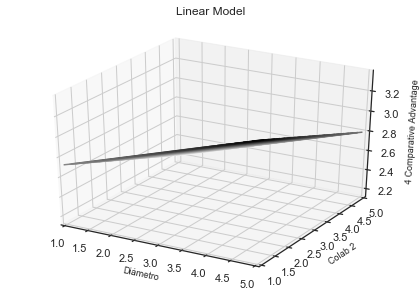




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Radio, avg strength
Predicted: 3.01 E-Human Capital
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.959907514434251, p-value: [[3.26106991e-05 9.19857802e-05]]
Regression Coefficients: [0.8775418 0.7674175]
Intercept: -2.5645459069659524


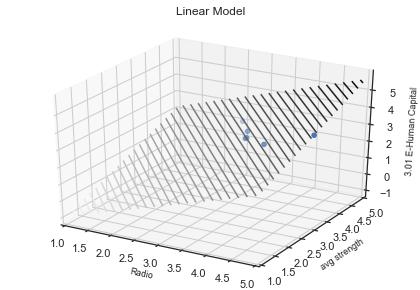




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Radio, weight
Predicted: 4 Comparative Advantage
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.9922748170629223, p-value: [[2.27146340e-05 2.66830478e-05]]
Regression Coefficients: [ 0.18198355 -0.19411145]
Intercept: 2.7891959676591114


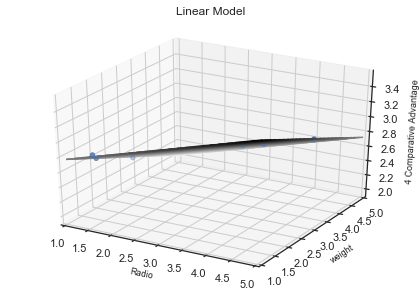




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Radio, Degree
Predicted: 4 Comparative Advantage
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.9909702156131893, p-value: [[3.17041709e-06 1.11781511e-04]]
Regression Coefficients: [ 0.22229227 -0.07847981]
Intercept: 2.2467093213400577


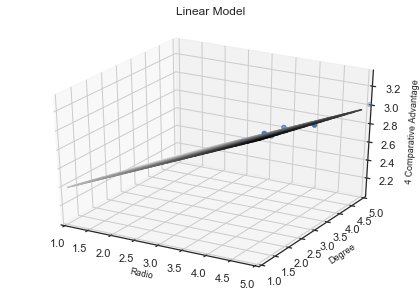




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Radio, Weighted Degree
Predicted: 2.05 I-Culture & Incentives
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8791559728936014, p-value: [[0.00212931 0.00720164]]
Regression Coefficients: [ 0.27476161 -0.14614763]
Intercept: 1.4884102247206887


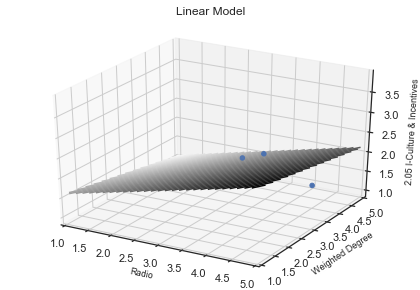




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Radio, Camino más corto promedio
Predicted: 3.01 E-Human Capital
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.881083964875237, p-value: [[0.00012217 0.00071116]]
Regression Coefficients: [0.91304633 0.64123432]
Intercept: -2.4339424381627874


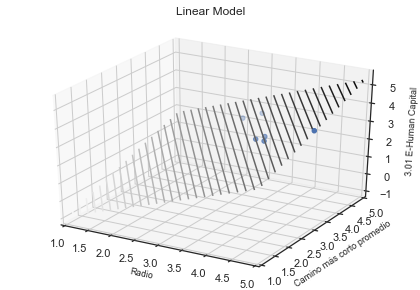




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Radio, Average collabs
Predicted: 2.01 I-Human Capital
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8792362811509493, p-value: [[0.00406291 0.00570926]]
Regression Coefficients: [ 0.23956347 -0.2215991 ]
Intercept: 2.083174770546441


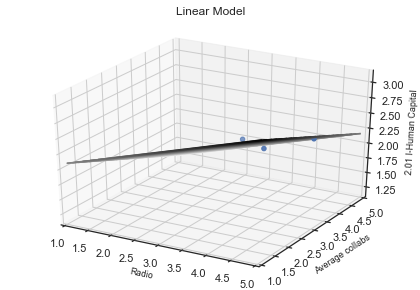




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Radio, Average collabs
Predicted: 3.02 E-Funding
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8230247813667088, p-value: [[0.00857753 0.01379836]]
Regression Coefficients: [ 0.14265495 -0.12624074]
Intercept: 1.9257862651912276


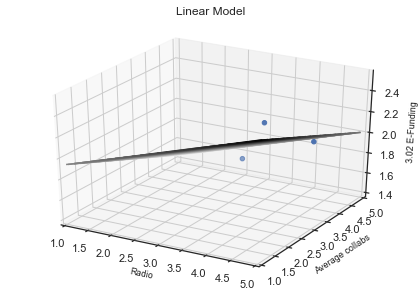




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Radio, Colab 1
Predicted: 4 Comparative Advantage
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8287454851646636, p-value: [[0.01266989 0.0290955 ]]
Regression Coefficients: [ 0.19573686 -0.18098755]
Intercept: 2.6901153422017


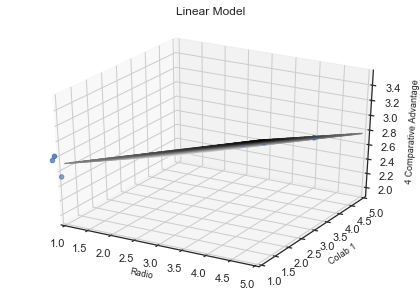




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Radio, Colab 2
Predicted: 4 Comparative Advantage
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8897091645748358, p-value: [[0.00530913 0.01150802]]
Regression Coefficients: [ 0.19667397 -0.19083365]
Intercept: 2.7189865482124005


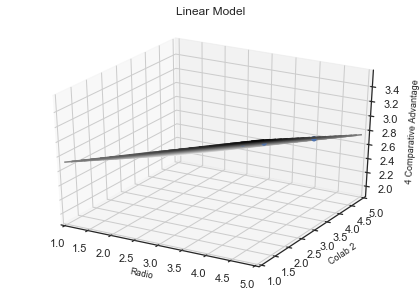




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Camino más corto promedio, weight
Predicted: 2.04 I-Demand
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8366644922623152, p-value: [[0.01233459 0.00887775]]
Regression Coefficients: [ 0.22129253 -0.2297669 ]
Intercept: 2.9522286938147033


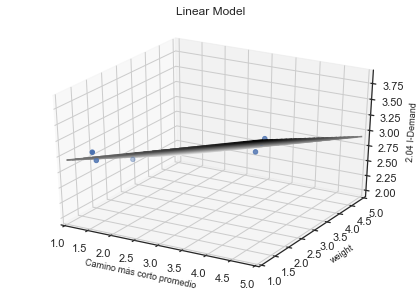




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Camino más corto promedio, weight
Predicted: 4 Comparative Advantage
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.9654120880911189, p-value: [[0.00043602 0.00060519]]
Regression Coefficients: [ 0.2759129  -0.23934217]
Intercept: 2.736194895239015


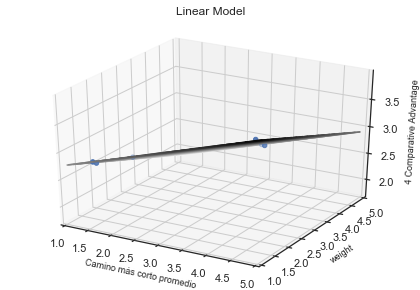




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Camino más corto promedio, Degree
Predicted: 2.04 I-Demand
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.9382604046563984, p-value: [[3.56752994e-05 2.35941485e-03]]
Regression Coefficients: [ 0.37028516 -0.10046823]
Intercept: 1.9529020063940872


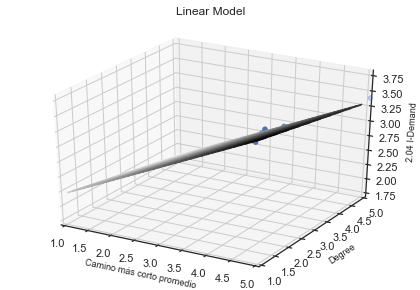




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Camino más corto promedio, Degree
Predicted: 3.02 E-Funding
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.9630514002457221, p-value: [[8.41868749e-07 1.51762906e-02]]
Regression Coefficients: [ 0.88069812 -0.05539448]
Intercept: -0.9121313581789017


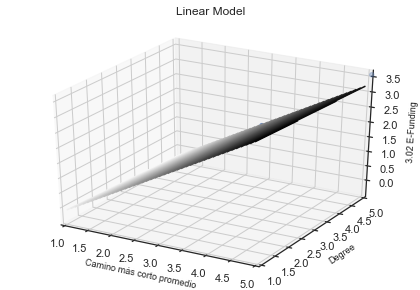




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Camino más corto promedio, Degree
Predicted: 4 Comparative Advantage
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8221355557358668, p-value: [[0.00046843 0.01828707]]
Regression Coefficients: [ 0.35903365 -0.10517442]
Intercept: 1.9101894380377995


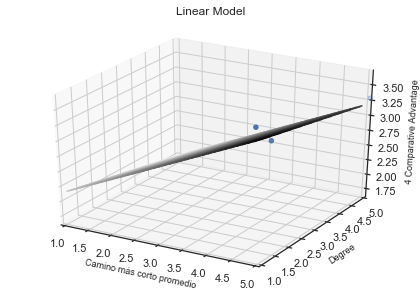




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Camino más corto promedio, Weighted Degree
Predicted: 2.05 I-Culture & Incentives
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.922565491109057, p-value: [[0.00109866 0.00303622]]
Regression Coefficients: [ 0.27465629 -0.15377206]
Intercept: 1.6406521142959452


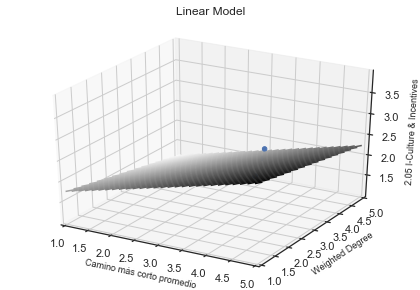




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Camino más corto promedio, Weighted Degree
Predicted: 3.04 E-Demand
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.825786664765931, p-value: [[0.01744989 0.01226932]]
Regression Coefficients: [ 0.05658404 -0.04608419]
Intercept: 3.233035576136477


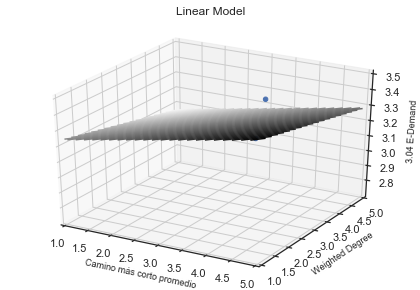




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Camino más corto promedio, Rich Club Coefficient
Predicted: 3.02 E-Funding
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.903684705250969, p-value: [[0.004298   0.00357554]]
Regression Coefficients: [ 0.30899681 -0.32572496]
Intercept: 2.1265053508111587


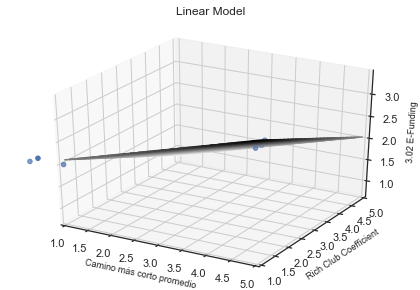




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Camino más corto promedio, Average collabs
Predicted: 2.01 I-Human Capital
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8844576435824263, p-value: [[0.00517189 0.00529682]]
Regression Coefficients: [ 0.25485077 -0.25318932]
Intercept: 2.2876225420980165


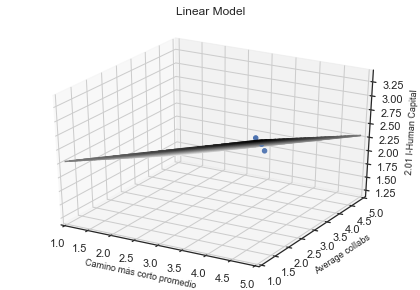




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Camino más corto promedio, Colab 0
Predicted: 2.05 I-Culture & Incentives
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8371155890541611, p-value: [[0.00405039 0.02084346]]
Regression Coefficients: [ 0.31667503 -0.14749064]
Intercept: 1.5303334456574302


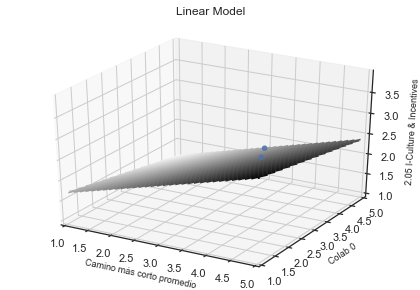




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Camino más corto promedio, Colab 1
Predicted: 4 Comparative Advantage
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.838845028503084, p-value: [[0.01067348 0.01968626]]
Regression Coefficients: [ 0.33252452 -0.27527658]
Intercept: 2.658082890160734


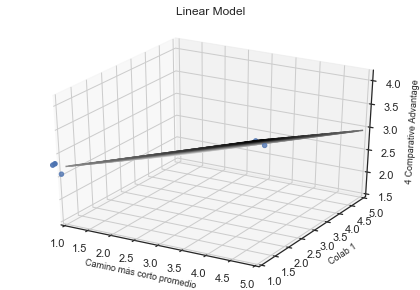




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Camino más corto promedio, Colab 2
Predicted: 3.02 E-Funding
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8409808621403176, p-value: [[0.01294712 0.00904357]]
Regression Coefficients: [ 0.31889322 -0.35232834]
Intercept: 2.190410197820341


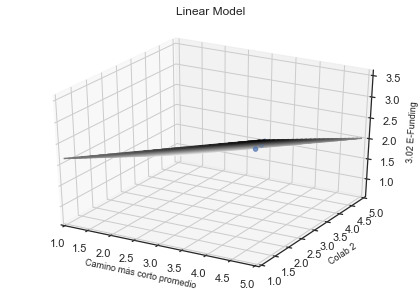




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Camino más corto promedio, Colab 2
Predicted: 4 Comparative Advantage
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.9052420433454493, p-value: [[0.00386263 0.00596447]]
Regression Coefficients: [ 0.31706556 -0.2800279 ]
Intercept: 2.731118698127771


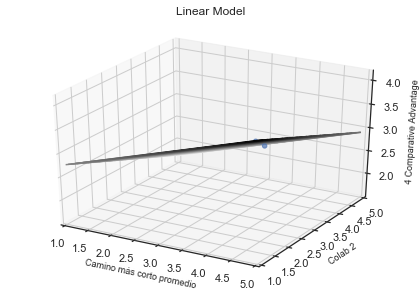




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Transitividad, avg strength
Predicted: 2.01 I-Human Capital
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8331959543251881, p-value: [[0.00880801 0.00809614]]
Regression Coefficients: [-3.13552041  3.37343915]
Intercept: 2.078706672278131


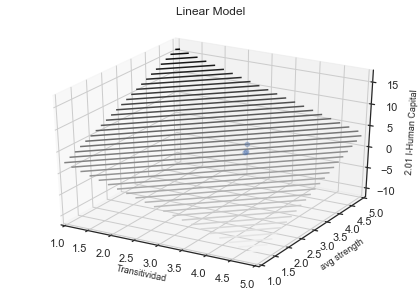




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Transitividad, weight
Predicted: 2.05 I-Culture & Incentives
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8631698706869952, p-value: [[0.00639134 0.00951885]]
Regression Coefficients: [ 2.20511445 -1.42241567]
Intercept: 2.1126907593046997


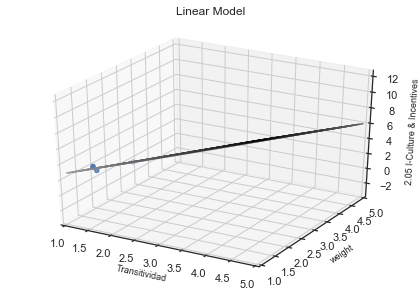




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Transitividad, Degree
Predicted: 2.05 I-Culture & Incentives
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.9125809057650868, p-value: [[0.00250813 0.00374732]]
Regression Coefficients: [ 0.87440212 -0.54252447]
Intercept: 2.0931154391107727


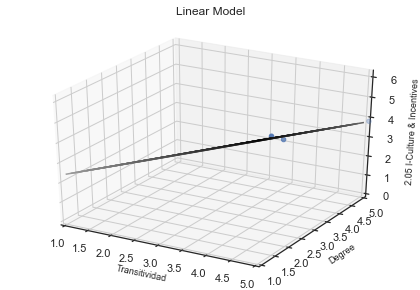




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Transitividad, Weighted Degree
Predicted: 2.05 I-Culture & Incentives
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8927954397790925, p-value: [[0.00377937 0.00583678]]
Regression Coefficients: [ 0.24142183 -0.15441517]
Intercept: 2.086711132238502


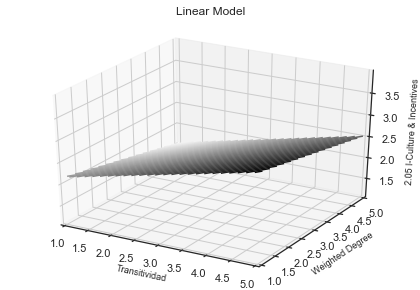




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Transitividad, Weighted Degree
Predicted: 3.04 E-Demand
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8016530542868104, p-value: [[0.02956037 0.0165894 ]]
Regression Coefficients: [ 0.0531776  -0.04589195]
Intercept: 3.2744312785972065


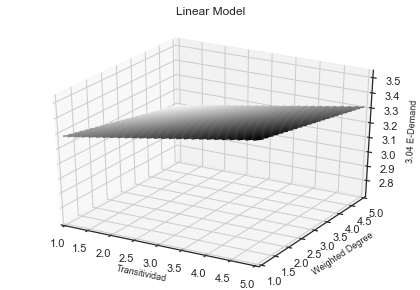




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Transitividad, Excentricidad
Predicted: 2.05 I-Culture & Incentives
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8018453680499442, p-value: [[0.02921634 0.01705716]]
Regression Coefficients: [-0.60427094  0.73684157]
Intercept: 2.0428531421122593


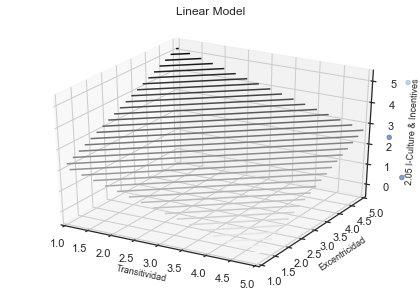




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Transitividad, Clustering
Predicted: 3.05 E-Culture & Incentives
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8442034535746737, p-value: [[0.01029911 0.00692065]]
Regression Coefficients: [-4.49516616  3.82225172]
Intercept: 2.965989519421235


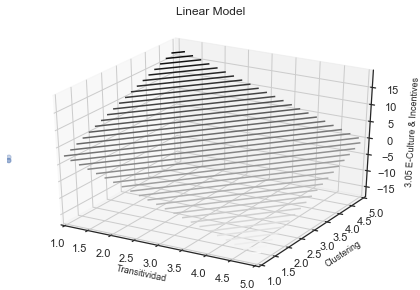




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Transitividad, Diámetro
Predicted: 2.05 I-Culture & Incentives
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8035304895298322, p-value: [[0.02501225 0.01581698]]
Regression Coefficients: [-0.52077563  0.62745077]
Intercept: 2.057646097226591


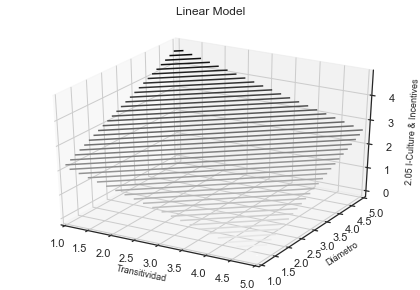




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Transitividad, Radio
Predicted: 2.05 I-Culture & Incentives
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8396508172060778, p-value: [[0.01654538 0.00905791]]
Regression Coefficients: [-0.69612308  1.00655414]
Intercept: 2.021953140738787


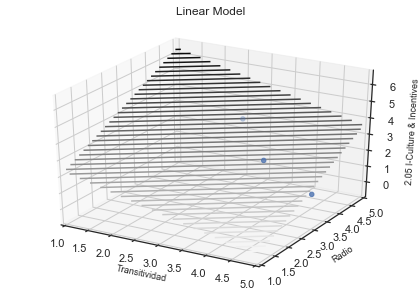




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Transitividad, Eficiencia Global
Predicted: 2.02 I-Funding
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8699070938551888, p-value: [[0.00658991 0.00739766]]
Regression Coefficients: [ 3.38927628 -2.95513563]
Intercept: 1.651478772597295


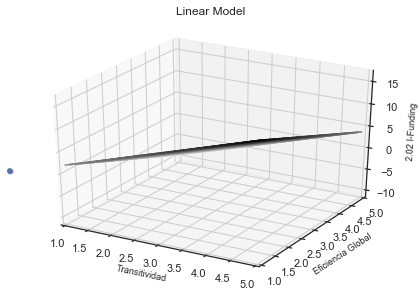




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Transitividad, Small Worldness
Predicted: 3.05 E-Culture & Incentives
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8755695928315677, p-value: [[0.0057789  0.00573151]]
Regression Coefficients: [-2.27978113  1.83770994]
Intercept: 3.0459925798051777


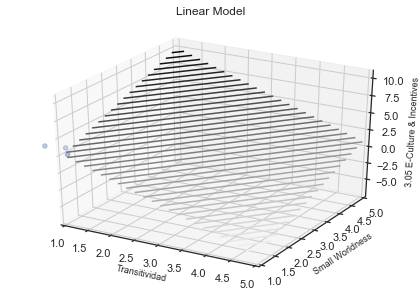




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Transitividad, Core Ratio
Predicted: 2.02 I-Funding
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.9203695426898337, p-value: [[0.00251417 0.00295461]]
Regression Coefficients: [ 3.92965232 -3.16930868]
Intercept: 1.6342055306490821


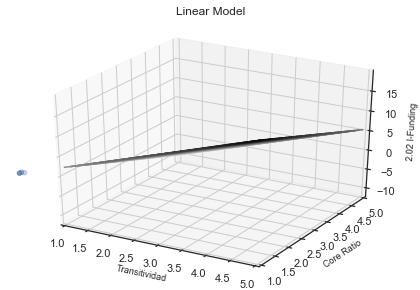




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Transitividad, Central Point Dominance
Predicted: 3.05 E-Culture & Incentives
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.9350367816625526, p-value: [[0.00194417 0.00034957]]
Regression Coefficients: [-1.9886017   4.03627081]
Intercept: 2.7539318540404865


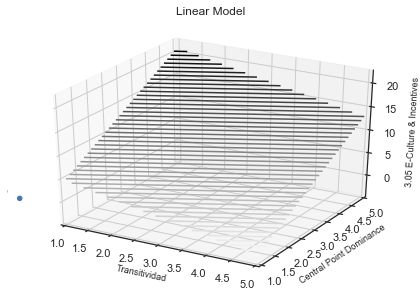




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Transitividad, Spectral radius
Predicted: 4 Comparative Advantage
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8487565760723835, p-value: [[0.00914135 0.0095915 ]]
Regression Coefficients: [-2.0495795   2.04740956]
Intercept: 2.752524684564583


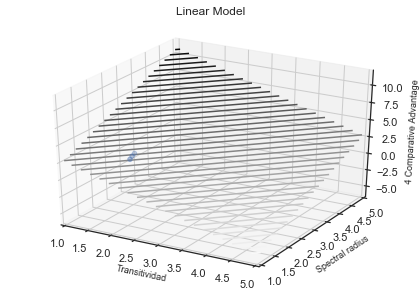




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Transitividad, Colab 0
Predicted: 2.05 I-Culture & Incentives
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8393386422252143, p-value: [[0.00883791 0.01571926]]
Regression Coefficients: [ 0.26791119 -0.16249586]
Intercept: 2.1210823501453975


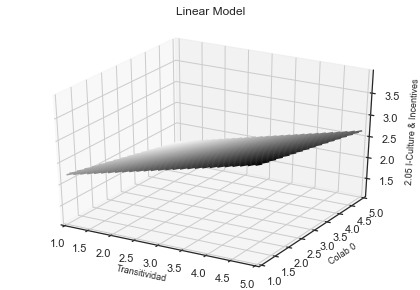




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Transitividad, Colab 5
Predicted: 2.02 I-Funding
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.9190621865738129, p-value: [[0.00254628 0.00279567]]
Regression Coefficients: [ 2.98529259 -2.86867808]
Intercept: 1.6655725841439364


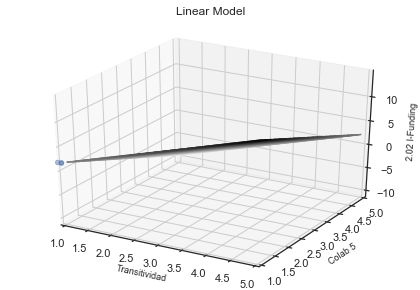




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Eficiencia Global, avg strength
Predicted: 2.01 I-Human Capital
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8093408861613127, p-value: [[0.01436707 0.01375716]]
Regression Coefficients: [-3.19869213  3.4033563 ]
Intercept: 2.199408597613395


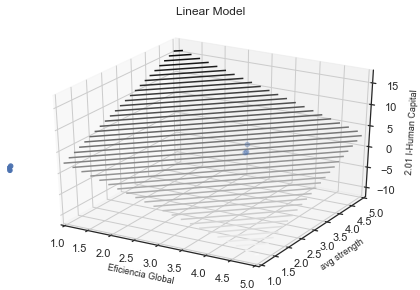




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Eficiencia Global, weight
Predicted: 2.05 I-Culture & Incentives
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8535149226955467, p-value: [[0.00500768 0.01111907]]
Regression Coefficients: [ 2.40420137 -1.40150339]
Intercept: 1.7948485543961425


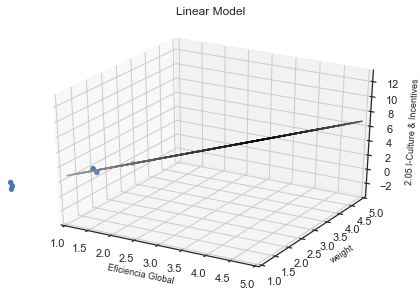




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Eficiencia Global, Degree
Predicted: 2.05 I-Culture & Incentives
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.9092768042106393, p-value: [[0.00237326 0.00404504]]
Regression Coefficients: [ 0.9014766  -0.54066644]
Intercept: 1.9809190744825764


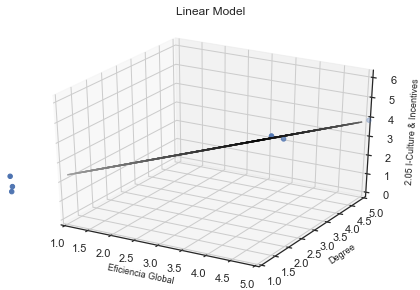




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Eficiencia Global, Weighted Degree
Predicted: 2.05 I-Culture & Incentives
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8919260001616031, p-value: [[0.003724   0.00594817]]
Regression Coefficients: [ 0.24332998 -0.15421752]
Intercept: 2.058293212450714


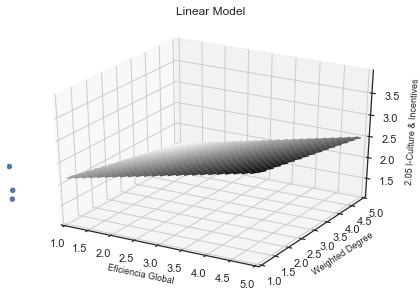




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Eficiencia Global, Excentricidad
Predicted: 2.05 I-Culture & Incentives
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.808460715038033, p-value: [[0.02724613 0.01595639]]
Regression Coefficients: [-0.6082039   0.73998232]
Intercept: 2.0484025980783


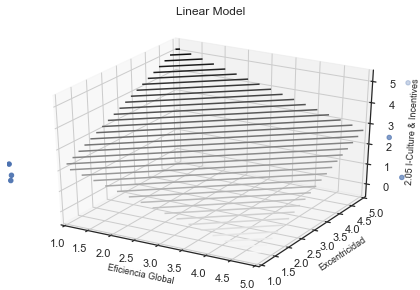




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Eficiencia Global, Diámetro
Predicted: 2.05 I-Culture & Incentives
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.809157687735021, p-value: [[0.02354063 0.01494621]]
Regression Coefficients: [-0.52354488  0.62945436]
Intercept: 2.0639063806894864


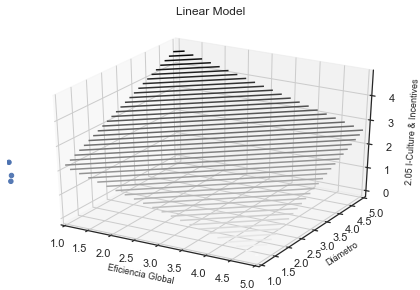




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Eficiencia Global, Radio
Predicted: 2.05 I-Culture & Incentives
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.848712853570651, p-value: [[0.01492924 0.00790175]]
Regression Coefficients: [-0.69824659  1.01697386]
Intercept: 1.996515965268214


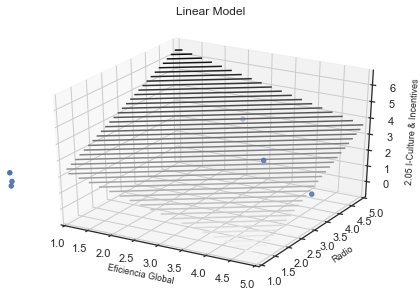




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Eficiencia Global, Spectral radius
Predicted: 2.04 I-Demand
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8628628885859698, p-value: [[0.00772933 0.00812106]]
Regression Coefficients: [-2.1565531   2.15574948]
Intercept: 2.9076390467317608


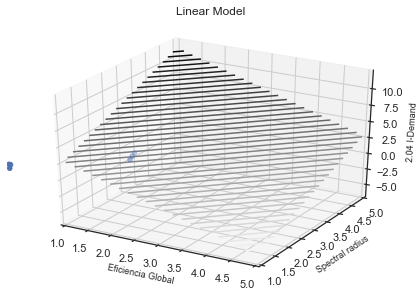




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Eficiencia Global, Spectral radius
Predicted: 4 Comparative Advantage
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8264137339316606, p-value: [[0.01646643 0.01906746]]
Regression Coefficients: [-2.13945461  2.07446111]
Intercept: 2.8728863553668056


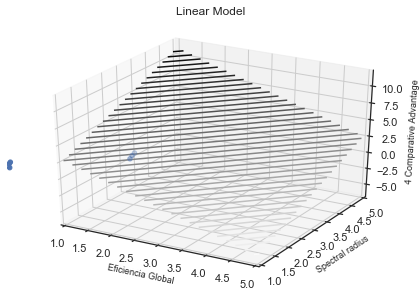




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Eficiencia Global, Modularidad
Predicted: 2.04 I-Demand
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8076975885608122, p-value: [[0.01490714 0.01576781]]
Regression Coefficients: [-1.30917103  1.36689634]
Intercept: 2.897544737034538


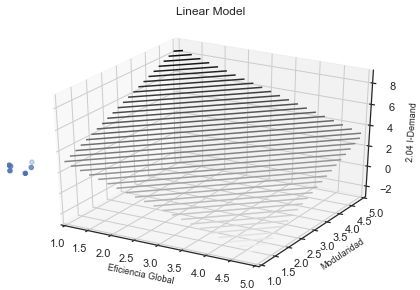




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Eficiencia Global, Modularidad
Predicted: 2.05 I-Culture & Incentives
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8967700317711551, p-value: [[0.04251715 0.00324098]]
Regression Coefficients: [-2.95322841  6.72814626]
Intercept: 0.8477058840437708


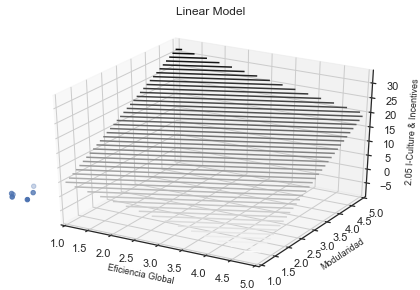




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Eficiencia Global, Colab 0
Predicted: 2.05 I-Culture & Incentives
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.836749621242742, p-value: [[0.00878832 0.01648726]]
Regression Coefficients: [ 0.2704027  -0.16146755]
Intercept: 2.0885500612411727


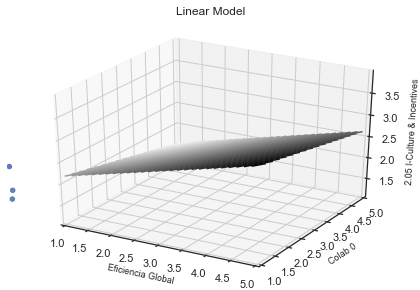




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Eficiencia Global, Colab 3
Predicted: 3.04 E-Demand
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8630236637583008, p-value: [[0.0004513 0.0008495]]
Regression Coefficients: [-5.67065254 -4.30361744]
Intercept: 6.416857037189283


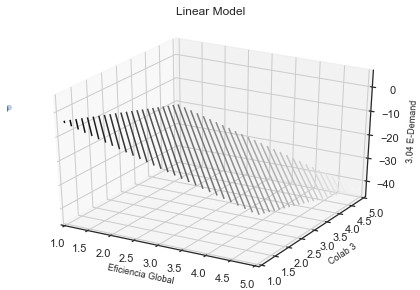




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Eficiencia Global, Colab 5
Predicted: 2.02 I-Funding
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8238251162287277, p-value: [[0.01894012 0.02795685]]
Regression Coefficients: [ 3.05866287 -2.68344835]
Intercept: 1.4170161603798697


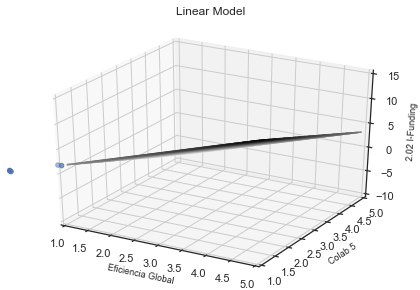




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Eficiencia Global, Colab 6
Predicted: 2.02 I-Funding
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8813618297011949, p-value: [[0.04866741 0.00161286]]
Regression Coefficients: [-1.65941002 -3.99898363]
Intercept: 3.2906374566898973


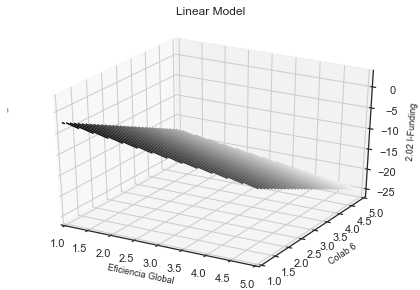




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Small Worldness, avg strength
Predicted: 2.04 I-Demand
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8631889497994693, p-value: [[0.00147836 0.00098761]]
Regression Coefficients: [-1.15581084  1.32298573]
Intercept: 2.4853903838162386


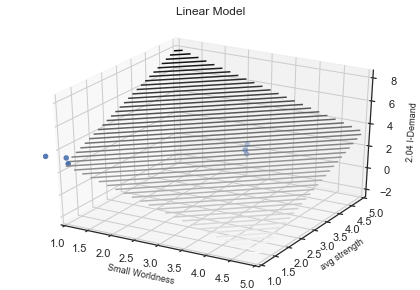




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Small Worldness, avg strength
Predicted: 3.02 E-Funding
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.9698825280824274, p-value: [[6.01444296e-05 3.29521707e-05]]
Regression Coefficients: [-1.4814759   1.77553724]
Intercept: 1.420894730107754


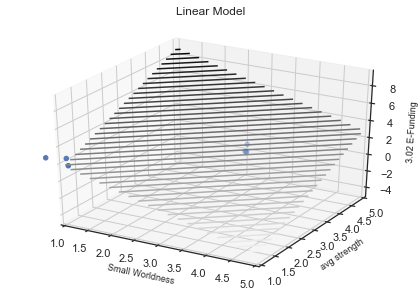




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Small Worldness, Degree
Predicted: 2.05 I-Culture & Incentives
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8404946166301474, p-value: [[0.00693297 0.01253337]]
Regression Coefficients: [ 0.88205041 -0.51826939]
Intercept: 1.9138344493583452


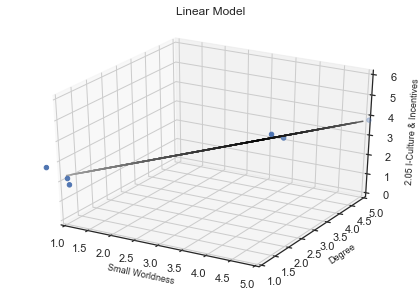




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Small Worldness, Weighted Degree
Predicted: 2.05 I-Culture & Incentives
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8767445182681608, p-value: [[0.004799  0.0077367]]
Regression Coefficients: [ 0.2422487  -0.15291055]
Intercept: 2.0457177691587956


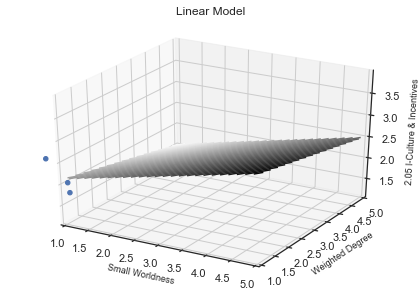




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Small Worldness, Excentricidad
Predicted: 2.05 I-Culture & Incentives
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8234453508240982, p-value: [[0.02609817 0.01160304]]
Regression Coefficients: [-0.5822681   0.76222299]
Intercept: 1.7766724826742377


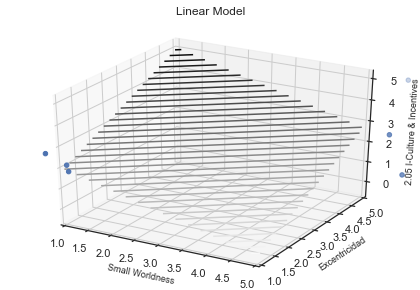




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Small Worldness, Diámetro
Predicted: 2.05 I-Culture & Incentives
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8215240343911535, p-value: [[0.02178945 0.01130166]]
Regression Coefficients: [-0.51209011  0.64932951]
Intercept: 1.8442436400280076


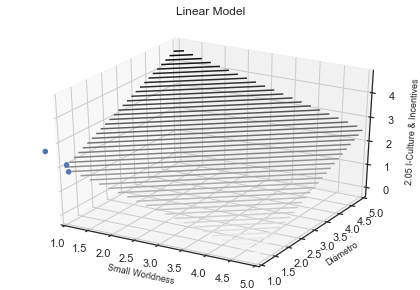




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Small Worldness, Radio
Predicted: 2.05 I-Culture & Incentives
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8487616975394463, p-value: [[0.01659076 0.00452372]]
Regression Coefficients: [-0.64907659  1.11118645]
Intercept: 1.46970960635928


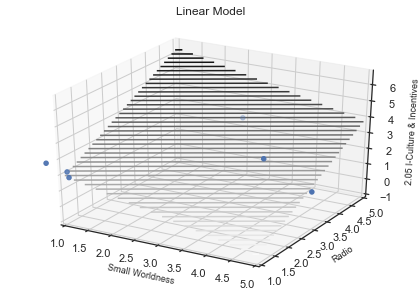




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Small Worldness, Spectral radius
Predicted: 2.04 I-Demand
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.906054186937685, p-value: [[0.00095134 0.00035637]]
Regression Coefficients: [-1.30555762  1.62725715]
Intercept: 2.279793879138868


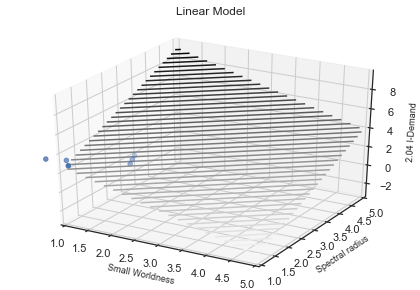




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Small Worldness, Spectral radius
Predicted: 3.02 E-Funding
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.9167937364363048, p-value: [[0.00078804 0.00020036]]
Regression Coefficients: [-1.54961406  2.13074388]
Intercept: 1.0942322352580187


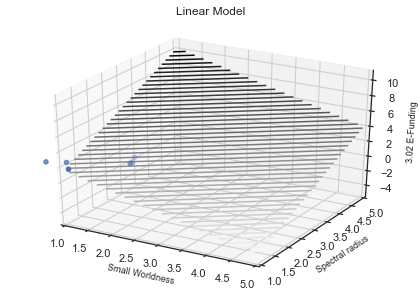




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Small Worldness, Modularidad
Predicted: 2.04 I-Demand
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8787393869513485, p-value: [[0.00267457 0.00681749]]
Regression Coefficients: [-1.18419731  0.79847625]
Intercept: 3.1015713295292127


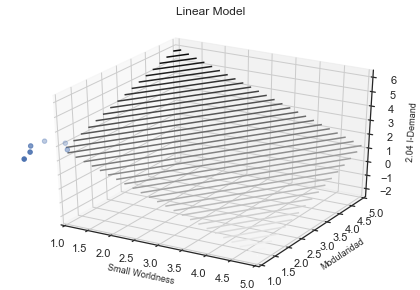




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Small Worldness, Modularidad
Predicted: 3.02 E-Funding
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.821359775861888, p-value: [[0.00404021 0.03400595]]
Regression Coefficients: [-1.5435108   0.71750767]
Intercept: 2.651383535401362


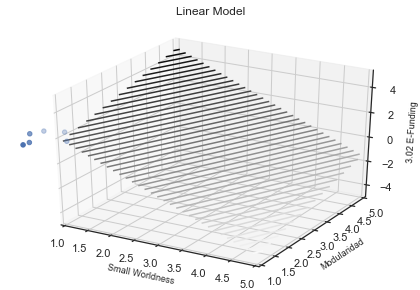




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Small Worldness, Colab 0
Predicted: 2.05 I-Culture & Incentives
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8179775942617735, p-value: [[0.01075343 0.02043987]]
Regression Coefficients: [ 0.26905461 -0.15962114]
Intercept: 2.0707490534452915


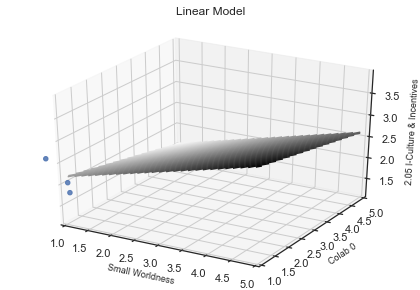




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Rich Club Coefficient, Weighted Degree
Predicted: 2.05 I-Culture & Incentives
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8418290134682848, p-value: [[0.00764856 0.01285788]]
Regression Coefficients: [ 0.23962986 -0.14889231]
Intercept: 2.0073261518685968


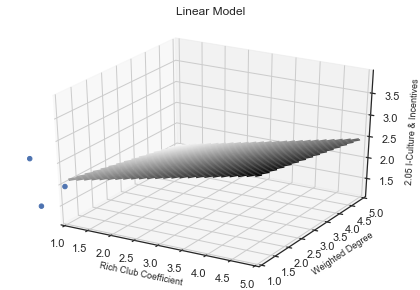




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Rich Club Coefficient, Excentricidad
Predicted: 2.04 I-Demand
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8113445829162081, p-value: [[0.01254606 0.01894926]]
Regression Coefficients: [-0.1669148   0.15233459]
Intercept: 2.9570637382639555


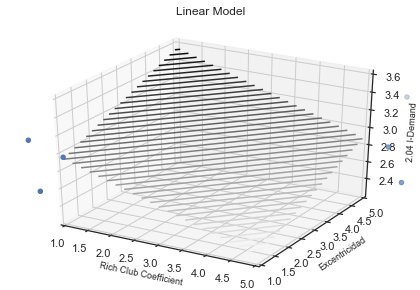




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Rich Club Coefficient, Excentricidad
Predicted: 2.05 I-Culture & Incentives
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8499995690146219, p-value: [[0.01638568 0.00943059]]
Regression Coefficients: [-0.59025368  0.71684313]
Intercept: 2.066771505074559


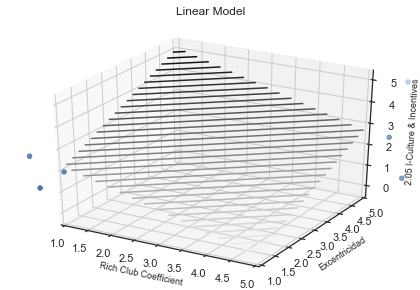




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Rich Club Coefficient, Diámetro
Predicted: 2.05 I-Culture & Incentives
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.856254014481984, p-value: [[0.01306069 0.00824899]]
Regression Coefficients: [-0.51911259  0.62095676]
Intercept: 2.08430032171868


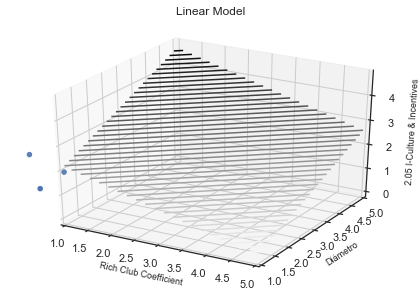




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Rich Club Coefficient, Radio
Predicted: 2.04 I-Demand
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8737975323604845, p-value: [[0.00582947 0.01026344]]
Regression Coefficients: [-0.17924262  0.18425203]
Intercept: 2.942786799690574


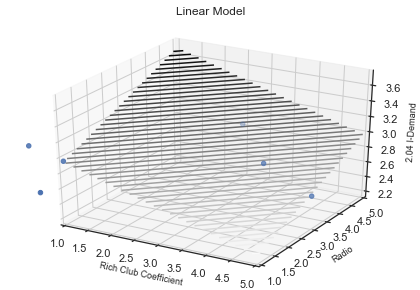




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Rich Club Coefficient, Radio
Predicted: 2.05 I-Culture & Incentives
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8627159479175077, p-value: [[0.01279748 0.00620559]]
Regression Coefficients: [-0.64113643  0.95180144]
Intercept: 1.9660349577303295


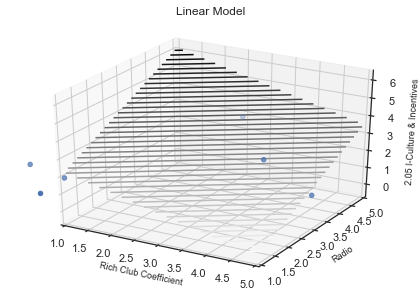




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Rich Club Coefficient, Camino más corto promedio
Predicted: 2.04 I-Demand
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8315442815152589, p-value: [[0.00942739 0.01530653]]
Regression Coefficients: [-0.2730822   0.23754332]
Intercept: 2.97671213417079


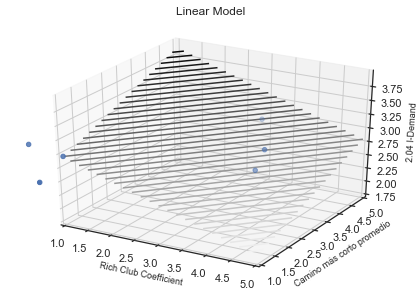




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Rich Club Coefficient, Camino más corto promedio
Predicted: 3.02 E-Funding
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.871130258560011, p-value: [[0.00769648 0.00648055]]
Regression Coefficients: [-0.30390651  0.31978269]
Intercept: 2.0916950981489517


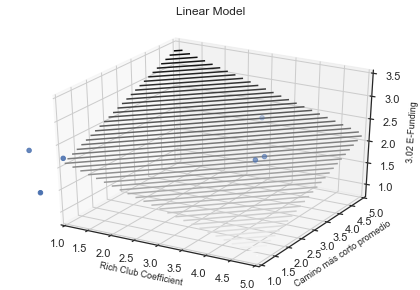




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Rich Club Coefficient, Core Ratio
Predicted: 3.01 E-Human Capital
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8447247155446826, p-value: [[0.01396095 0.00896391]]
Regression Coefficients: [0.89887982 1.05095608]
Intercept: 2.086382400150015


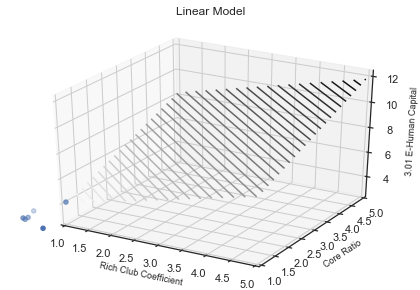




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Rich Club Coefficient, Modularidad
Predicted: 3.01 E-Human Capital
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.9364064864264952, p-value: [[0.00079676 0.00102958]]
Regression Coefficients: [1.18460782 1.2077129 ]
Intercept: 1.7092520599451952


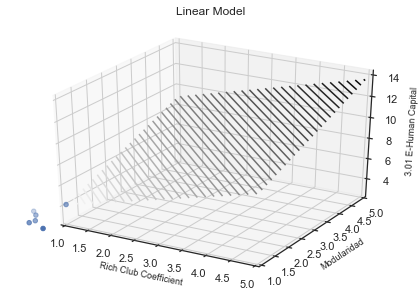




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Rich Club Coefficient, Modularidad
Predicted: 3.02 E-Funding
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8034343185198747, p-value: [[0.02983098 0.01318444]]
Regression Coefficients: [-0.427257    0.59872873]
Intercept: 2.037465725839312


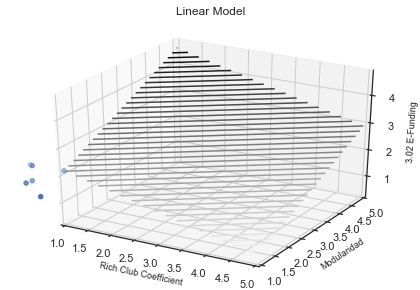




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Rich Club Coefficient, Modularidad
Predicted: 4 Comparative Advantage
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.9514345894766952, p-value: [[0.03551566 0.00028079]]
Regression Coefficients: [0.18362026 0.76659436]
Intercept: 2.1869159040280577


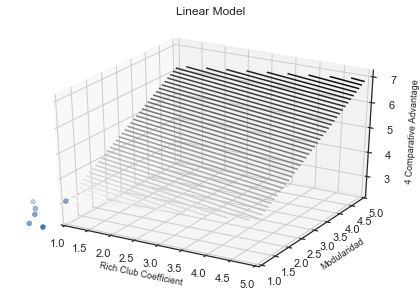




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Core Ratio, avg strength
Predicted: 2.01 I-Human Capital
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.825422366373619, p-value: [[0.00798491 0.0069998 ]]
Regression Coefficients: [-3.19689545  3.47536427]
Intercept: 1.9555922125600538


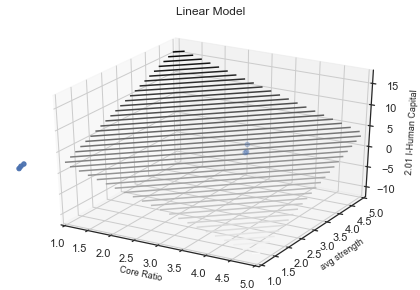




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Core Ratio, weight
Predicted: 2.05 I-Culture & Incentives
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8698976249461959, p-value: [[0.00360398 0.00890067]]
Regression Coefficients: [ 2.4814277  -1.41363464]
Intercept: 1.7139866282678031


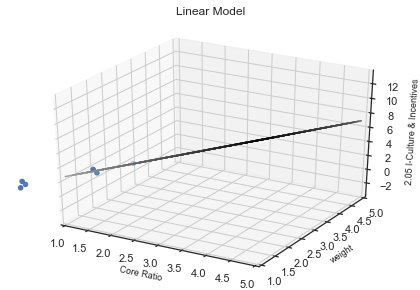




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Core Ratio, Degree
Predicted: 2.05 I-Culture & Incentives
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.9144273884091, p-value: [[0.00206144 0.00360418]]
Regression Coefficients: [ 0.90883162 -0.54212394]
Intercept: 1.9617928748358682


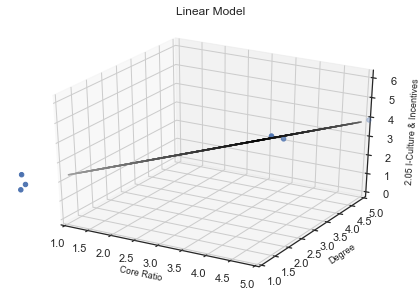




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Core Ratio, Weighted Degree
Predicted: 2.05 I-Culture & Incentives
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.893207129032826, p-value: [[0.00362228 0.00581026]]
Regression Coefficients: [ 0.24371356 -0.15431255]
Intercept: 2.055173980312021


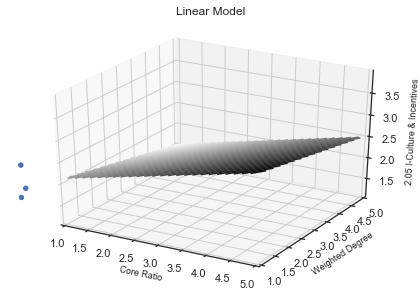




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Core Ratio, Weighted Degree
Predicted: 3.04 E-Demand
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8011344945245288, p-value: [[0.02937236 0.01668553]]
Regression Coefficients: [ 0.05334684 -0.04587152]
Intercept: 3.271912700177281


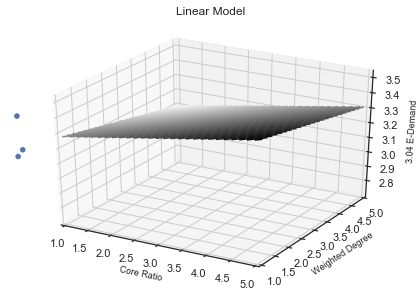




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Core Ratio, Excentricidad
Predicted: 2.05 I-Culture & Incentives
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8046756356182931, p-value: [[0.02944266 0.01628661]]
Regression Coefficients: [-0.59859654  0.7413035 ]
Intercept: 1.9877722877933797


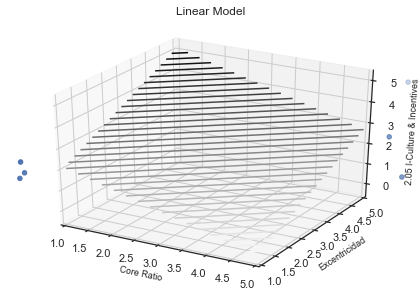




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Core Ratio, Diámetro
Predicted: 2.05 I-Culture & Incentives
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8054678471927108, p-value: [[0.02500874 0.01521007]]
Regression Coefficients: [-0.51823936  0.63129799]
Intercept: 2.0142389613000065


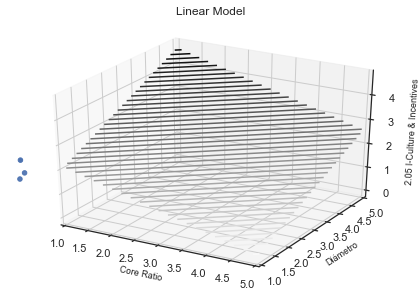




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Core Ratio, Radio
Predicted: 2.05 I-Culture & Incentives
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8424059166702831, p-value: [[0.01682593 0.00784269]]
Regression Coefficients: [-0.68464504  1.03205423]
Intercept: 1.8907218141021866


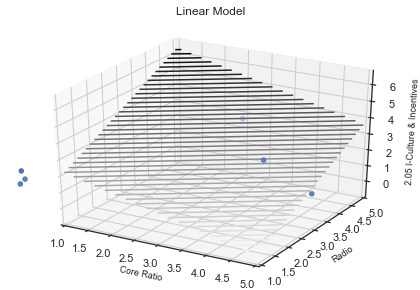




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Core Ratio, Transitividad
Predicted: 2.02 I-Funding
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.9398300953212213, p-value: [[0.0082286 0.0016996]]
Regression Coefficients: [ 2.46446739 -3.19344335]
Intercept: 2.0140173965647423


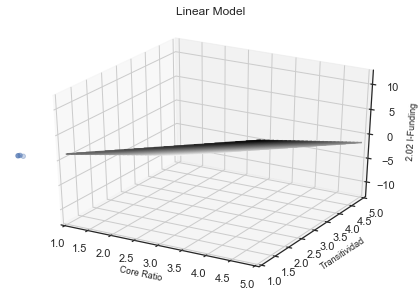




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Core Ratio, Eficiencia Global
Predicted: 2.02 I-Funding
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8686452008569281, p-value: [[0.04536282 0.01068911]]
Regression Coefficients: [ 2.29820406 -3.23411751]
Intercept: 2.097317528570153


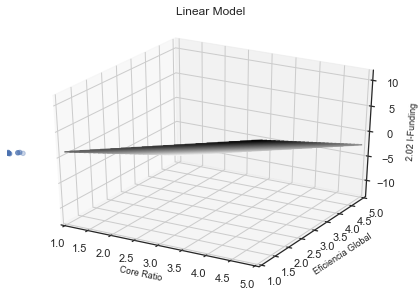




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Core Ratio, Small Worldness
Predicted: 3.05 E-Culture & Incentives
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8068552247185714, p-value: [[0.01413171 0.02278786]]
Regression Coefficients: [-2.22980076  1.57828363]
Intercept: 3.2932795105464727


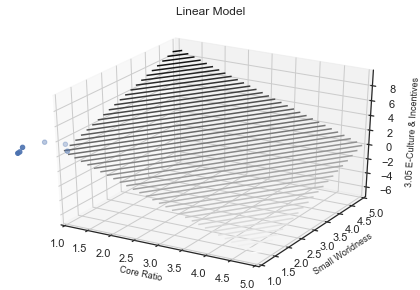




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Core Ratio, Spectral radius
Predicted: 4 Comparative Advantage
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.813537949305055, p-value: [[0.01269386 0.01277257]]
Regression Coefficients: [-2.10031001  2.10910577]
Intercept: 2.734547698619682


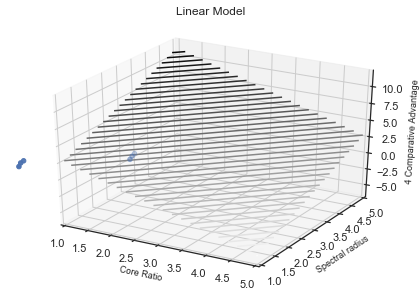




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Core Ratio, Colab 0
Predicted: 2.05 I-Culture & Incentives
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8379324197975112, p-value: [[0.00860738 0.01627762]]
Regression Coefficients: [ 0.27101009 -0.16151035]
Intercept: 2.08377829656924


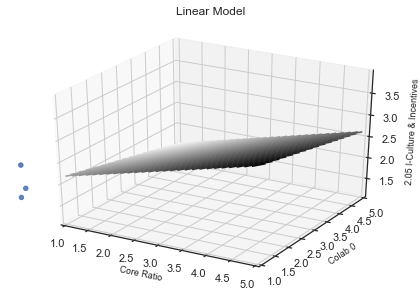




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Core Ratio, Colab 5
Predicted: 2.02 I-Funding
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8721943702534771, p-value: [[0.00647097 0.00677481]]
Regression Coefficients: [ 3.17133157 -3.03090554]
Intercept: 1.6404617902647478


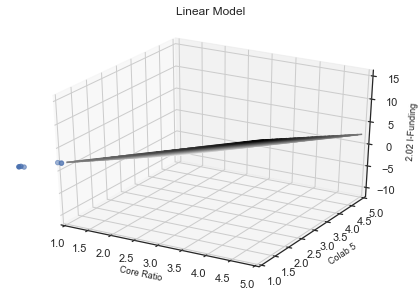




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Central Point Dominance, avg strength
Predicted: 2.04 I-Demand
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8464259386201004, p-value: [[0.00813445 0.00957317]]
Regression Coefficients: [-1.21963189  1.22680084]
Intercept: 3.025625901838511


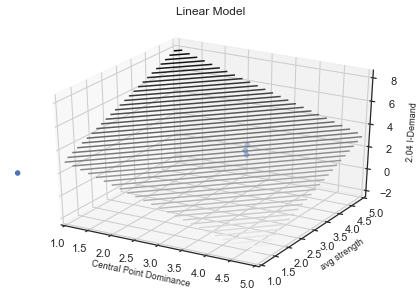




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Central Point Dominance, avg strength
Predicted: 3.02 E-Funding
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.9777007921848516, p-value: [[0.00015408 0.00016136]]
Regression Coefficients: [-1.59147176  1.65753725]
Intercept: 2.191927014756173


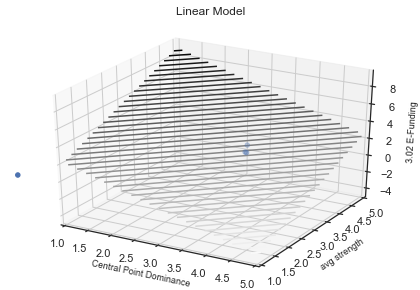




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Central Point Dominance, Degree
Predicted: 2.05 I-Culture & Incentives
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8626318228344579, p-value: [[0.00527287 0.00924093]]
Regression Coefficients: [ 0.88402947 -0.52374772]
Intercept: 1.9470956518962712


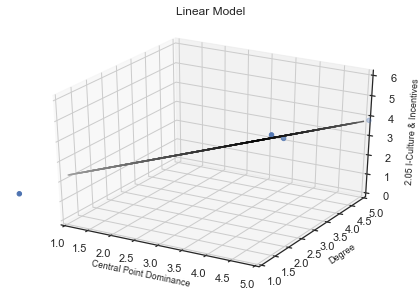




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Central Point Dominance, Weighted Degree
Predicted: 2.05 I-Culture & Incentives
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8817966152976994, p-value: [[0.00441032 0.00711866]]
Regression Coefficients: [ 0.24279033 -0.15326688]
Intercept: 2.0467681601248917


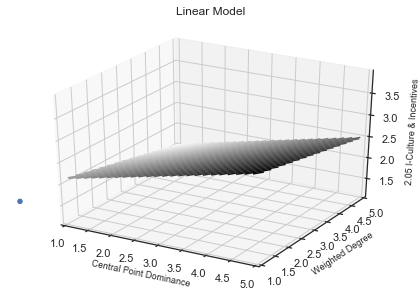




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Central Point Dominance, Excentricidad
Predicted: 2.05 I-Culture & Incentives
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8283564494007906, p-value: [[0.02051673 0.01282278]]
Regression Coefficients: [-0.62548003  0.74388781]
Intercept: 2.1224920996652203


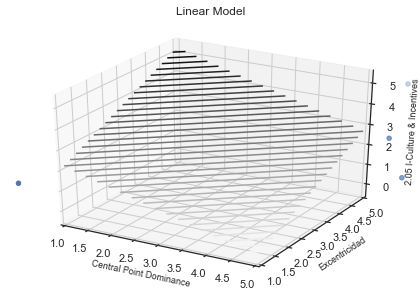




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Central Point Dominance, Clustering
Predicted: 4 Comparative Advantage
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8720450298079425, p-value: [[0.02320182 0.00084499]]
Regression Coefficients: [-0.99557023 -2.72715589]
Intercept: 3.7975368031529904


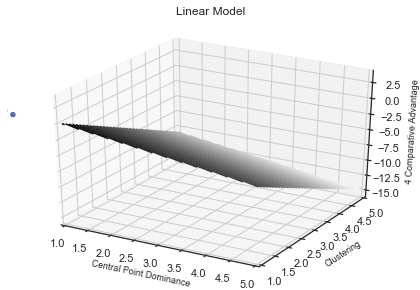




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Central Point Dominance, Diámetro
Predicted: 2.05 I-Culture & Incentives
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8273011822510715, p-value: [[0.01849518 0.01235213]]
Regression Coefficients: [-0.53442338  0.63148747]
Intercept: 2.125633175017608


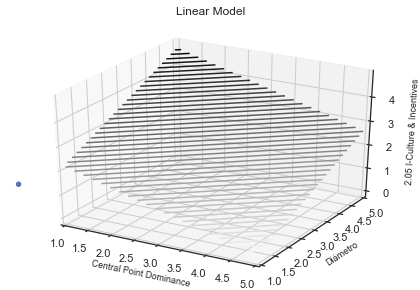




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Central Point Dominance, Radio
Predicted: 2.05 I-Culture & Incentives
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.872660110644856, p-value: [[0.0099759  0.00593235]]
Regression Coefficients: [-0.71761078  1.00957228]
Intercept: 2.0984942156407103


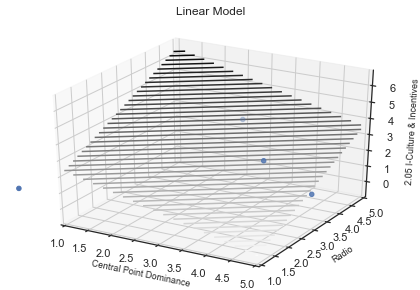




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Central Point Dominance, Eficiencia Global
Predicted: 4 Comparative Advantage
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.9084725785109776, p-value: [[0.01190957 0.00125327]]
Regression Coefficients: [-1.12240246 -2.45045439]
Intercept: 3.784812226653128


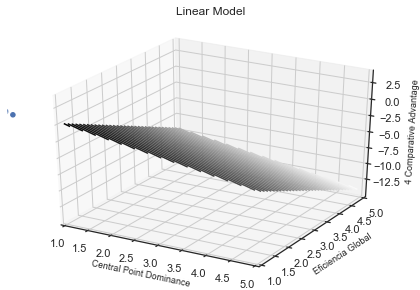




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Central Point Dominance, Spectral radius
Predicted: 2.04 I-Demand
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8377042269116847, p-value: [[0.00789174 0.01082569]]
Regression Coefficients: [-1.39220418  1.30212097]
Intercept: 3.0572587204534196


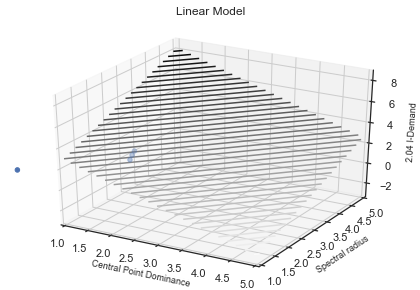




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Central Point Dominance, Spectral radius
Predicted: 3.02 E-Funding
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.9222052915808683, p-value: [[0.00170746 0.00192994]]
Regression Coefficients: [-1.75753756  1.74228666]
Intercept: 2.22246579097387


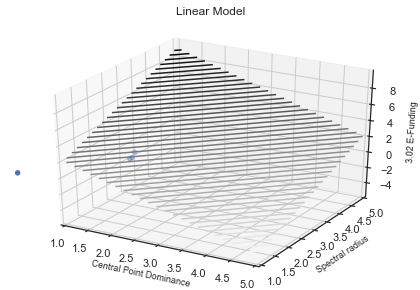




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Central Point Dominance, Spectral radius
Predicted: 4 Comparative Advantage
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8542644369416146, p-value: [[0.00887062 0.01446043]]
Regression Coefficients: [-1.40275378  1.24584577]
Intercept: 3.022969224509655


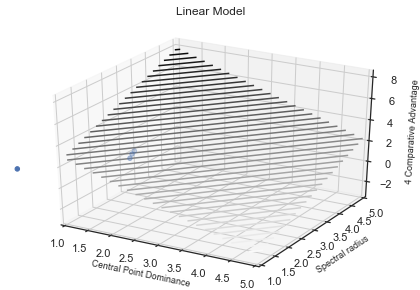




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Central Point Dominance, Modularidad
Predicted: 2.04 I-Demand
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8979691103591013, p-value: [[0.00239929 0.00843062]]
Regression Coefficients: [-1.24457239  1.02832043]
Intercept: 3.05733665711439


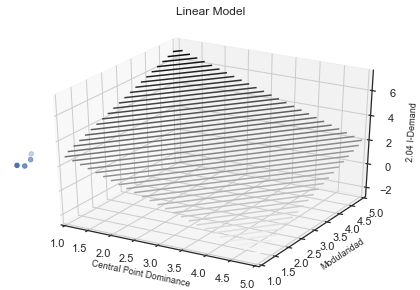




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Central Point Dominance, Modularidad
Predicted: 2.05 I-Culture & Incentives
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8776554387725742, p-value: [[0.02105661 0.00518824]]
Regression Coefficients: [-3.15803163  5.54018182]
Intercept: 1.6961747998366346


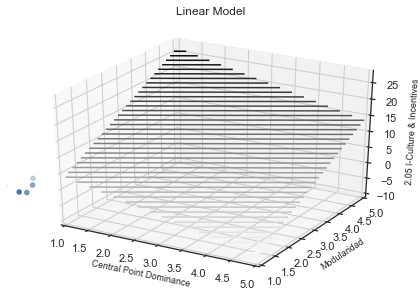




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Central Point Dominance, Modularidad
Predicted: 3.02 E-Funding
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8886908756958858, p-value: [[0.00355039 0.00669775]]
Regression Coefficients: [-1.40450132  1.37651009]
Intercept: 2.222445084770089


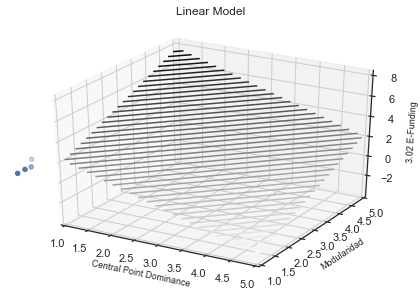




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Central Point Dominance, Colab 0
Predicted: 2.05 I-Culture & Incentives
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8246089774964425, p-value: [[0.01004311 0.01909595]]
Regression Coefficients: [ 0.26946077 -0.15995596]
Intercept: 2.0770710138599355


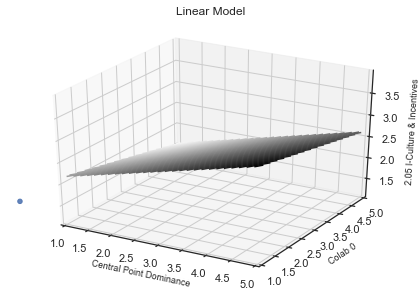




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Central Point Dominance, Colab 3
Predicted: 4 Comparative Advantage
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.9657438230298359, p-value: [[0.00094097 0.00024761]]
Regression Coefficients: [-1.1616834  -1.75084449]
Intercept: 3.6408952430149153


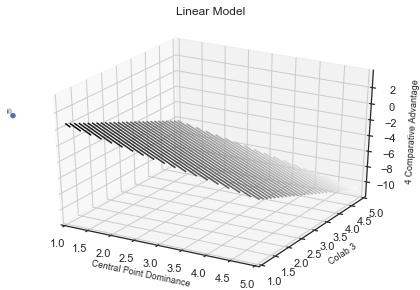




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Central Point Dominance, Colab 6
Predicted: 4 Comparative Advantage
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.9548150796463726, p-value: [[3.01486824e-03 8.57885755e-05]]
Regression Coefficients: [-1.03376282 -2.90416187]
Intercept: 3.7972940825580794


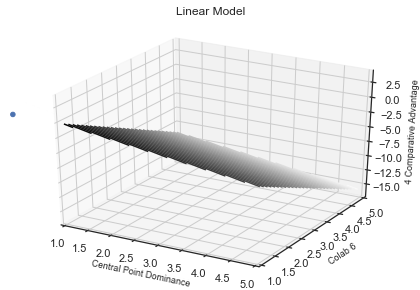




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Spectral radius, avg strength
Predicted: 2.02 I-Funding
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8096090277098884, p-value: [[0.03772738 0.02201432]]
Regression Coefficients: [-1.30254009  1.61510078]
Intercept: 0.9538407808398921


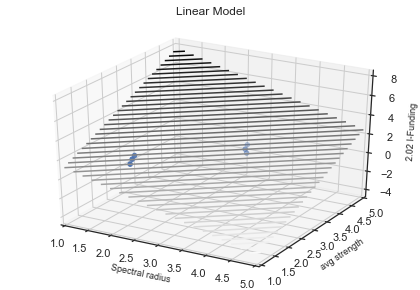




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Spectral radius, Degree
Predicted: 2.05 I-Culture & Incentives
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.9312417279924711, p-value: [[0.00029224 0.00202322]]
Regression Coefficients: [ 1.21848754 -0.53929732]
Intercept: 0.7722233575814594


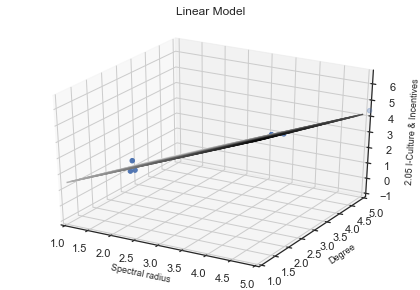




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Spectral radius, Weighted Degree
Predicted: 2.05 I-Culture & Incentives
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8979642839826666, p-value: [[0.00266523 0.00530213]]
Regression Coefficients: [ 0.25654553 -0.15411633]
Intercept: 1.8831600236208097


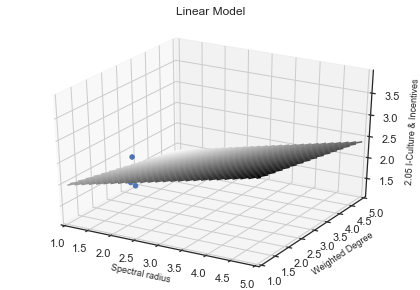




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Spectral radius, Weighted Degree
Predicted: 3.04 E-Demand
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8033451158064251, p-value: [[0.02602339 0.0161756 ]]
Regression Coefficients: [ 0.05465902 -0.04586472]
Intercept: 3.2542650871301273


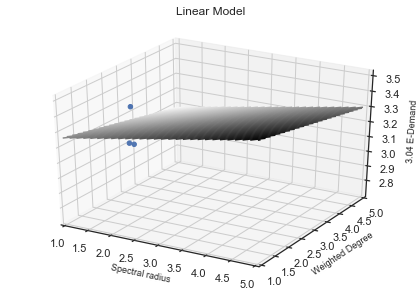




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Spectral radius, Clustering
Predicted: 4 Comparative Advantage
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8169773983430964, p-value: [[0.01156965 0.011646  ]]
Regression Coefficients: [ 2.07601814 -2.09202552]
Intercept: 2.83746937583131


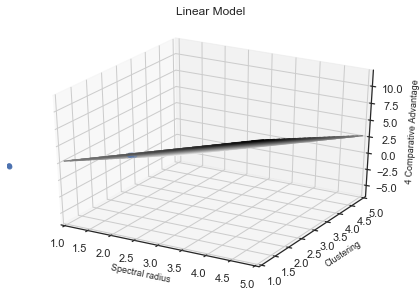




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Spectral radius, Transitividad
Predicted: 4 Comparative Advantage
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.9811364807385646, p-value: [[0.00012663 0.00013114]]
Regression Coefficients: [ 2.24307609 -2.2517247 ]
Intercept: 2.8211651634560453


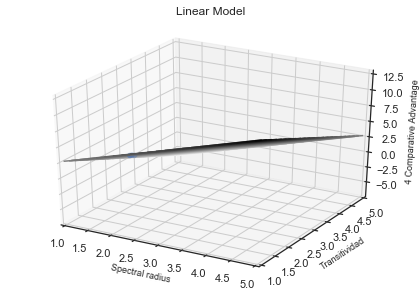




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Spectral radius, Eficiencia Global
Predicted: 4 Comparative Advantage
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.9183428260073744, p-value: [[0.00343735 0.0039832 ]]
Regression Coefficients: [ 2.28940478 -2.22959398]
Intercept: 2.6912865035443576


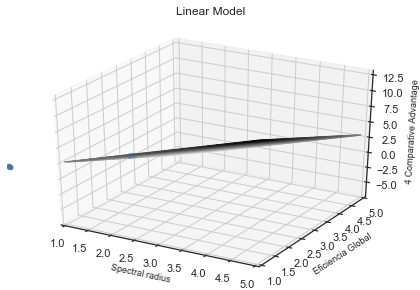




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Spectral radius, Small Worldness
Predicted: 2.01 I-Human Capital
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.9205448922063848, p-value: [[0.00065592 0.00019157]]
Regression Coefficients: [ 2.6211745  -3.47613219]
Intercept: 3.83947071668462


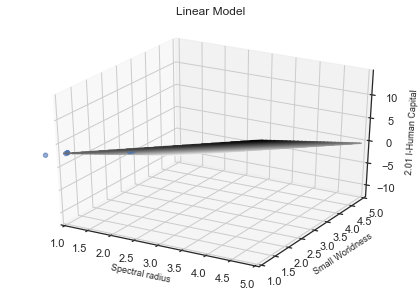




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Spectral radius, Rich Club Coefficient
Predicted: 2.01 I-Human Capital
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.9263683591314228, p-value: [[0.00198893 0.00219936]]
Regression Coefficients: [ 0.96182475 -0.96078547]
Intercept: 2.254548241946072


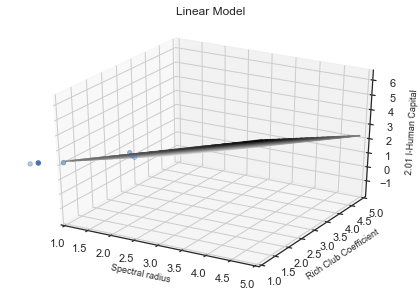




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Spectral radius, Rich Club Coefficient
Predicted: 2.03 I-Infrastructure
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8263585059767196, p-value: [[0.02083922 0.01181944]]
Regression Coefficients: [ 0.50091326 -0.60928568]
Intercept: 3.634493908947024


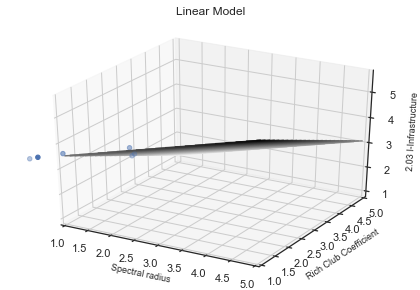




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Spectral radius, Rich Club Coefficient
Predicted: 3.03 E-Infrastructure
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8393731441504053, p-value: [[0.02279119 0.01039877]]
Regression Coefficients: [ 0.43011713 -0.55832498]
Intercept: 4.007627641925498


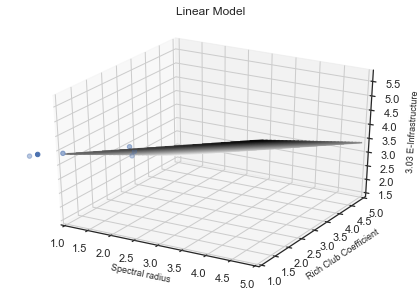




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Spectral radius, Core Ratio
Predicted: 4 Comparative Advantage
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.9571068320668323, p-value: [[0.00058973 0.00058097]]
Regression Coefficients: [ 2.31630753 -2.33927   ]
Intercept: 2.8458457436856417


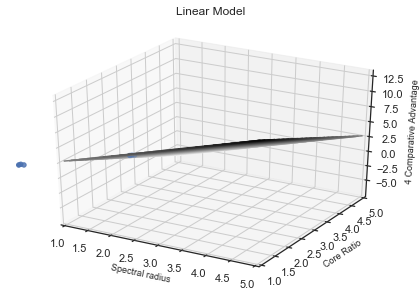




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Spectral radius, Central Point Dominance
Predicted: 2.01 I-Human Capital
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.9600502586401901, p-value: [[0.00041718 0.00050487]]
Regression Coefficients: [ 3.00061052 -2.92550501]
Intercept: 2.0677663096586003


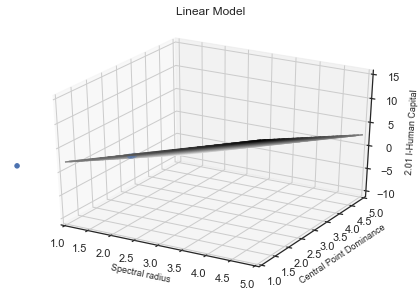




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Spectral radius, Central Point Dominance
Predicted: 2.03 I-Infrastructure
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8312381237796631, p-value: [[0.01108673 0.01081848]]
Regression Coefficients: [ 1.68058324 -1.73330093]
Intercept: 3.4869025321893


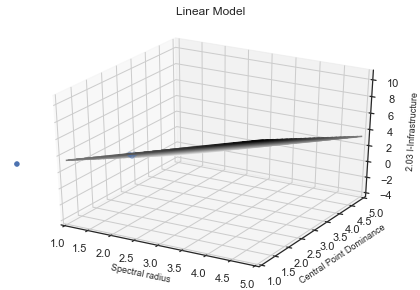




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Spectral radius, Central Point Dominance
Predicted: 3.03 E-Infrastructure
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8186469776800089, p-value: [[0.01398797 0.01324308]]
Regression Coefficients: [ 1.49369502 -1.55459211]
Intercept: 3.849253375560516


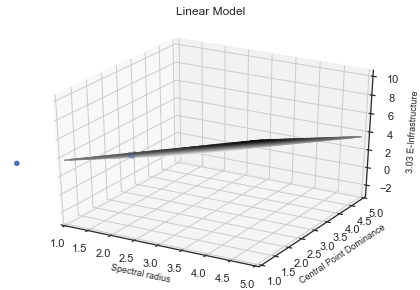




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Spectral radius, Modularidad
Predicted: 2.02 I-Funding
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.83479831285198, p-value: [[0.01146954 0.02114533]]
Regression Coefficients: [-1.55706309  1.3238762 ]
Intercept: 1.9873491308417184


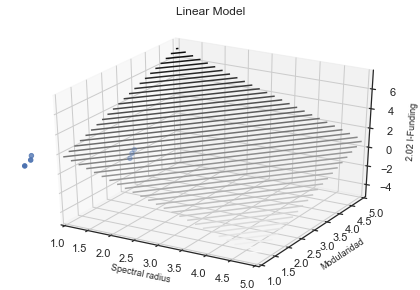




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Spectral radius, Colab 0
Predicted: 2.05 I-Culture & Incentives
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8314135741108329, p-value: [[0.00700627 0.01917672]]
Regression Coefficients: [ 0.28871672 -0.15631032]
Intercept: 1.872238975148007


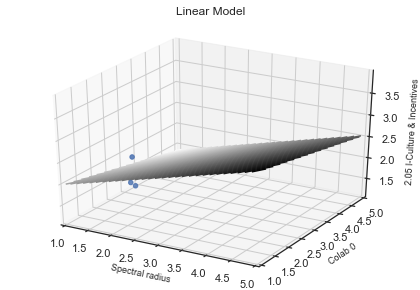




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Spectral radius, Colab 2
Predicted: 2.05 I-Culture & Incentives
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8646896534247833, p-value: [[0.0117728  0.00587294]]
Regression Coefficients: [ 2.48627549 -3.04449626]
Intercept: 3.0556002637138735


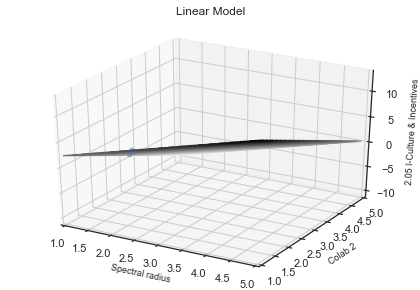




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Spectral radius, Colab 3
Predicted: 4 Comparative Advantage
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8451797458695897, p-value: [[0.01062822 0.01160011]]
Regression Coefficients: [ 1.67175803 -1.64473251]
Intercept: 2.769841051729739


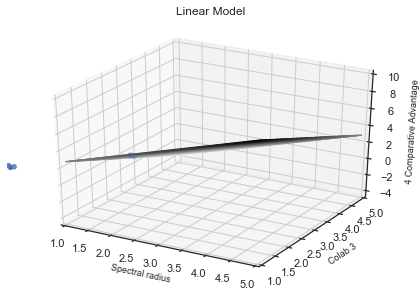




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Spectral radius, Colab 4
Predicted: 4 Comparative Advantage
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8979286533768701, p-value: [[0.0041764  0.00444101]]
Regression Coefficients: [ 1.72871289 -1.71628465]
Intercept: 2.796481515630202


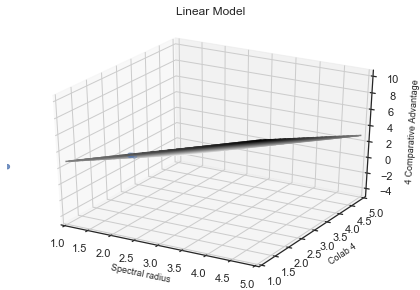




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Spectral radius, Colab 5
Predicted: 4 Comparative Advantage
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.9506731608418213, p-value: [[0.00113869 0.00143289]]
Regression Coefficients: [ 2.27906125 -2.16869813]
Intercept: 2.5954426285606256


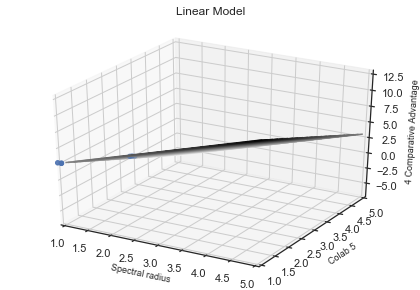




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Spectral radius, Colab 6
Predicted: 4 Comparative Advantage
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.9223679479826522, p-value: [[0.00241514 0.00255452]]
Regression Coefficients: [ 1.98533946 -1.97606258]
Intercept: 2.794663822162279


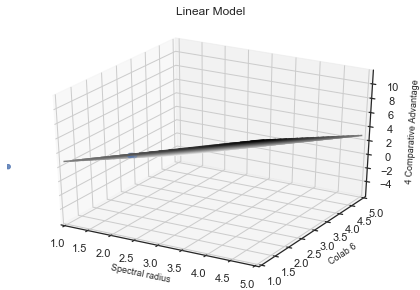




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Modularidad, avg strength
Predicted: 2.02 I-Funding
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8556189262718752, p-value: [[0.01850784 0.01503873]]
Regression Coefficients: [-1.14288616  1.280362  ]
Intercept: 1.5047768128602528


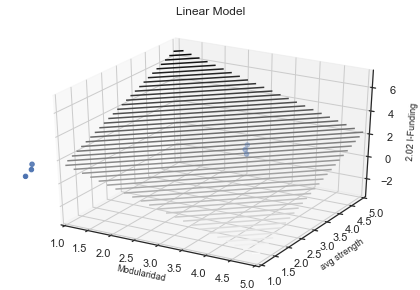




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Modularidad, weight
Predicted: 2.05 I-Culture & Incentives
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8917512601158367, p-value: [[0.00106954 0.00579887]]
Regression Coefficients: [ 2.83932477 -1.3624641 ]
Intercept: 1.1213171585906736


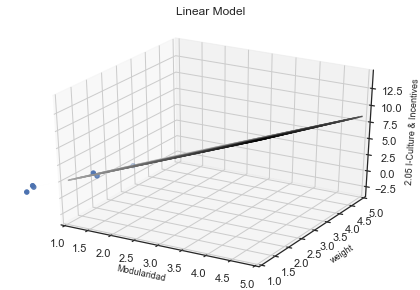




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Modularidad, weight
Predicted: 3.04 E-Demand
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8015806457153335, p-value: [[0.01381876 0.01482215]]
Regression Coefficients: [ 0.56223883 -0.41612312]
Intercept: 3.1579620975575233


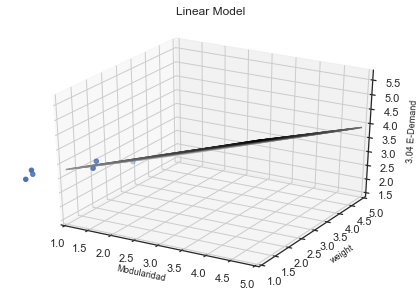




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Modularidad, Degree
Predicted: 2.05 I-Culture & Incentives
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.9329056164137728, p-value: [[0.00101463 0.00215616]]
Regression Coefficients: [ 0.95348402 -0.54440505]
Intercept: 1.806205229220007


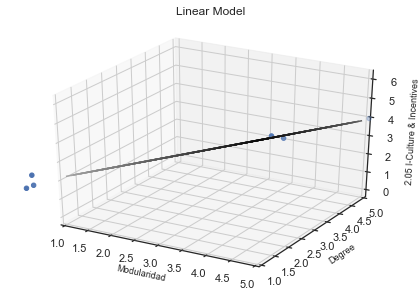




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Modularidad, Weighted Degree
Predicted: 2.05 I-Culture & Incentives
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8995976599769778, p-value: [[0.00305916 0.00513493]]
Regression Coefficients: [ 0.24705846 -0.15470239]
Intercept: 2.018505748168963


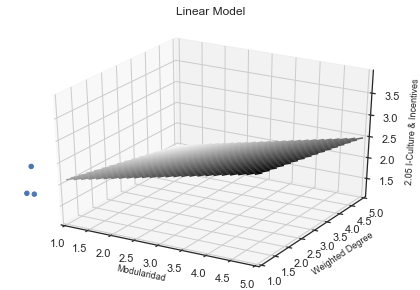




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Modularidad, Weighted Degree
Predicted: 3.04 E-Demand
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8054966917272954, p-value: [[0.02708019 0.01591951]]
Regression Coefficients: [ 0.05408039 -0.04596979]
Intercept: 3.264157799132835


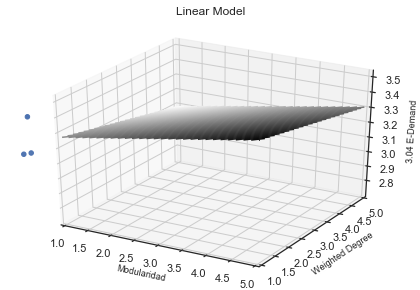




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Modularidad, Clustering
Predicted: 4 Comparative Advantage
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8363684243698839, p-value: [[0.0112693  0.01020548]]
Regression Coefficients: [ 1.35377677 -1.42797972]
Intercept: 2.812902633455614


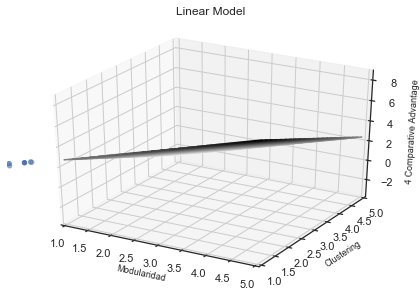




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Modularidad, Radio
Predicted: 2.05 I-Culture & Incentives
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8011691117941535, p-value: [[0.02619368 0.01393954]]
Regression Coefficients: [-0.66854704  0.98121962]
Intercept: 1.9915127442048222


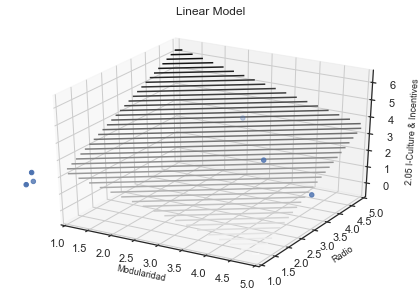




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Modularidad, Transitividad
Predicted: 4 Comparative Advantage
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.9532414982237845, p-value: [[0.00083234 0.00104692]]
Regression Coefficients: [ 1.47135536 -1.47419295]
Intercept: 2.7757419100246072


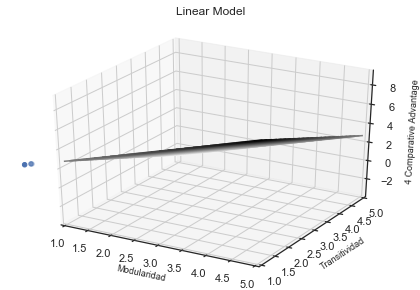




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Modularidad, Eficiencia Global
Predicted: 4 Comparative Advantage
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.9005684862137264, p-value: [[0.0027413  0.00682192]]
Regression Coefficients: [ 1.66591944 -1.3772352 ]
Intercept: 2.612039044159789


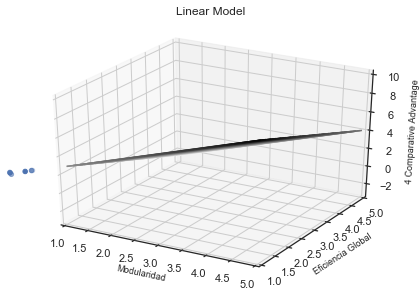




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Modularidad, Small Worldness
Predicted: 1 Foundational Institutions
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8697628176770975, p-value: [[0.00201633 0.02221189]]
Regression Coefficients: [ 2.19605521 -0.97000305]
Intercept: 2.7680176601182236


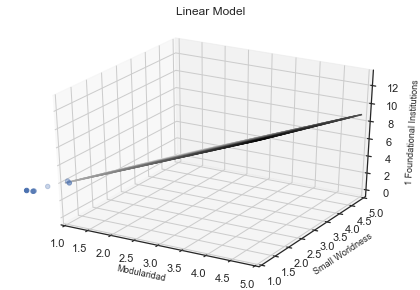




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Modularidad, Small Worldness
Predicted: 2.01 I-Human Capital
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.9073954648794572, p-value: [[0.00098369 0.00886865]]
Regression Coefficients: [ 2.67240947 -1.2836604 ]
Intercept: 1.4072640444430522


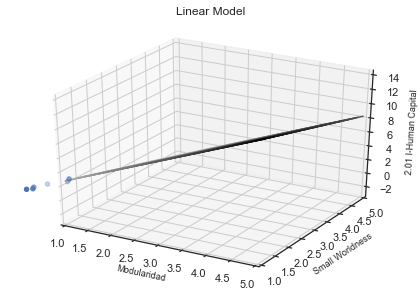




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Modularidad, Rich Club Coefficient
Predicted: 2.01 I-Human Capital
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.9787046900540834, p-value: [[0.0003016 0.0001573]]
Regression Coefficients: [ 0.82449944 -1.06101716]
Intercept: 2.393392280245322


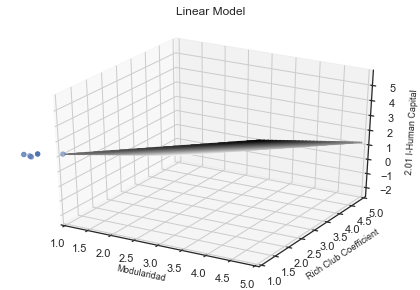




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Modularidad, Rich Club Coefficient
Predicted: 2.03 I-Infrastructure
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.820873817313603, p-value: [[0.00513452 0.04494015]]
Regression Coefficients: [ 0.74558036 -0.42142553]
Intercept: 3.269456708880254


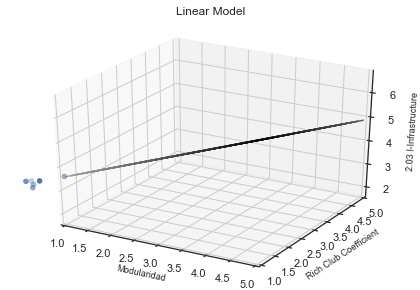




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Modularidad, Core Ratio
Predicted: 4 Comparative Advantage
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.9206218618665183, p-value: [[0.00320935 0.00215608]]
Regression Coefficients: [ 1.37165327 -1.51922393]
Intercept: 2.8531406422686896


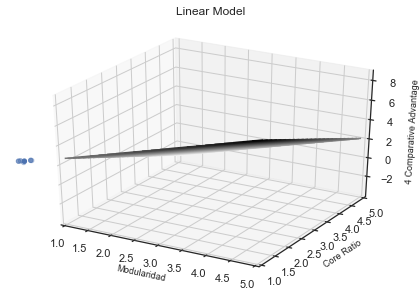




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Modularidad, Central Point Dominance
Predicted: 2.01 I-Human Capital
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8406950192012792, p-value: [[0.00639413 0.01788082]]
Regression Coefficients: [ 2.35809501 -2.04233965]
Intercept: 2.0225441024120334


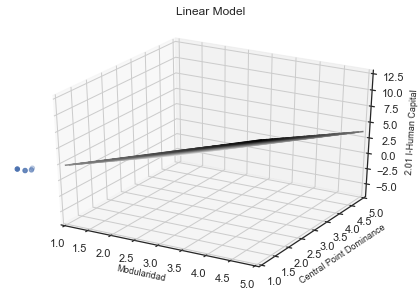




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Modularidad, Central Point Dominance
Predicted: 3.02 E-Funding
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8241122682365498, p-value: [[0.01016456 0.01520473]]
Regression Coefficients: [ 1.31596938 -1.36529642]
Intercept: 2.029520588856512


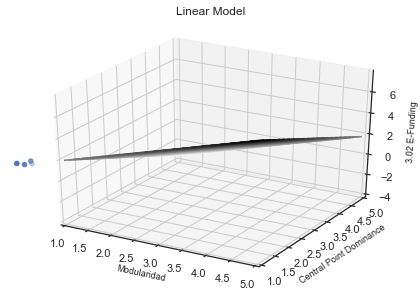




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Modularidad, Spectral radius
Predicted: 2.02 I-Funding
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.9081598063048055, p-value: [[0.00763667 0.00542862]]
Regression Coefficients: [-1.30476423  1.46638976]
Intercept: 1.5017745825387927


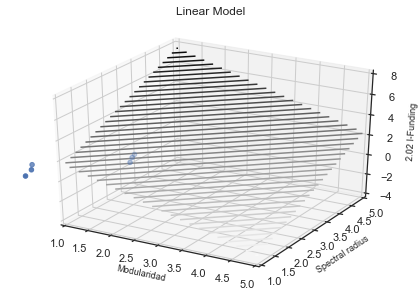




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Modularidad, Average collabs
Predicted: 2.01 I-Human Capital
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.804401446826403, p-value: [[0.01515134 0.01561401]]
Regression Coefficients: [ 0.26461789 -0.26234892]
Intercept: 2.280067766278547


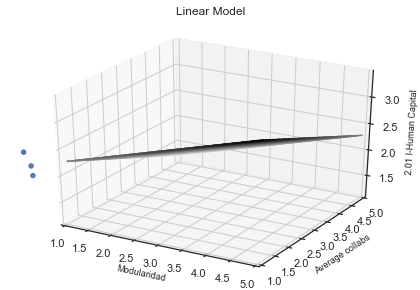




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Modularidad, Colab 0
Predicted: 2.05 I-Culture & Incentives
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8427300302221487, p-value: [[0.00767962 0.01560804]]
Regression Coefficients: [ 0.27524053 -0.16097427]
Intercept: 2.0428747657975035


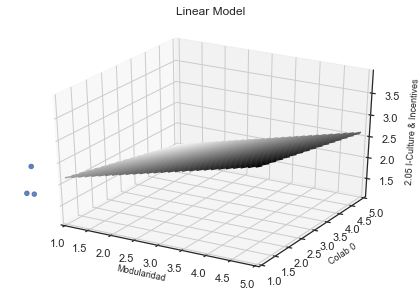




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Modularidad, Colab 1
Predicted: 3.02 E-Funding
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8288011780424798, p-value: [[0.00261436 0.01760958]]
Regression Coefficients: [ 1.79126196 -1.00663795]
Intercept: 1.5362434300285612


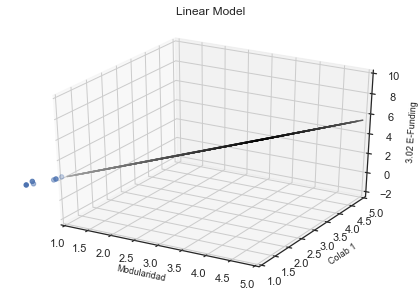




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Modularidad, Colab 1
Predicted: 4 Comparative Advantage
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.9186710575581857, p-value: [[0.00637986 0.00280223]]
Regression Coefficients: [ 0.88532044 -1.06863659]
Intercept: 2.9165422931234914


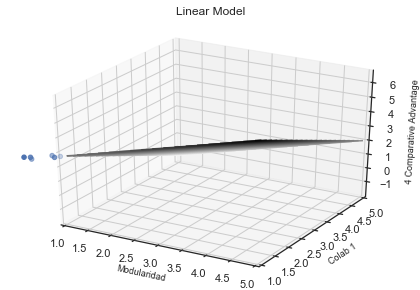




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Modularidad, Colab 3
Predicted: 4 Comparative Advantage
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.9169566633687203, p-value: [[0.00257049 0.0031332 ]]
Regression Coefficients: [ 1.3474749  -1.30296272]
Intercept: 2.7523140298069175


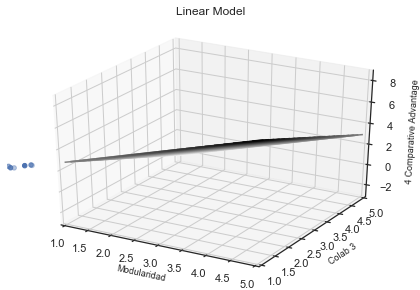




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Modularidad, Colab 4
Predicted: 4 Comparative Advantage
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.9591587417692514, p-value: [[0.00064066 0.00073436]]
Regression Coefficients: [ 1.34630553 -1.33344727]
Intercept: 2.773900456424025


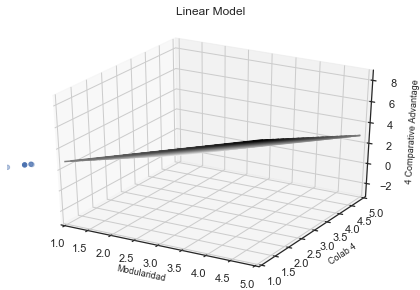




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Modularidad, Colab 5
Predicted: 4 Comparative Advantage
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.9393547352954807, p-value: [[0.00268192 0.00161303]]
Regression Coefficients: [ 1.28510667 -1.49918874]
Intercept: 2.899711331467112


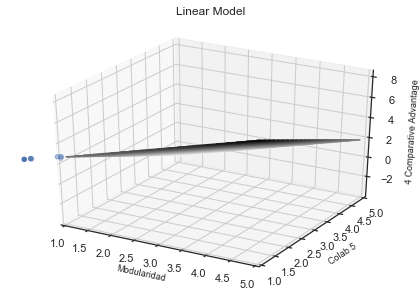




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Modularidad, Colab 6
Predicted: 4 Comparative Advantage
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.9430084662916167, p-value: [[0.00122225 0.00148523]]
Regression Coefficients: [ 1.4303354  -1.40336413]
Intercept: 2.7611376315623284


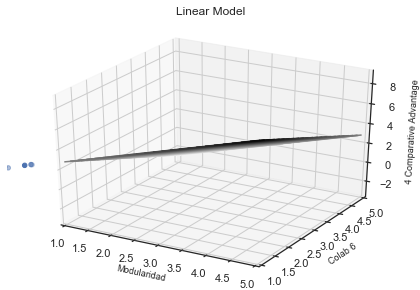




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Average collabs, Excentricidad
Predicted: 3.02 E-Funding
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.9550919334447306, p-value: [[0.00060927 0.00086564]]
Regression Coefficients: [-0.14612696  0.1340949 ]
Intercept: 2.2389591861910376


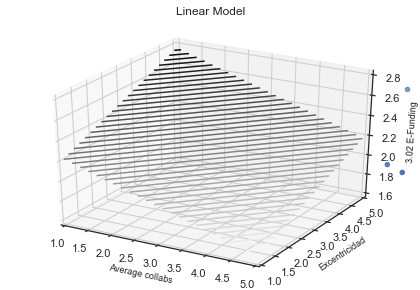




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Average collabs, Excentricidad
Predicted: 4 Comparative Advantage
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8655718782556007, p-value: [[0.02010999 0.00913731]]
Regression Coefficients: [-0.08839761  0.11224397]
Intercept: 2.582708789739271


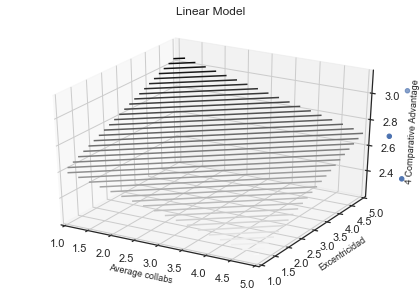




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Average collabs, Diámetro
Predicted: 2.04 I-Demand
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8231791193268716, p-value: [[0.0167024  0.01230471]]
Regression Coefficients: [-0.08968385  0.09927737]
Intercept: 2.811980530083731


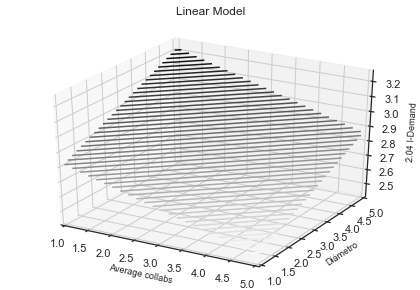




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Average collabs, Diámetro
Predicted: 3.02 E-Funding
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.9389676558592016, p-value: [[0.00104951 0.00172417]]
Regression Coefficients: [-0.13591088  0.12056529]
Intercept: 2.282869613939128


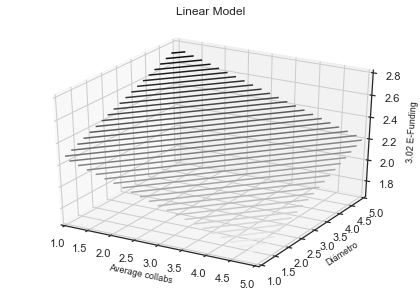




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Average collabs, Diámetro
Predicted: 4 Comparative Advantage
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8502674311144567, p-value: [[0.0269582  0.01006291]]
Regression Coefficients: [-0.07822128  0.10647758]
Intercept: 2.526506418350431


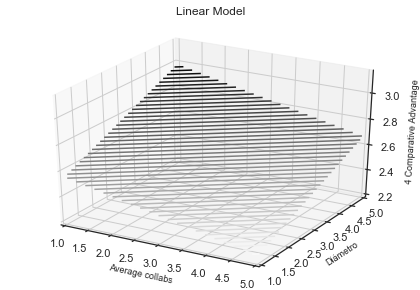




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Average collabs, Radio
Predicted: 3.02 E-Funding
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.9289452320113742, p-value: [[0.00128966 0.00211553]]
Regression Coefficients: [-0.15133877  0.13488613]
Intercept: 2.294425146395053


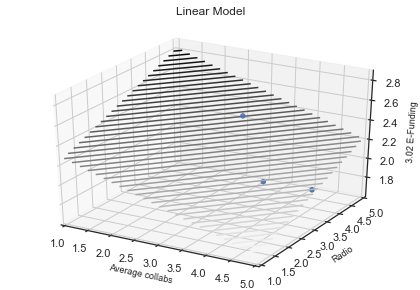




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Average collabs, Radio
Predicted: 4 Comparative Advantage
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8962518803041823, p-value: [[0.00729443 0.00501672]]
Regression Coefficients: [-0.10468968  0.11807559]
Intercept: 2.7136477899112514


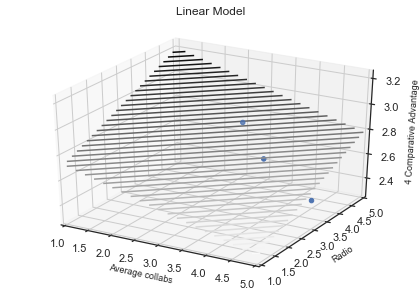




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Average collabs, Camino más corto promedio
Predicted: 3.02 E-Funding
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.910034030884566, p-value: [[0.00292957 0.00340197]]
Regression Coefficients: [-0.15911839  0.15282368]
Intercept: 2.16694891867795


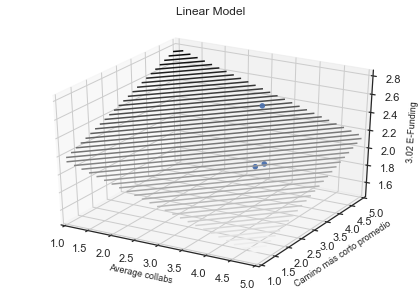




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Average collabs, Camino más corto promedio
Predicted: 4 Comparative Advantage
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8431129145483727, p-value: [[0.02500523 0.01341277]]
Regression Coefficients: [-0.10381021  0.12552537]
Intercept: 2.611576618570613


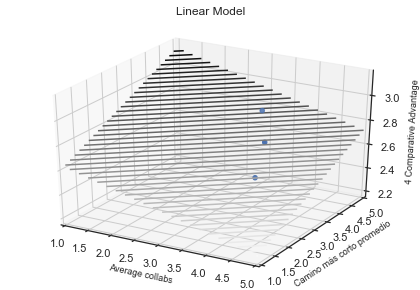




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Colab 0, Weighted Degree
Predicted: 2.02 I-Funding
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8815629465708806, p-value: [[0.0010299  0.01752543]]
Regression Coefficients: [ 0.08054427 -0.02647847]
Intercept: 1.1391440281570506


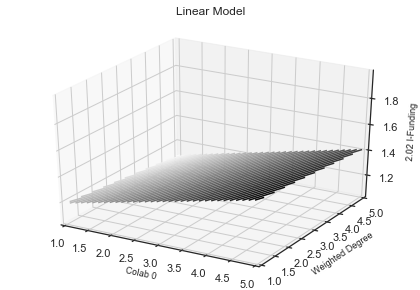




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Colab 0, Excentricidad
Predicted: 4 Comparative Advantage
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8624793891641078, p-value: [[0.04556865 0.00662041]]
Regression Coefficients: [-0.03328999  0.04703258]
Intercept: 2.630635111959794


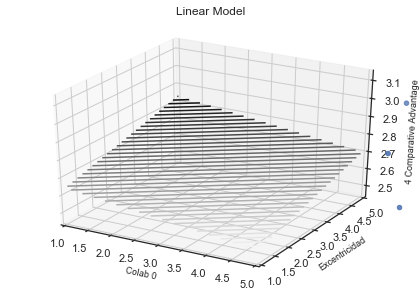




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Colab 0, Diámetro
Predicted: 3.01 E-Human Capital
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8814004142674959, p-value: [[0.03270964 0.00291956]]
Regression Coefficients: [0.06281115 0.1031599 ]
Intercept: 1.8775108986632185


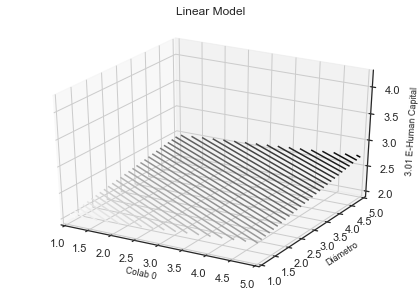




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Colab 0, Diámetro
Predicted: 4 Comparative Advantage
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8735588816537128, p-value: [[0.01411497 0.00569503]]
Regression Coefficients: [-0.04372644  0.04607233]
Intercept: 2.7110275719841064


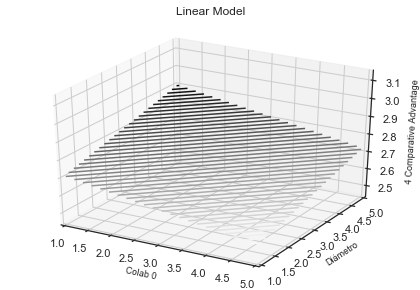




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Colab 0, Radio
Predicted: 4 Comparative Advantage
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8618503347129384, p-value: [[0.02360374 0.00739046]]
Regression Coefficients: [-0.04215124  0.04559639]
Intercept: 2.7159283113898676


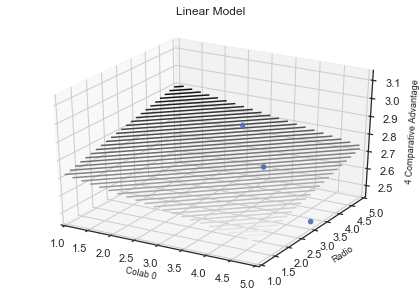




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Colab 1, avg strength
Predicted: 3.02 E-Funding
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8042146013257119, p-value: [[0.01325003 0.01021943]]
Regression Coefficients: [-1.1946555   1.34218011]
Intercept: 1.854284790729869


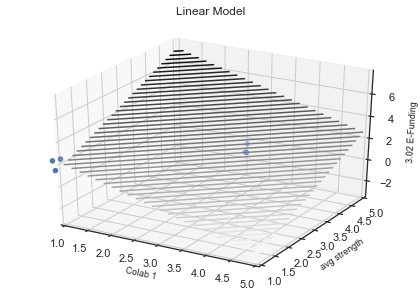




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Colab 1, avg strength
Predicted: 4 Comparative Advantage
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.9069289372714459, p-value: [[0.00339629 0.0035345 ]]
Regression Coefficients: [-1.10621771  1.13967031]
Intercept: 2.7638351383530724


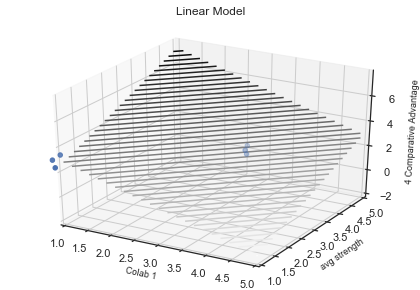




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Colab 1, Degree
Predicted: 2.05 I-Culture & Incentives
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8873313730286321, p-value: [[0.00279878 0.00618298]]
Regression Coefficients: [ 0.94211278 -0.53028331]
Intercept: 1.7680368891393397


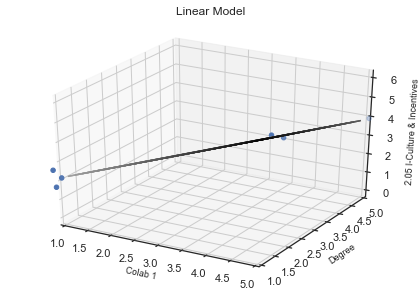




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Colab 1, Weighted Degree
Predicted: 2.05 I-Culture & Incentives
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8879772155991846, p-value: [[0.00381052 0.00640848]]
Regression Coefficients: [ 0.24584092 -0.15366684]
Intercept: 2.0149758563365108


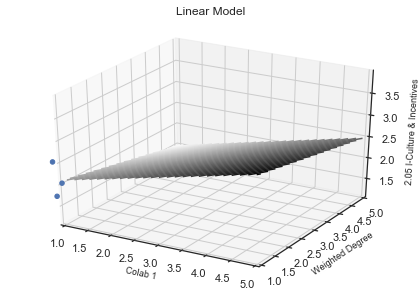




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Colab 1, Excentricidad
Predicted: 2.05 I-Culture & Incentives
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8045118382175446, p-value: [[0.03094426 0.01583598]]
Regression Coefficients: [-0.58508651  0.74115532]
Intercept: 1.9102204750433003


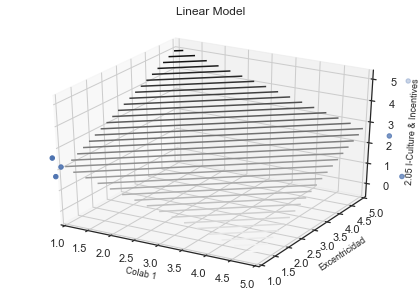




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Colab 1, Diámetro
Predicted: 2.05 I-Culture & Incentives
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8062571020618431, p-value: [[0.02540548 0.01463317]]
Regression Coefficients: [-0.51195309  0.63311673]
Intercept: 1.955150668195221


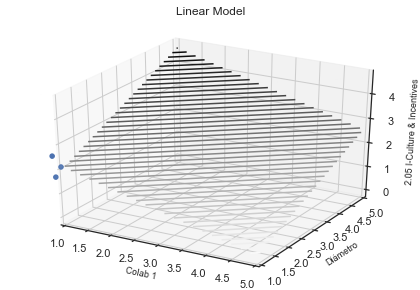




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Colab 1, Radio
Predicted: 2.05 I-Culture & Incentives
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8307452455213826, p-value: [[0.0209504  0.00758783]]
Regression Coefficients: [-0.65321159  1.05118813]
Intercept: 1.692123420857994


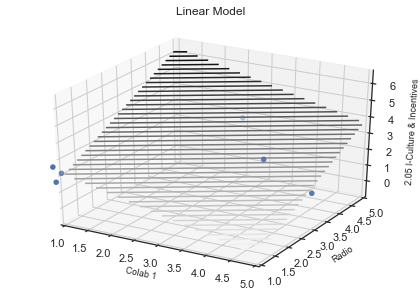




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Colab 1, Camino más corto promedio
Predicted: 2.01 I-Human Capital
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8123625984686836, p-value: [[0.01626739 0.01332792]]
Regression Coefficients: [-0.57128311  0.60222944]
Intercept: 2.230470166764749


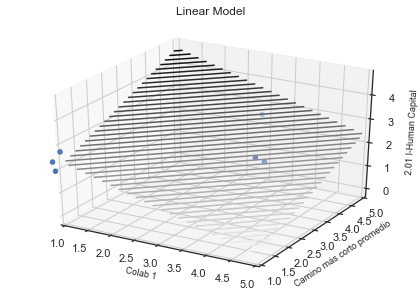




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Colab 1, Transitividad
Predicted: 2.02 I-Funding
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.881099996978641, p-value: [[0.02550567 0.00806865]]
Regression Coefficients: [ 1.13316146 -1.45427932]
Intercept: 1.8801385402648223


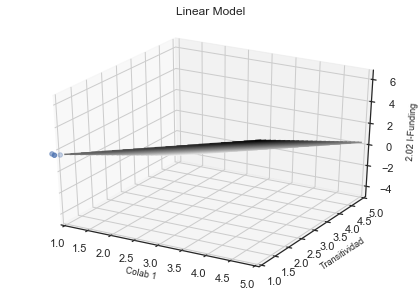




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Colab 1, Small Worldness
Predicted: 1 Foundational Institutions
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8118569957913406, p-value: [[0.04772404 0.00737567]]
Regression Coefficients: [1.13642699 1.73421816]
Intercept: 0.8245269221593934


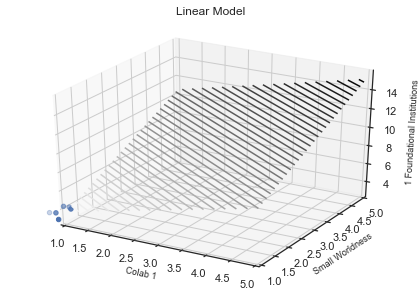




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Colab 1, Small Worldness
Predicted: 2.03 I-Infrastructure
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8142474167208854, p-value: [[0.0207968  0.01405173]]
Regression Coefficients: [1.16515772 1.12501513]
Intercept: 1.3641690936324449


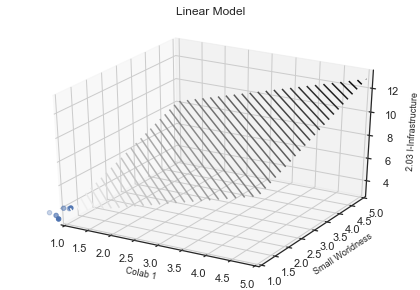




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Colab 1, Rich Club Coefficient
Predicted: 2.02 I-Funding
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8135692038612945, p-value: [[0.0308528  0.00451352]]
Regression Coefficients: [-0.44575297 -0.77650918]
Intercept: 2.641026798585484


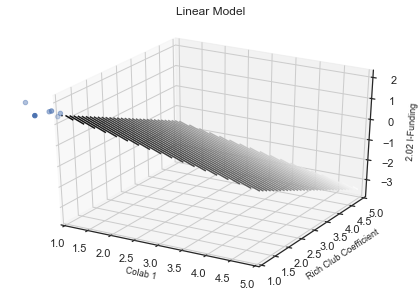




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Colab 1, Rich Club Coefficient
Predicted: 2.05 I-Culture & Incentives
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8147651596632991, p-value: [[0.0298552  0.00446024]]
Regression Coefficients: [-1.50419664 -2.6010518 ]
Intercept: 5.736606052088957


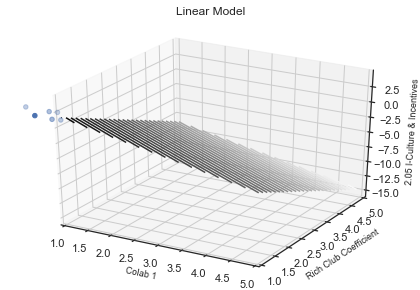




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Colab 1, Rich Club Coefficient
Predicted: 3.05 E-Culture & Incentives
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8547168422196425, p-value: [[0.01382456 0.00717135]]
Regression Coefficients: [-0.59326229  0.70887806]
Intercept: 3.0106741822148284


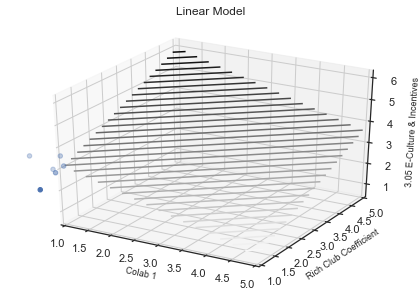




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Colab 1, Spectral radius
Predicted: 4 Comparative Advantage
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.9650996819382783, p-value: [[0.00049503 0.00057565]]
Regression Coefficients: [-1.33085365  1.27480903]
Intercept: 2.8322104928012513


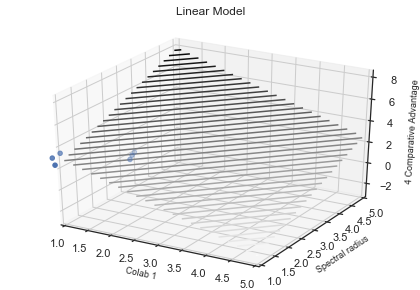




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Colab 1, Modularidad
Predicted: 3.02 E-Funding
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8581297784367566, p-value: [[0.00169559 0.01240014]]
Regression Coefficients: [-1.83008924  1.01737928]
Intercept: 2.7009573431135063


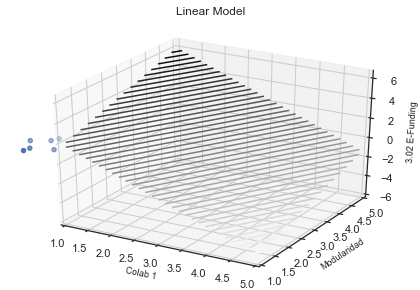




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Colab 1, Modularidad
Predicted: 4 Comparative Advantage
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.9418888781575294, p-value: [[0.00257361 0.00137346]]
Regression Coefficients: [-0.95937285  1.09196195]
Intercept: 2.6805364170504697


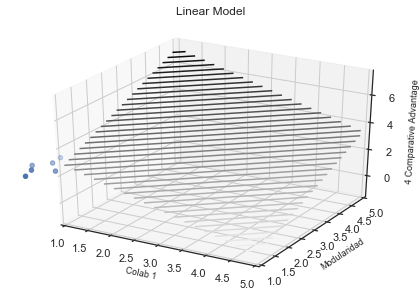




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Colab 1, Colab 0
Predicted: 2.05 I-Culture & Incentives
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8293672630054317, p-value: [[0.00899994 0.01839468]]
Regression Coefficients: [ 0.27390926 -0.15959563]
Intercept: 2.035435487924797


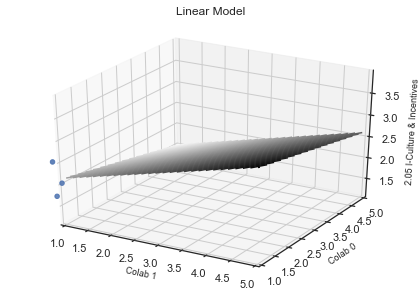




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Colab 1, Colab 3
Predicted: 2.02 I-Funding
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.893223831843053, p-value: [[0.0325105 0.0063187]]
Regression Coefficients: [ 0.92688614 -1.37399373]
Intercept: 1.9821326073382557


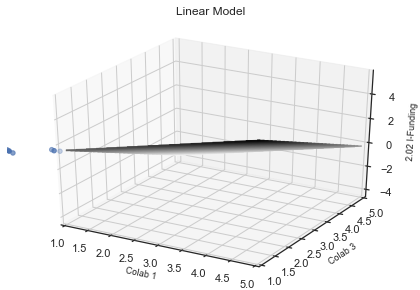




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Colab 1, Colab 4
Predicted: 2.02 I-Funding
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.922978155951123, p-value: [[0.01503103 0.00319827]]
Regression Coefficients: [ 0.99435922 -1.3917364 ]
Intercept: 1.9415416135560504


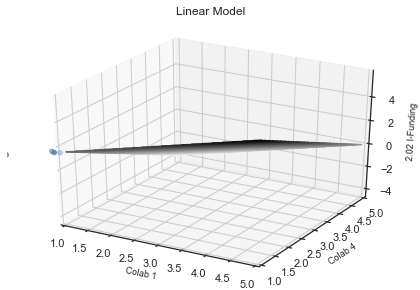




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Colab 1, Colab 6
Predicted: 2.02 I-Funding
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8877105196720844, p-value: [[0.02915172 0.00721935]]
Regression Coefficients: [ 1.03847671 -1.43101929]
Intercept: 1.9401371961011176


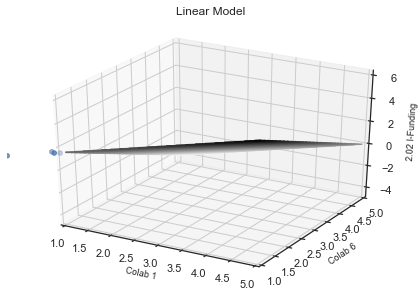




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Colab 2, avg strength
Predicted: 4 Comparative Advantage
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.9031337904636212, p-value: [[0.00392361 0.00440581]]
Regression Coefficients: [-0.68952112  0.6997134 ]
Intercept: 2.7697836312801494


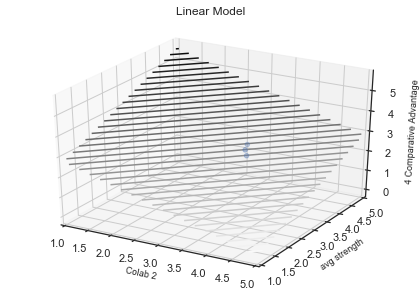




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Colab 2, weight
Predicted: 2.02 I-Funding
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8653039645110322, p-value: [[0.00683917 0.01556093]]
Regression Coefficients: [ 0.56872386 -0.32130738]
Intercept: 1.5535500778864737


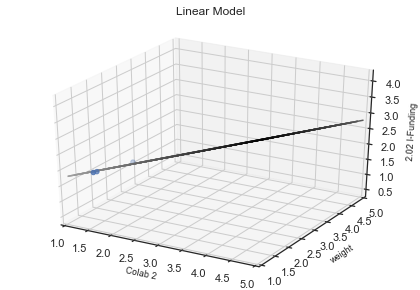




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Colab 2, Degree
Predicted: 2.05 I-Culture & Incentives
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8511517994182817, p-value: [[0.00805957 0.01089874]]
Regression Coefficients: [ 0.81205449 -0.51447321]
Intercept: 2.1775412518931176


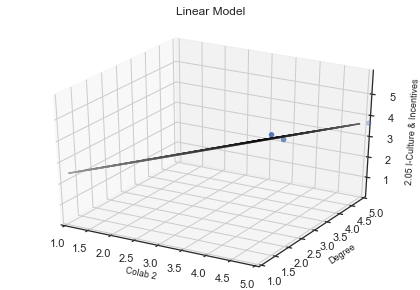




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Colab 2, Weighted Degree
Predicted: 2.05 I-Culture & Incentives
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8808335091139097, p-value: [[0.00480776 0.00721114]]
Regression Coefficients: [ 0.23791535 -0.15318245]
Intercept: 2.110398082487987


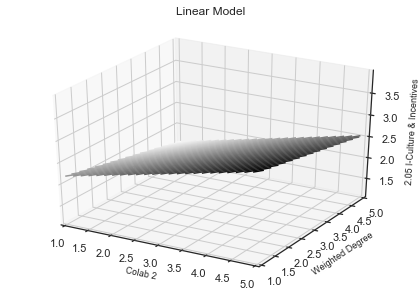




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Colab 2, Diámetro
Predicted: 2.05 I-Culture & Incentives
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8019029822648824, p-value: [[0.02588676 0.01565491]]
Regression Coefficients: [-0.50656173  0.61849868]
Intercept: 2.0156712376120804


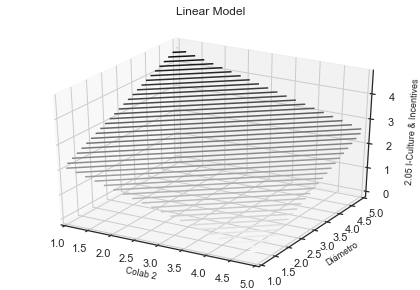




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Colab 2, Radio
Predicted: 2.05 I-Culture & Incentives
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8125467077895124, p-value: [[0.02330461 0.01194314]]
Regression Coefficients: [-0.64998871  0.9612058 ]
Intercept: 1.9790619821570956


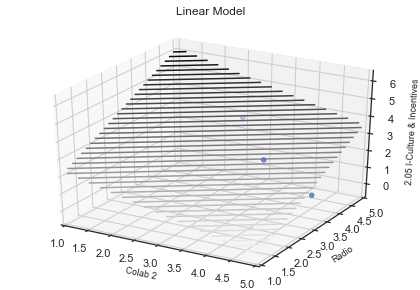




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Colab 2, Camino más corto promedio
Predicted: 2.01 I-Human Capital
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.854742680598468, p-value: [[0.00954928 0.00753459]]
Regression Coefficients: [-0.54961383  0.58541481]
Intercept: 2.213172006609738


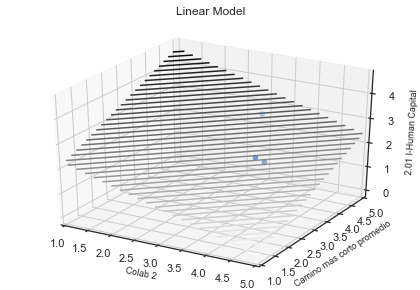




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Colab 2, Rich Club Coefficient
Predicted: 3.05 E-Culture & Incentives
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8812551007900842, p-value: [[0.0102667  0.00521336]]
Regression Coefficients: [-0.5320464   0.66019694]
Intercept: 3.031524339118258


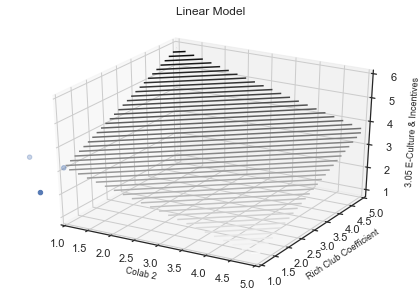




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Colab 2, Spectral radius
Predicted: 4 Comparative Advantage
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.904698221123926, p-value: [[0.00358687 0.00423581]]
Regression Coefficients: [-0.74591965  0.71598646]
Intercept: 2.765733865290448


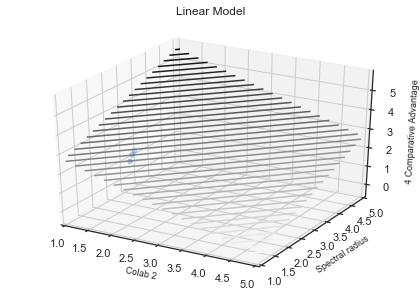




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Colab 2, Modularidad
Predicted: 4 Comparative Advantage
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.952325775440031, p-value: [[0.00098861 0.00121177]]
Regression Coefficients: [-0.74484413  0.68859794]
Intercept: 2.767455974151481


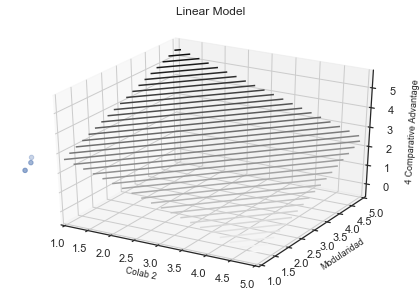




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Colab 2, Colab 0
Predicted: 2.05 I-Culture & Incentives
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.827476784547333, p-value: [[0.01053089 0.01792222]]
Regression Coefficients: [ 0.26348143 -0.16151704]
Intercept: 2.1465590498942904


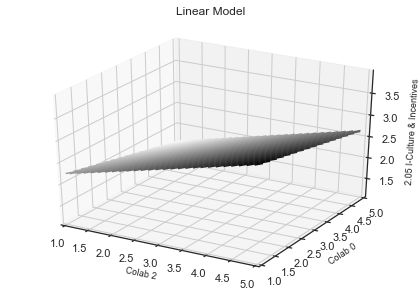




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Colab 2, Colab 1
Predicted: 2.02 I-Funding
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8557374482132235, p-value: [[0.00840416 0.01466885]]
Regression Coefficients: [ 0.87759961 -0.65912461]
Intercept: 1.6116896762066972


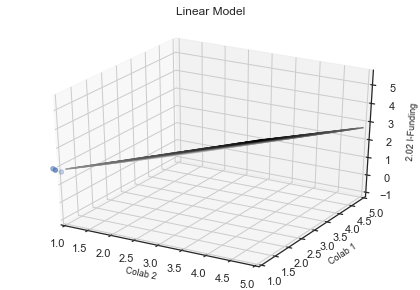




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Colab 3, avg strength
Predicted: 3.02 E-Funding
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8738836927855077, p-value: [[0.00541149 0.00472386]]
Regression Coefficients: [-1.65141543  1.79831534]
Intercept: 1.9350929714568967


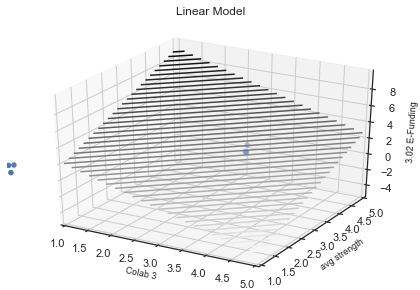




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Colab 3, avg strength
Predicted: 4 Comparative Advantage
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8247352116000609, p-value: [[0.01435839 0.01530139]]
Regression Coefficients: [-1.34773863  1.38697535]
Intercept: 2.786168330389108


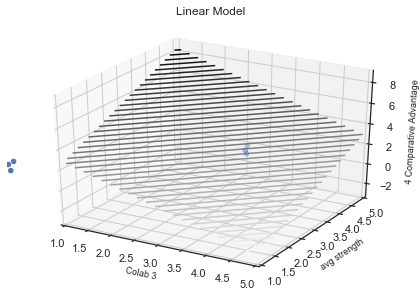




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Colab 3, weight
Predicted: 2.05 I-Culture & Incentives
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8093531219095179, p-value: [[0.00988586 0.01910859]]
Regression Coefficients: [ 2.26209202 -1.35343047]
Intercept: 1.896552523863918


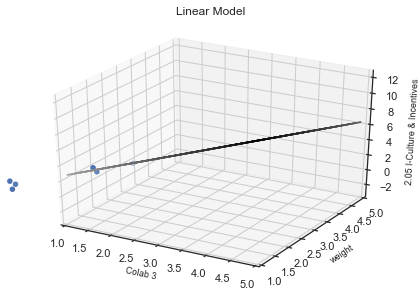




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Colab 3, Degree
Predicted: 2.05 I-Culture & Incentives
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8963633611135551, p-value: [[0.00323204 0.0052977 ]]
Regression Coefficients: [ 0.88670473 -0.53625014]
Intercept: 2.0116550173545606


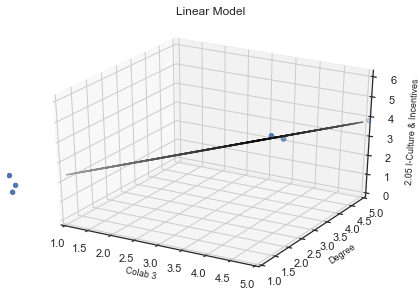




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Colab 3, Weighted Degree
Predicted: 2.05 I-Culture & Incentives
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8889093350066342, p-value: [[0.00397421 0.00628323]]
Regression Coefficients: [ 0.24236392 -0.15397172]
Intercept: 2.0662306896771563


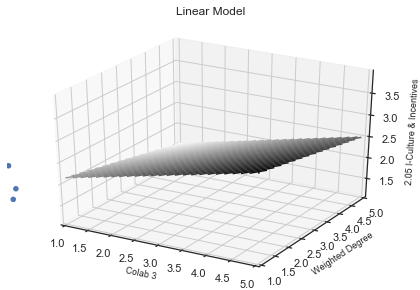




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Colab 3, Excentricidad
Predicted: 2.05 I-Culture & Incentives
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8119926930601322, p-value: [[0.02671716 0.01513946]]
Regression Coefficients: [-0.60466137  0.74227427]
Intercept: 2.015376932777136


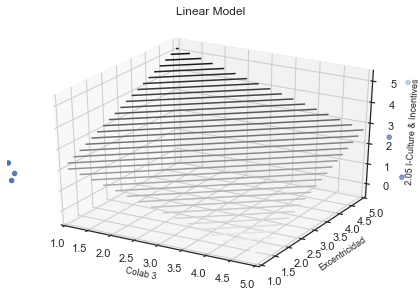




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Colab 3, Diámetro
Predicted: 2.05 I-Culture & Incentives
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8123633635750913, p-value: [[0.02298215 0.01422558]]
Regression Coefficients: [-0.52198802  0.63188861]
Intercept: 2.03598218296762


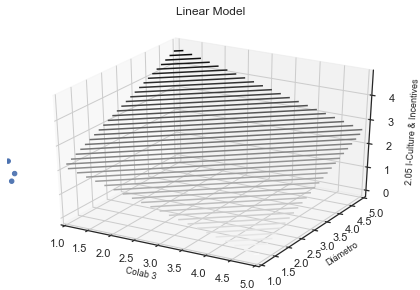




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Colab 3, Radio
Predicted: 2.05 I-Culture & Incentives
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8503282095642435, p-value: [[0.01481083 0.00740942]]
Regression Coefficients: [-0.69252825  1.02328777]
Intercept: 1.950726716336799


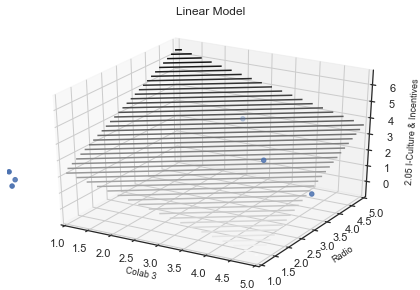




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Colab 3, Transitividad
Predicted: 2.02 I-Funding
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.9370023194564902, p-value: [[0.04994554 0.00144232]]
Regression Coefficients: [ 1.06015244 -2.38927531]
Intercept: 2.0215823108931805


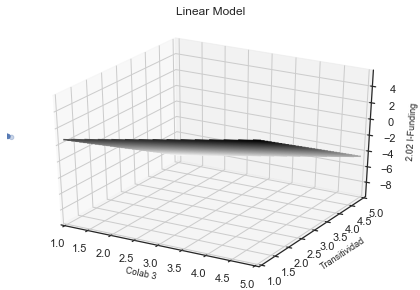




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Colab 3, Eficiencia Global
Predicted: 2.02 I-Funding
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8667916021833731, p-value: [[0.04622168 0.00119567]]
Regression Coefficients: [-1.52414277 -3.92285664]
Intercept: 3.4239965628111007


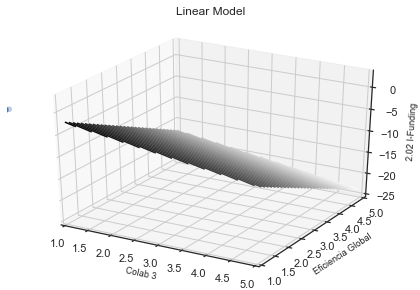




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Colab 3, Eficiencia Global
Predicted: 3.01 E-Human Capital
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8373513974440883, p-value: [[0.00157981 0.00122343]]
Regression Coefficients: [7.44239497 7.11579524]
Intercept: -1.4203941999746417


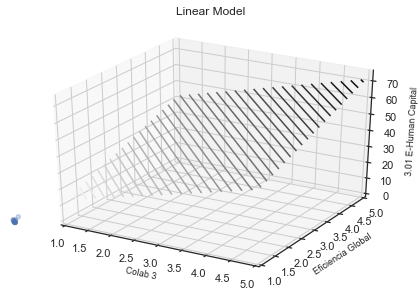




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Colab 3, Spectral radius
Predicted: 2.04 I-Demand
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8026748676133519, p-value: [[0.01411792 0.01369286]]
Regression Coefficients: [-1.57974647  1.60877249]
Intercept: 2.8336412297277556


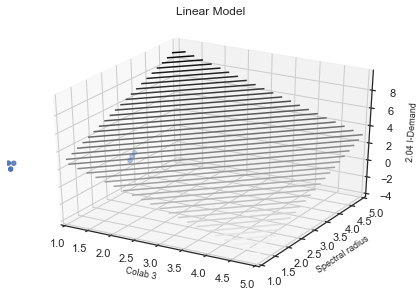




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Colab 3, Spectral radius
Predicted: 3.02 E-Funding
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8368297605832272, p-value: [[0.01009166 0.00805682]]
Regression Coefficients: [-1.90313051  2.0485161 ]
Intercept: 1.9231032134460513


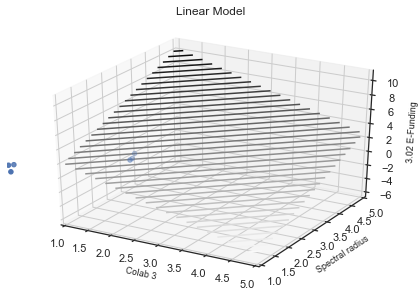




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Colab 3, Spectral radius
Predicted: 4 Comparative Advantage
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.9479811656490377, p-value: [[0.00113537 0.00123586]]
Regression Coefficients: [-1.78419611  1.76099527]
Intercept: 2.784538633222033


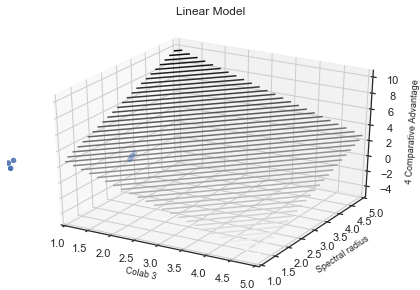




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Colab 3, Modularidad
Predicted: 2.04 I-Demand
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8427317628819212, p-value: [[0.01300438 0.00813692]]
Regression Coefficients: [-1.07244531  1.25263942]
Intercept: 2.812192190575174


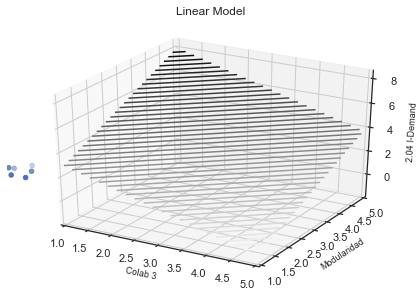




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Colab 3, Modularidad
Predicted: 4 Comparative Advantage
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8353568915487971, p-value: [[0.00958023 0.01443197]]
Regression Coefficients: [-1.31841371  1.19292405]
Intercept: 2.843129809080259


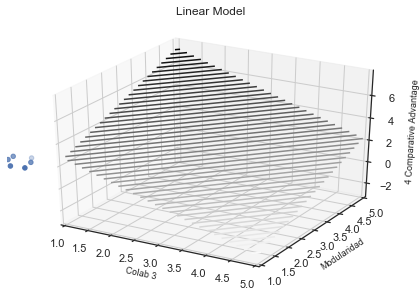




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Colab 3, Colab 0
Predicted: 2.05 I-Culture & Incentives
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8337992834568826, p-value: [[0.00921315 0.01700777]]
Regression Coefficients: [ 0.26917882 -0.16138277]
Intercept: 2.0970986433769045


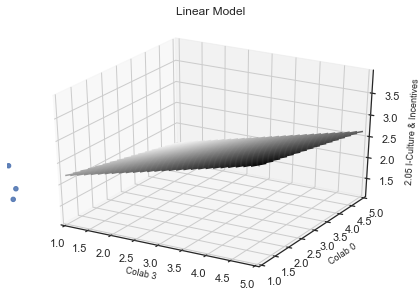




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Colab 3, Colab 4
Predicted: 2.02 I-Funding
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.9788082457646938, p-value: [[4.95485807e-02 8.43578034e-05]]
Regression Coefficients: [-0.53375108 -2.48337189]
Intercept: 2.547351286274278


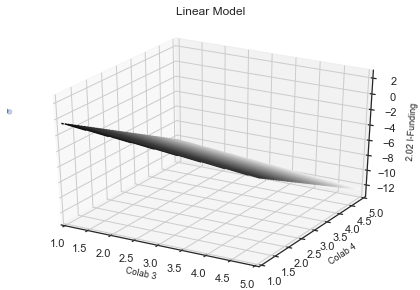




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Colab 3, Colab 5
Predicted: 2.02 I-Funding
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8191870411929453, p-value: [[0.01630113 0.0221089 ]]
Regression Coefficients: [ 2.15450885 -1.91448116]
Intercept: 1.5389482168355526


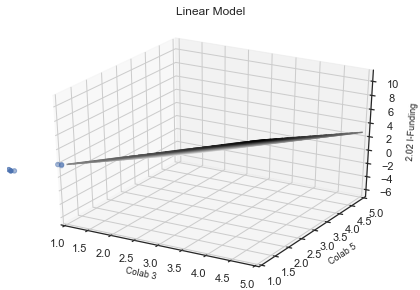




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Colab 3, Colab 6
Predicted: 2.02 I-Funding
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.9983940816758488, p-value: [[1.16985513e-04 3.69318164e-07]]
Regression Coefficients: [-0.85932687 -2.99452822]
Intercept: 2.829328626207691


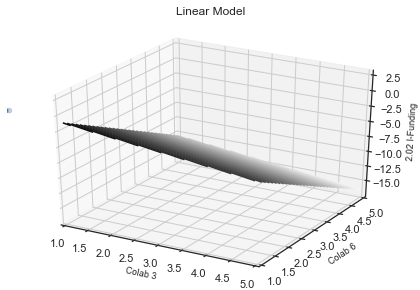




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Colab 4, avg strength
Predicted: 3.02 E-Funding
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8052686018154402, p-value: [[0.01294999 0.01135504]]
Regression Coefficients: [-1.5811099   1.72393934]
Intercept: 1.9364775840477755


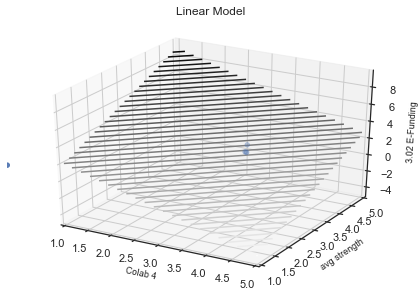




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Colab 4, avg strength
Predicted: 4 Comparative Advantage
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8286747879047534, p-value: [[0.01315091 0.01391248]]
Regression Coefficients: [-1.3514561   1.39448817]
Intercept: 2.7742320141308645


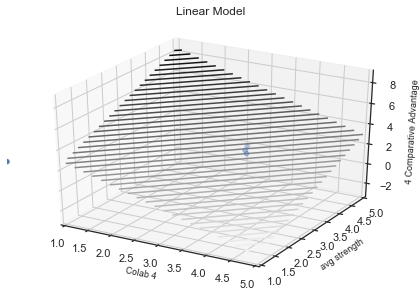




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Colab 4, weight
Predicted: 2.05 I-Culture & Incentives
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8282901449963698, p-value: [[0.00914275 0.01534358]]
Regression Coefficients: [ 2.21240348 -1.37537199]
Intercept: 2.011699840852061


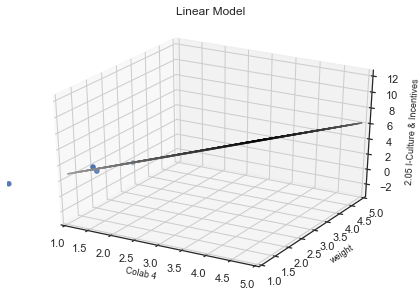




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Colab 4, Degree
Predicted: 2.05 I-Culture & Incentives
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.9026013058042686, p-value: [[0.00298986 0.00467281]]
Regression Coefficients: [ 0.87914383 -0.53848848]
Intercept: 2.053068191587772


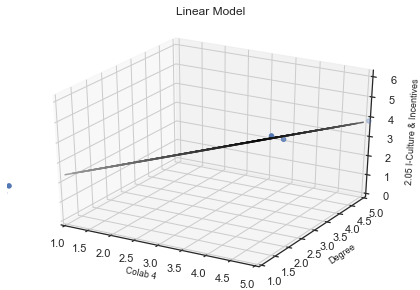




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Colab 4, Weighted Degree
Predicted: 2.05 I-Culture & Incentives
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.890484723625289, p-value: [[0.00390434 0.00609981]]
Regression Coefficients: [ 0.24182977 -0.15415095]
Intercept: 2.0765678150463436


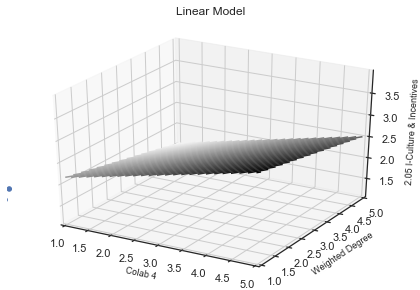




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Colab 4, Excentricidad
Predicted: 2.05 I-Culture & Incentives
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8066879120220646, p-value: [[0.02816204 0.01607241]]
Regression Coefficients: [-0.60274214  0.73918297]
Intercept: 2.0214002967032387


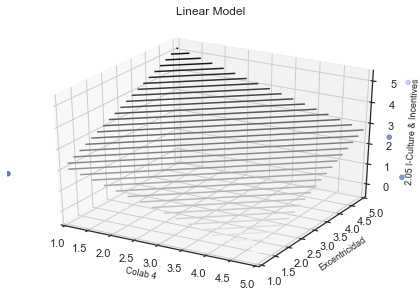




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Colab 4, Diámetro
Predicted: 2.05 I-Culture & Incentives
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8078692365892449, p-value: [[0.02407548 0.01497322]]
Regression Coefficients: [-0.52047702  0.62967363]
Intercept: 2.040341158608548


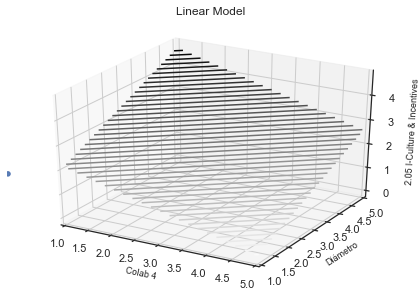




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Colab 4, Radio
Predicted: 2.05 I-Culture & Incentives
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8437926203934444, p-value: [[0.01599076 0.00825272]]
Regression Coefficients: [-0.69149165  1.01482782]
Intercept: 1.9747927002643253


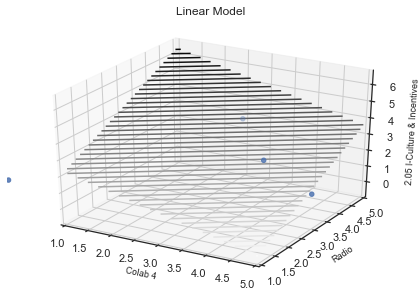




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Colab 4, Small Worldness
Predicted: 3.05 E-Culture & Incentives
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.856869090233765, p-value: [[0.00811099 0.00918273]]
Regression Coefficients: [-2.06843844  1.60469976]
Intercept: 3.1144693556346352


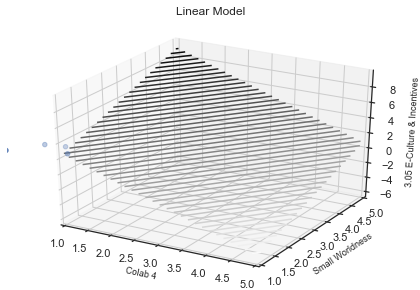




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Colab 4, Rich Club Coefficient
Predicted: 3.05 E-Culture & Incentives
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.817274413831452, p-value: [[0.02005537 0.0129971 ]]
Regression Coefficients: [-0.6144871   0.73632072]
Intercept: 3.0488527619728694


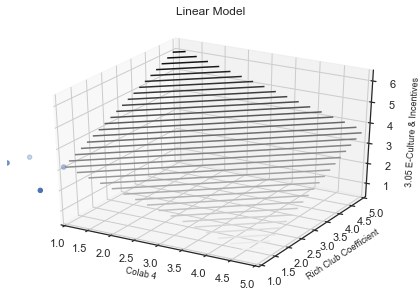




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Colab 4, Core Ratio
Predicted: 2.02 I-Funding
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8150579649837217, p-value: [[0.01180672 0.02453661]]
Regression Coefficients: [ 3.02107185 -2.01901379]
Intercept: 1.4440156889662752


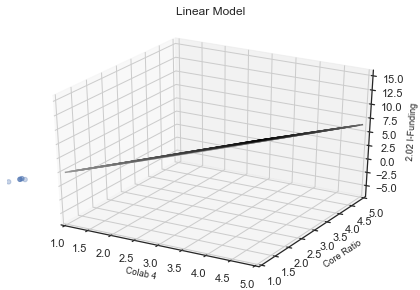




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Colab 4, Spectral radius
Predicted: 4 Comparative Advantage
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.9549057582018273, p-value: [[0.00079001 0.00083859]]
Regression Coefficients: [-1.7886548   1.77814354]
Intercept: 2.760427921437225


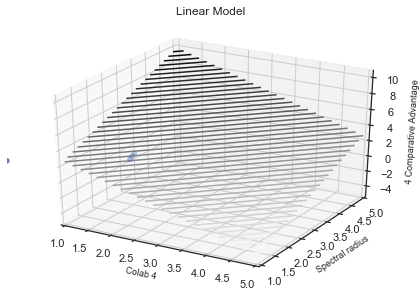




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Colab 4, Modularidad
Predicted: 4 Comparative Advantage
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8399202155968729, p-value: [[0.00991478 0.0127379 ]]
Regression Coefficients: [-1.27259144  1.21397519]
Intercept: 2.804144310052751


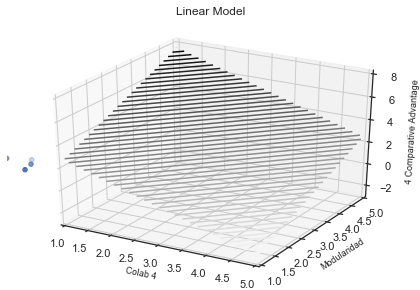




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Colab 4, Colab 0
Predicted: 2.05 I-Culture & Incentives
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8361735029658841, p-value: [[0.00907237 0.01643613]]
Regression Coefficients: [ 0.26847754 -0.16188785]
Intercept: 2.109063367145419


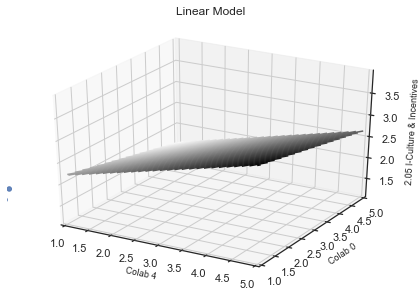




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Colab 4, Colab 1
Predicted: 2.02 I-Funding
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.805472832831555, p-value: [[0.01726722 0.03117962]]
Regression Coefficients: [ 1.51573563 -1.13889062]
Intercept: 1.5061049272188503


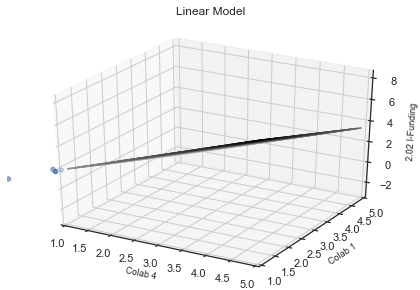




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Colab 4, Colab 5
Predicted: 2.02 I-Funding
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8856248799606184, p-value: [[0.00588355 0.00722341]]
Regression Coefficients: [ 2.23680049 -2.05969008]
Intercept: 1.6025148585919857


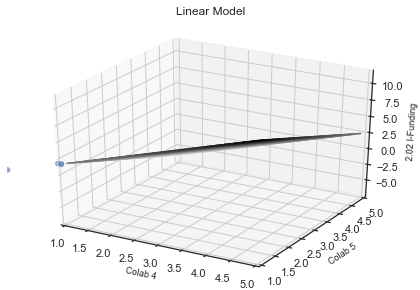




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Colab 4, Colab 6
Predicted: 5 Impact
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8494726075828046, p-value: [[0.00253267 0.00286871]]
Regression Coefficients: [2.94623704 2.17580152]
Intercept: 2.6310146885191203


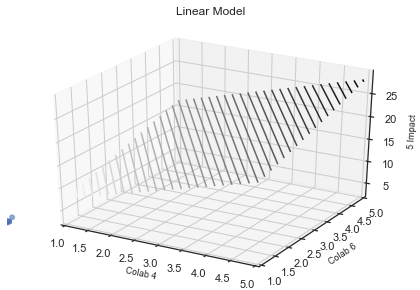




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Colab 5, avg strength
Predicted: 2.01 I-Human Capital
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.827743819487444, p-value: [[0.01053425 0.0094566 ]]
Regression Coefficients: [-3.11760973  3.36668296]
Intercept: 2.0394209307296047


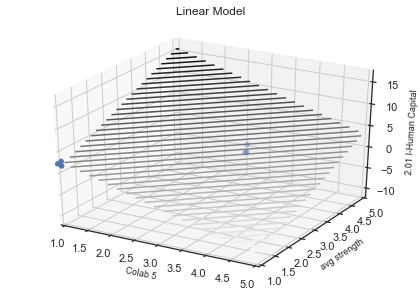




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Colab 5, weight
Predicted: 2.05 I-Culture & Incentives
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8278951418295077, p-value: [[0.00098444 0.01577484]]
Regression Coefficients: [ 3.59400247 -1.3120855 ]
Intercept: -0.06080103928420444


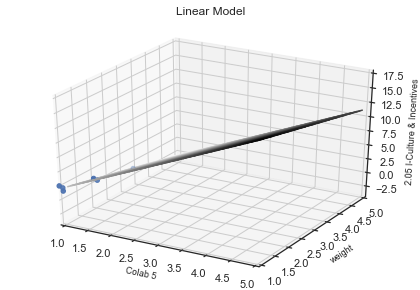




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Colab 5, Degree
Predicted: 2.05 I-Culture & Incentives
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.907711006689818, p-value: [[0.00161946 0.00404095]]
Regression Coefficients: [ 0.97982802 -0.53849442]
Intercept: 1.6700929888465506


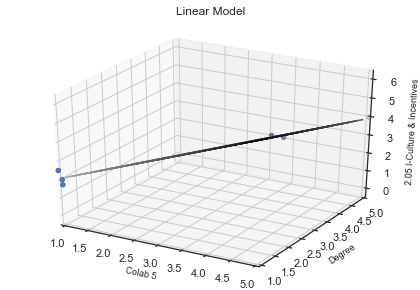




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Colab 5, Weighted Degree
Predicted: 2.05 I-Culture & Incentives
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.892034945100617, p-value: [[0.00345174 0.00594713]]
Regression Coefficients: [ 0.24780381 -0.15402376]
Intercept: 1.9957070409546218


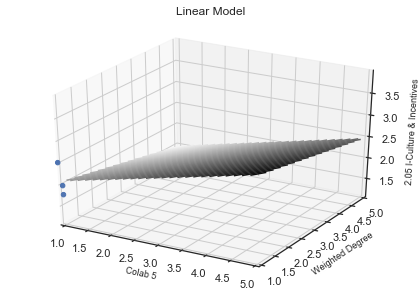




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Colab 5, Weighted Degree
Predicted: 3.04 E-Demand
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8001510712268493, p-value: [[0.02875014 0.01685546]]
Regression Coefficients: [ 0.05374539 -0.04580571]
Intercept: 3.265206524614783


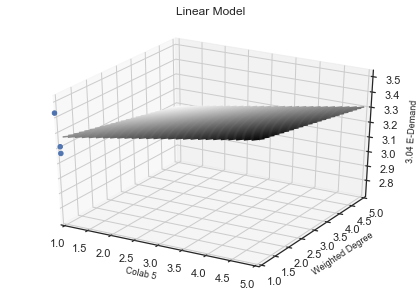




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Colab 5, Excentricidad
Predicted: 2.05 I-Culture & Incentives
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8038991705096833, p-value: [[0.03028551 0.01628048]]
Regression Coefficients: [-0.59466166  0.74337548]
Intercept: 1.9524677339408065


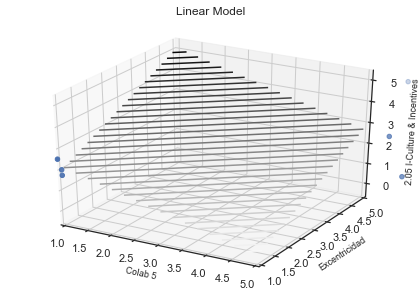




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Colab 5, Clustering
Predicted: 2.02 I-Funding
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8011506937348196, p-value: [[0.02929724 0.01184911]]
Regression Coefficients: [ 2.3282825  -2.99723262]
Intercept: 2.147817559260327


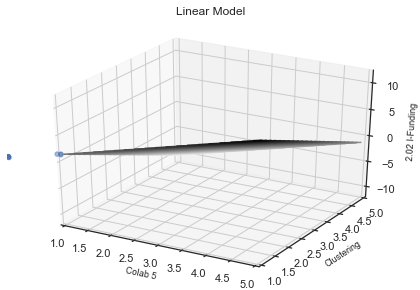




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Colab 5, Diámetro
Predicted: 2.05 I-Culture & Incentives
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.804773205943812, p-value: [[0.02539997 0.01518211]]
Regression Coefficients: [-0.51688281  0.63301231]
Intercept: 1.990964846113862


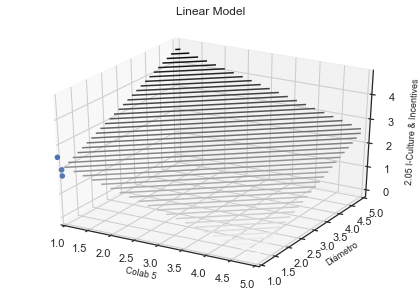




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Colab 5, Radio
Predicted: 2.05 I-Culture & Incentives
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8363548702150746, p-value: [[0.01933333 0.00747088]]
Regression Coefficients: [-0.66822831  1.05760559]
Intercept: 1.7340462949113256


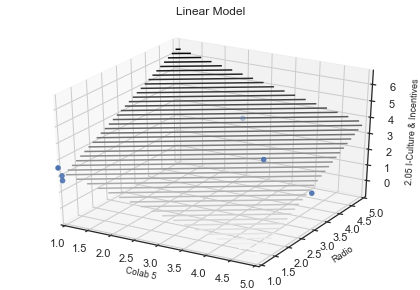




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Colab 5, Transitividad
Predicted: 2.02 I-Funding
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.949600844846864, p-value: [[0.00185061 0.00089826]]
Regression Coefficients: [ 2.56504423 -3.05629929]
Intercept: 1.9854014519882501


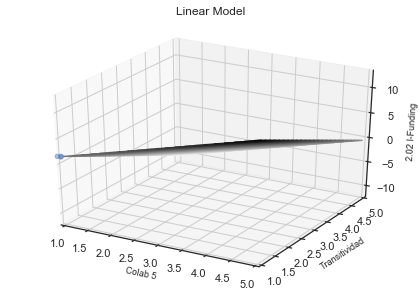




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Colab 5, Eficiencia Global
Predicted: 2.02 I-Funding
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8714581233401913, p-value: [[0.01854827 0.01071457]]
Regression Coefficients: [ 2.62937959 -3.06660376]
Intercept: 1.9328300665705742


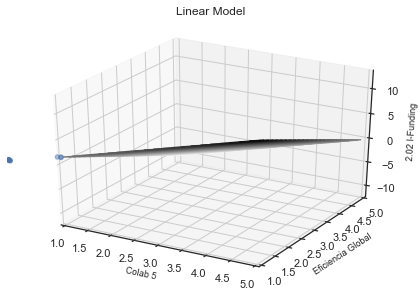




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Colab 5, Rich Club Coefficient
Predicted: 2.05 I-Culture & Incentives
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8594848998847, p-value: [[0.04545034 0.00302143]]
Regression Coefficients: [-1.17221359 -2.70641147]
Intercept: 5.6118672428925525


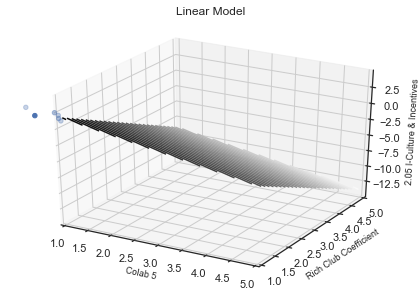




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Colab 5, Core Ratio
Predicted: 2.02 I-Funding
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.9312149888506979, p-value: [[0.00535248 0.00152307]]
Regression Coefficients: [ 2.45288616 -3.33305368]
Intercept: 2.3578009244119906


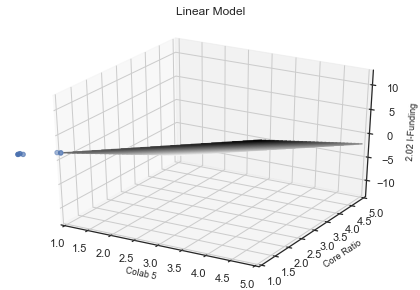




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Colab 5, Central Point Dominance
Predicted: 3.05 E-Culture & Incentives
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8330856592399833, p-value: [[0.00775558 0.01103909]]
Regression Coefficients: [-2.27190691  2.11034034]
Intercept: 3.28113537756147


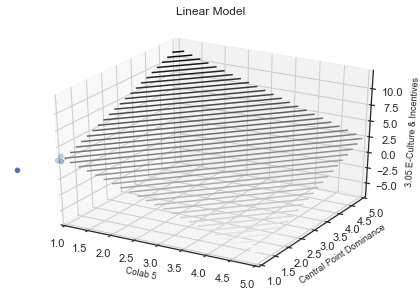




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Colab 5, Spectral radius
Predicted: 4 Comparative Advantage
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8738438518971207, p-value: [[0.00796859 0.01016833]]
Regression Coefficients: [-2.15159423  2.02822832]
Intercept: 2.98143298242702


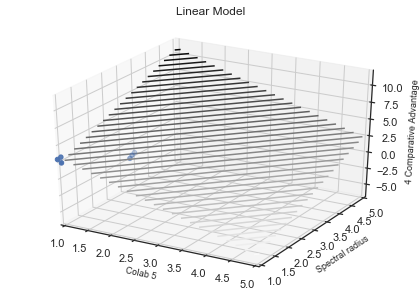




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Colab 5, Modularidad
Predicted: 2.05 I-Culture & Incentives
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8099971640516226, p-value: [[0.00544365 0.02133017]]
Regression Coefficients: [-7.3239551   5.01308126]
Intercept: 4.283499128992392


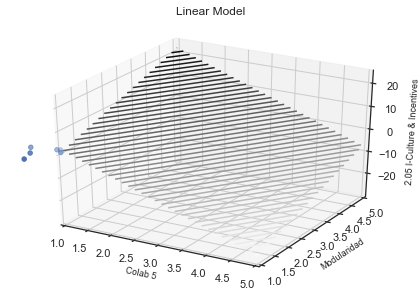




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Colab 5, Colab 0
Predicted: 2.05 I-Culture & Incentives
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8326569004348945, p-value: [[0.00839797 0.01784994]]
Regression Coefficients: [ 0.27642523 -0.15951334]
Intercept: 2.013655305176755


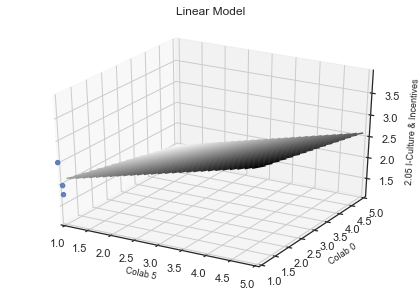




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Colab 5, Colab 1
Predicted: 2.05 I-Culture & Incentives
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8990403784222082, p-value: [[0.01355133 0.00083125]]
Regression Coefficients: [-4.08155083 -8.37524537]
Intercept: 14.071189302455869


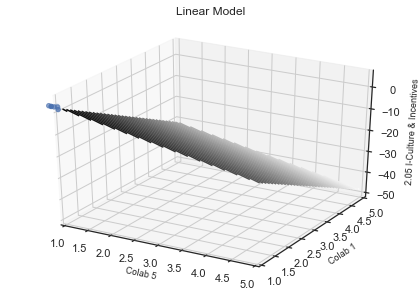




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Colab 5, Colab 2
Predicted: 2.05 I-Culture & Incentives
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8490809094441589, p-value: [[0.02913469 0.00654488]]
Regression Coefficients: [ 2.12179621 -3.16426927]
Intercept: 3.079753993683037


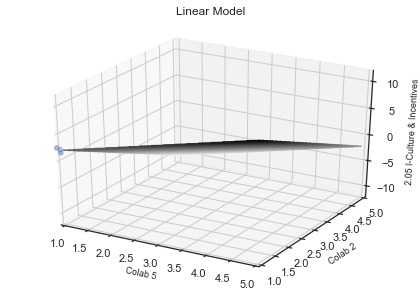




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Colab 5, Colab 3
Predicted: 2.02 I-Funding
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8153028426389647, p-value: [[0.04849217 0.01670464]]
Regression Coefficients: [ 1.53263062 -2.10829798]
Intercept: 2.0580119415175764


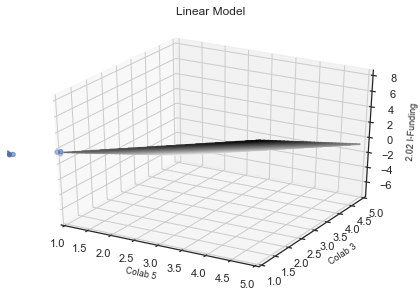




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Colab 5, Colab 4
Predicted: 2.02 I-Funding
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8589693918558293, p-value: [[0.02452315 0.00884743]]
Regression Coefficients: [ 1.63251039 -2.15916801]
Intercept: 2.0139667526808576


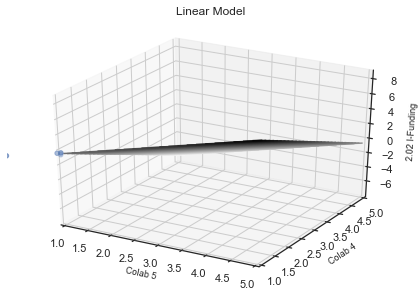




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Colab 5, Colab 6
Predicted: 2.02 I-Funding
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8827927793534366, p-value: [[0.01470095 0.00593929]]
Regression Coefficients: [ 2.04477702 -2.59560734]
Intercept: 2.0385126245910192


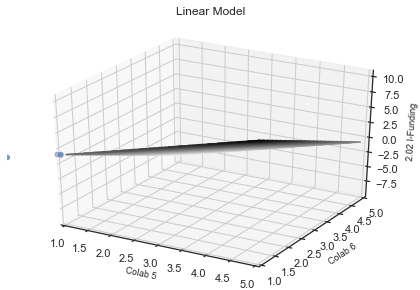




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Colab 6, avg strength
Predicted: 2.01 I-Human Capital
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8115394827306531, p-value: [[0.01151296 0.01047184]]
Regression Coefficients: [-2.91383784  3.14306233]
Intercept: 2.070028561083211


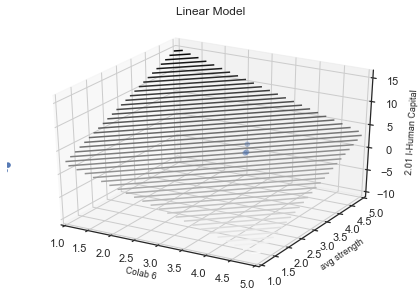




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Colab 6, weight
Predicted: 2.05 I-Culture & Incentives
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8391698481763129, p-value: [[0.00757413 0.013468  ]]
Regression Coefficients: [ 2.26531675 -1.39046825]
Intercept: 1.9661949326888286


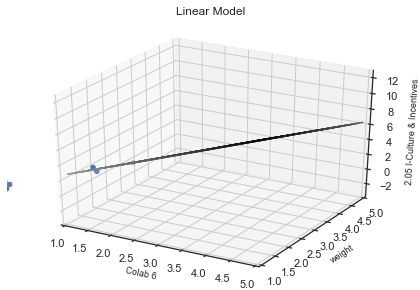




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Colab 6, Degree
Predicted: 2.05 I-Culture & Incentives
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.9051357281129483, p-value: [[0.00278218 0.00443191]]
Regression Coefficients: [ 0.88488989 -0.53954907]
Intercept: 2.0370847607744365


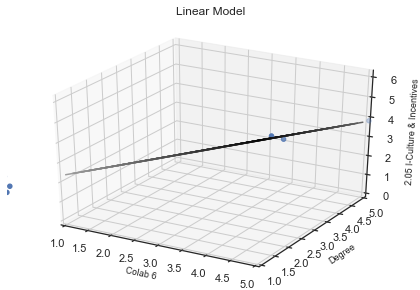




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Colab 6, Weighted Degree
Predicted: 2.05 I-Culture & Incentives
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8909686162066126, p-value: [[0.00385206 0.00604773]]
Regression Coefficients: [ 0.24219171 -0.15418713]
Intercept: 2.072502362189062


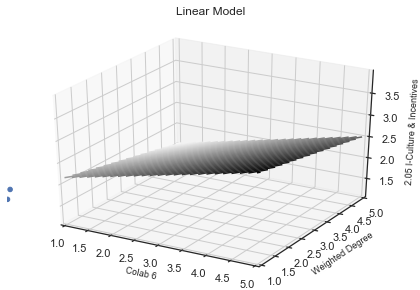




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Colab 6, Excentricidad
Predicted: 2.05 I-Culture & Incentives
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8076271085166846, p-value: [[0.0278407  0.01594158]]
Regression Coefficients: [-0.60434611  0.74030495]
Intercept: 2.0245760627767115


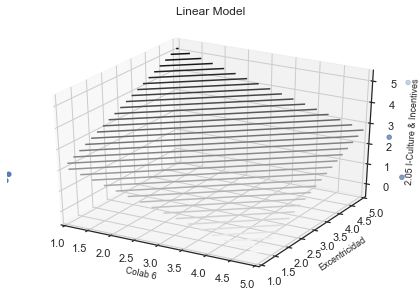




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Colab 6, Clustering
Predicted: 2.03 I-Infrastructure
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8118101789412172, p-value: [[0.00729402 0.0200622 ]]
Regression Coefficients: [4.19036525 2.48215313]
Intercept: 1.7552443466238135


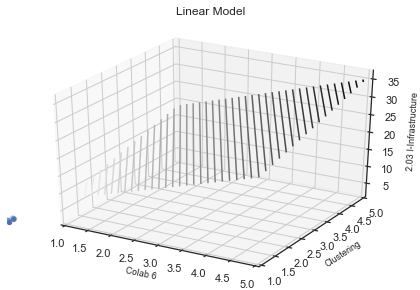




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Colab 6, Clustering
Predicted: 5 Impact
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8165354480794723, p-value: [[0.03412442 0.00495977]]
Regression Coefficients: [1.8637015  2.63603279]
Intercept: 2.6271173884667895


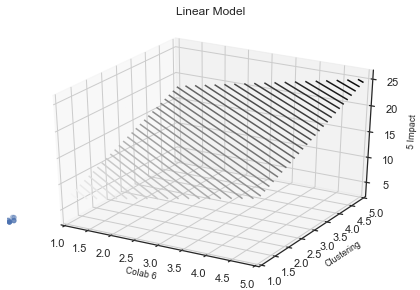




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Colab 6, Diámetro
Predicted: 2.05 I-Culture & Incentives
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8084658977885109, p-value: [[0.02389915 0.01490408]]
Regression Coefficients: [-0.52138716  0.63022087]
Intercept: 2.0432474567041563


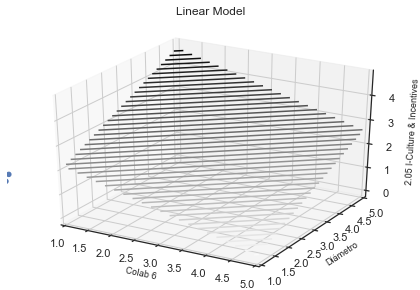




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Colab 6, Radio
Predicted: 2.05 I-Culture & Incentives
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8460653726179432, p-value: [[0.01553045 0.0080144 ]]
Regression Coefficients: [-0.69390709  1.01801125]
Intercept: 1.9745519250124919


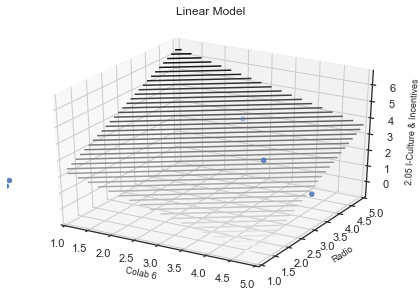




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Colab 6, Transitividad
Predicted: 2.02 I-Funding
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.9792520855607787, p-value: [[0.02026019 0.0001459 ]]
Regression Coefficients: [ 1.03021582 -2.91325922]
Intercept: 2.0909673742920307


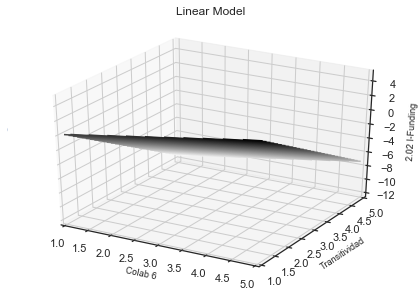




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Colab 6, Small Worldness
Predicted: 3.05 E-Culture & Incentives
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8339305404426587, p-value: [[0.01104378 0.01343132]]
Regression Coefficients: [-2.14285808  1.63393   ]
Intercept: 3.149282560211897


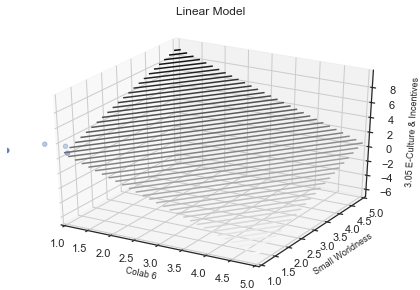




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Colab 6, Core Ratio
Predicted: 2.02 I-Funding
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.808844216995348, p-value: [[0.01230146 0.02817771]]
Regression Coefficients: [ 3.64306736 -2.39543676]
Intercept: 1.361472831925973


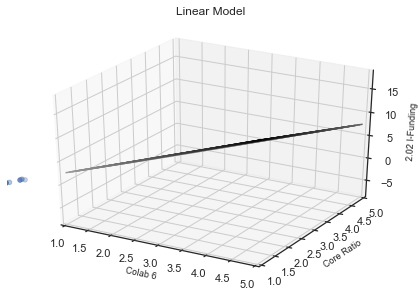




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Colab 6, Spectral radius
Predicted: 4 Comparative Advantage
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.9174856189292503, p-value: [[0.00276794 0.00293971]]
Regression Coefficients: [-1.97327257  1.96173373]
Intercept: 2.7679335220144354


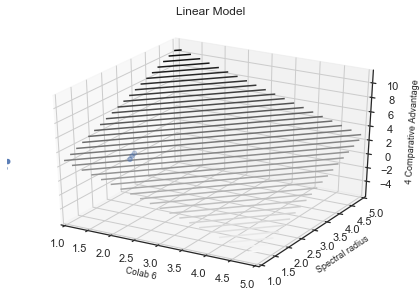




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Colab 6, Modularidad
Predicted: 2.04 I-Demand
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8041615127804035, p-value: [[0.01883704 0.01293841]]
Regression Coefficients: [-1.12672455  1.30228832]
Intercept: 2.8202349017557715


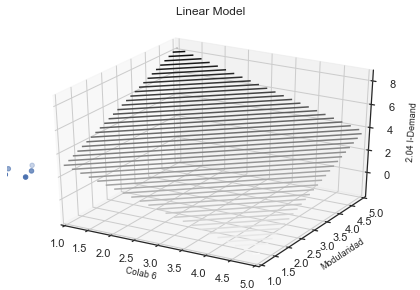




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Colab 6, Colab 0
Predicted: 2.05 I-Culture & Incentives
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8364750415474568, p-value: [[0.00898921 0.01641169]]
Regression Coefficients: [ 0.26894356 -0.16182424]
Intercept: 2.104478216020061


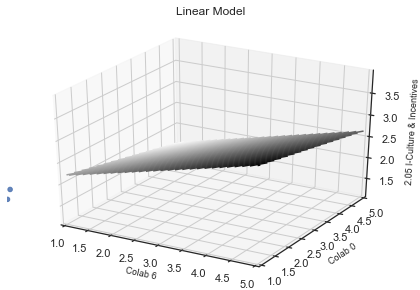




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Colab 6, Colab 4
Predicted: 2.02 I-Funding
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8386766299834914, p-value: [[0.02648355 0.00305077]]
Regression Coefficients: [-2.1270484  -3.03164122]
Intercept: 2.9413660317087627


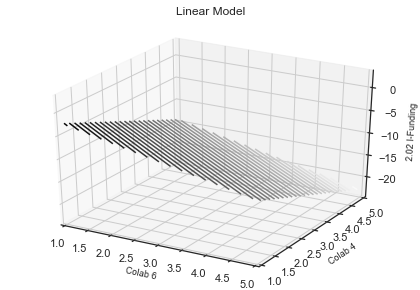




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Colab 6, Colab 5
Predicted: 2.02 I-Funding
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.875658347123188, p-value: [[0.00717819 0.00863246]]
Regression Coefficients: [ 2.59150217 -2.40591938]
Intercept: 1.5956947937160177


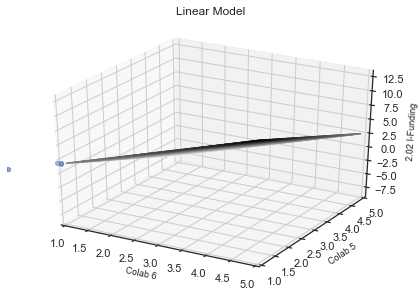

In [138]:
'''
3D linear models for predicting iEcosystem metrics using graph metrics
'''
# list of all global metrics
grf_key_list=list(grf_df.keys())                     

#iEco metrics predictors/to be predicted
ieco_key_list=list(df_means.keys())                           

for key1 in grf_key_list:
    for key2 in grf_key_list:                                 # for each pair (a,b) of distinct global metrics
        if key1 != key2:                                      
            for predict in ieco_key_list:               # and each predictor
                
                # we make a numpy array with the predicted values and reshape it into 2 rows, 6 columns
                X = np.concatenate([ieco_grf_df[key1].to_numpy(),ieco_grf_df[key2].to_numpy()],axis=0)
                X = X.reshape(6,2)
                
                # make a numpy array for our predictor
                y=ieco_grf_df[predict].to_numpy()
                
                #make linear regression with X,y data and obtain p-value
                reg=LinearRegression().fit(X,y)
                p=lin_reg_p_val(reg,X,y)
                
                #if p-value is small enough and the regression score is greater than 0.8:
                if p[0][0]<.05 and p[0][1]<.05 and reg.score(X,y)>.8:
                    print('- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -')
                    print('Predictor metrics: '+key1+', '+key2)
                    print('Predicted: '+predict)
                    print('- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -')
                    print('Regression Score: ' + str(reg.score(X,y)) + ', p-value: ' + str(p) )
                    print('Regression Coefficients: ' + str(reg.coef_) )
                    print('Intercept: ' + str(reg.intercept_))
                    plot_linear_model(reg,X,y,key1,key2,predict)
                    print('')
                    print('')
                    print('')
                

In [139]:
ranking_df

,Ciudad,País,Colab 0,Colab 1,Colab 2,Colab 3,Colab 4,Colab 5,Colab 6,Ranking Capitals 0,Ranking Capitals 1,Ranking Capitals 2,Ranking Capitals 3,Ranking Capitals 4,Ranking Capitals 5,Ranking Capitals 6
0,CABA,Argentina,10.658128,0.921857,0.114574,0.355051,0.252040,0.937550,0.277219,2.0,3.0,2.0,3.0,2.0,3.0,2.0
1,CDMX,México,6.936892,0.817118,-0.105809,0.252593,0.165183,0.917916,0.197206,5.0,5.0,5.0,6.0,6.0,6.0,6.0
2,Santiago,Chile,10.185112,0.956748,0.103005,0.360724,0.247697,1.008863,0.271107,3.0,2.0,3.0,2.0,3.0,2.0,3.0
3,Montevideo,Uruguay,16.300534,1.124532,0.452584,0.456651,0.387565,1.019704,0.373899,1.0,1.0,1.0,1.0,1.0,1.0,1.0
4,Madrid,España,7.693053,0.853905,-0.064943,0.297935,0.201023,0.937239,0.228465,4.0,4.0,4.0,4.0,4.0,4.0,4.0
5,Sao Paulo,Brasil,5.505892,0.793642,-0.188052,0.262453,0.168783,0.923994,0.211309,6.0,6.0,6.0,5.0,5.0,5.0,5.0
6,AGS,México,6.670981,0.945291,0.202375,0.381315,0.286961,0.909916,0.319711,NaN,NaN,NaN,NaN,NaN,NaN,NaN
7,GDL,México,8.951679,0.941283,0.168336,0.372794,0.273964,0.926729,0.297655,NaN,NaN,NaN,NaN,NaN,NaN,NaN
8,Pachuca,México,7.157192,0.992121,0.144041,0.326377,0.249075,1.062621,0.278376,NaN,NaN,NaN,NaN,NaN,NaN,NaN
9,Oaxaca,México,4.769711,0.916660,0.132947,0.327350,0.252598,0.924771,0.285615,NaN,NaN,NaN,NaN,NaN,NaN,NaN
